In [3]:
import numpy as np
from astropy import units as u, constants as const
from matplotlib import pyplot as plt
from scipy.stats import beta
from scipy.special import beta as betafct
from numba import jit, jitclass
from scipy import interpolate
from scipy.interpolate import interp1d
import logging
import sys
import os
sys.path.insert(1, '/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src')
import importlib
import simulation_strategies, collapse, plotting, utils, analtyic_formulas
importlib.reload(simulation_strategies)
importlib.reload(collapse)
importlib.reload(plotting)
importlib.reload(utils)
importlib.reload(analtyic_formulas)
from simulation_strategies import *
from collapse import *
from plotting import *
from utils import *
from analtyic_formulas import *
import cProfile
import pstats

import warnings
warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)

t_i = 1
G = 1
rho_H = 1/(6*np.pi*G*t_i**2)
H0 = 2/(3*t_i)
ss = SelfSimilarSolution(t_i, G, rho_H)

def compute_r0_min(r_min, r_max, N):
    """
    Compute r0_min such that the spacing dR in np.linspace(r0_min, r_max, N)
    satisfies dR = r0_min - r_min. That is, the inner edge of the innermost shell is at r_min.
    
    Parameters:
    - r_min (float): The minimum radius.
    - r_max (float): The maximum radius.
    - N (int): Number of points.
    
    Returns:
    - float: The computed r0_min.
    """
    return (r_max + r_min * (N - 1)) / N

def make_cycloid_config(r_min=1e-2, r_max=1, N=1, t_max=5000, dt_min=1e-9, rho_bar=rho_H, delta_i=1, stepper_strategy='velocity_verlet', timescale_strategy='dyn', save_strategy='vflip', safety_factor=1e-4, reflect_bool=False, save_dt=1e-2, j_coeff=0, softlen=0, thickness_coef=0, irs='r0min_start_equal', mes='overlap_inclusive', pressure_strategy='zero', polytropic_index=-1, polytropic_coef=0, accel_strategy='soft_all', r_th=None, no_pm=False, density_strategy='background_plus_tophat2', relaxation_time=0, energy_strategy='kin_grav_rot', H=H0, drhodr_strategy='finite_diff', cq=0):
    if r_th is None:
        r_th = r_max
    m_pert = rho_bar * delta_i * 4/3 * np.pi * min(r_max, r_th)**3
    if no_pm:
        point_mass = 0
        shell_volume_strategy = 'keep_edges'
    else:
        point_mass = 4/3 * np.pi * r_min**3 * rho_bar * (1+delta_i)
        shell_volume_strategy = 'inner_not_zero'

    r0_min = compute_r0_min(r_min=r_min, r_max=r_max, N=N)
    r_min_strategy = 'reflect' if reflect_bool else 'absorb'
    # if energy_strategy == 'gas':
    #     t_ta_strategy = 't_ta_gas'
    #     r_ta_strategy = 'r_ta_gas'
    # else:
    t_ta_strategy = 't_ta_cycloid'
    r_ta_strategy = 'r_ta_cycloid'
    if j_coeff > 0:
        ang_mom_strategy = 'const'
    else:
        ang_mom_strategy = 'zero'
    return {
        'point_mass': point_mass,
        'initial_radius_strategy': irs,
        'density_strategy': density_strategy,
        'delta': delta_i,
        'tophat_radius': r_th,
        'r0_min': r0_min,
        'rho_bar': rho_H,
        't_max': t_max,
        'dt_min': dt_min,
        'N': N,
        'r_min': r_min,
        'r_min_strategy': r_min_strategy,
        'H': H,
        'r_max': r_max,
        'm_pert': m_pert, 
        'stepper_strategy': stepper_strategy,
        'timescale_strategy': timescale_strategy,
        'save_strategy': save_strategy,
        'safety_factor': safety_factor,
        'save_dt': save_dt,
        'j_coef': j_coeff,
        'ang_mom_strategy': ang_mom_strategy,
        'r_ta_strategy': r_ta_strategy,
        't_ta_strategy': t_ta_strategy,
        'save_strategy': 'vflip',
        'softlen': softlen,
        'thickness_coef': thickness_coef,
        'm_enc_strategy': mes,
        'pressure_strategy': pressure_strategy,
        'polytropic_index': polytropic_index,
        'polytropic_coef': polytropic_coef,
        'accel_strategy': accel_strategy,
        'shell_volume_strategy': shell_volume_strategy,
        'relaxation_time': relaxation_time,
        'energy_strategy': energy_strategy,
        'drhodr_strategy': drhodr_strategy,
        'viscosity_cq': cq,
    }

def run_and_plot(config, profile=False):
    sc = SphericalCollapse(config)
    if profile:
        # Profile the run method
        profiler = cProfile.Profile()
        profiler.enable()
        results = sc.run()
        profiler.disable()

        # Print the profiling results
        stats = pstats.Stats(profiler).sort_stats('cumulative')
        stats.print_stats(50)  # Print top 50 time-consuming functions
    else:
        results = sc.run() 
    plotter = SimulationPlotter(results, sc)
    # Configuration 1: Radius analysis
    plotter.plot_radius_analysis()
    # Configuration 2: Velocity and acceleration analysis
    plotter.plot_velocity_acceleration()
    # Configuration 3: Mass, density, and timescales
    plotter.plot_mass_density_timescales()
    # Configuration 4: Energy analysis
    plotter.plot_energy_analysis()
    # Configuration 5: Pressure analysis
    plotter.plot_pressure_analysis()
    return sc, results, plotter

def just_plot(plotter, t_center=None, window=None):
    if (t_center is None) or (window is None):
        plotter.plot_radius_analysis()
        plotter.plot_velocity_acceleration()
        plotter.plot_mass_density_timescales()
        plotter.plot_energy_analysis()
    else:
        t_min = t_center - window
        t_max = t_center + window

        # Add time window to all plots using a custom shell configuration
        shell_config = PlotConfig(
            property_name='',
            xlim=(t_min, t_max)
        )
        plotter.plot_radius_analysis(shell_config=shell_config)
        plotter.plot_velocity_acceleration(shell_config=shell_config)
        plotter.plot_mass_density_timescales(shell_config=shell_config)
        plotter.plot_energy_analysis(shell_config=shell_config)
        plotter.plot_pressure_analysis(shell_config=shell_config)


In [4]:
# Default plotting settings
def my_mpl():
    plt.rc('font', family='serif', size=20)
    plt.rc('axes', grid=True)
    plt.rc('lines', lw=3)
    ts = 8
    plt.rc('xtick.minor', size=ts-2)
    plt.rc('ytick.minor', size=ts-2)
    plt.rc('xtick.major', size=ts)
    plt.rc('ytick.major', size=ts)
    plt.rc('figure', figsize=[9, 5])
my_mpl()
logging.basicConfig(level=logging.DEBUG,
                    format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)
logging.getLogger('matplotlib').setLevel(logging.ERROR)

In [22]:
t_max = 180
config_gauss = make_cycloid_config(N=12, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_thickness_sound', dt_min=0, safety_factor=1e-3, pressure_strategy='polytrope', no_pm=False, polytropic_index=1.5, polytropic_coef=0.1, r_max=2, accel_strategy='gas_vis_dis_fourpi', delta_i=1, r_th=0.5, energy_strategy='gas', H=H0, save_dt=1e-2, drhodr_strategy='finite_diff', cq=100, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', irs='equal_mass')

2025-03-12 22:47:40,044 - collapse - INFO - Simulation setup complete


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:145: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim(config.ylim)


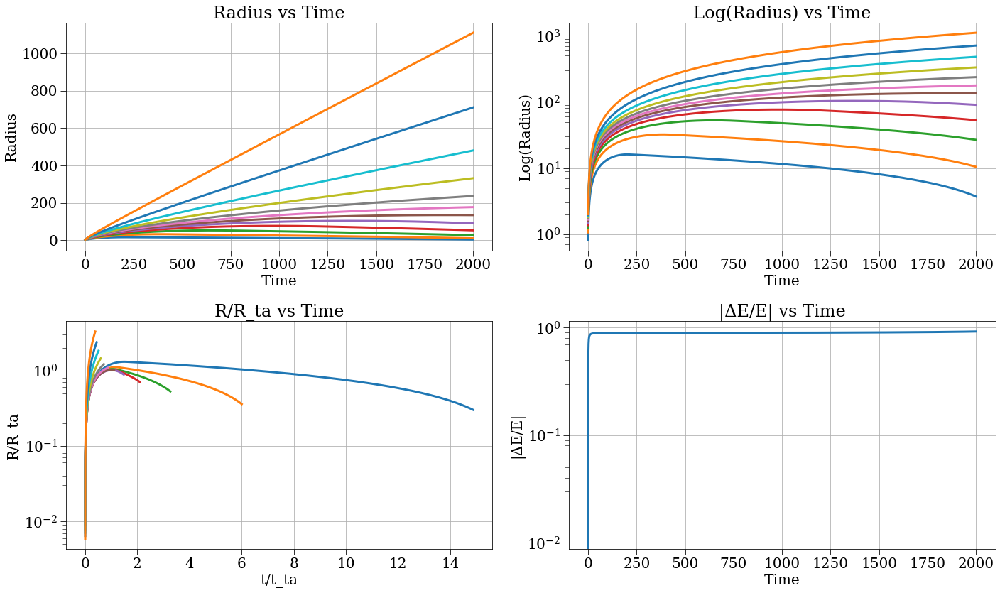

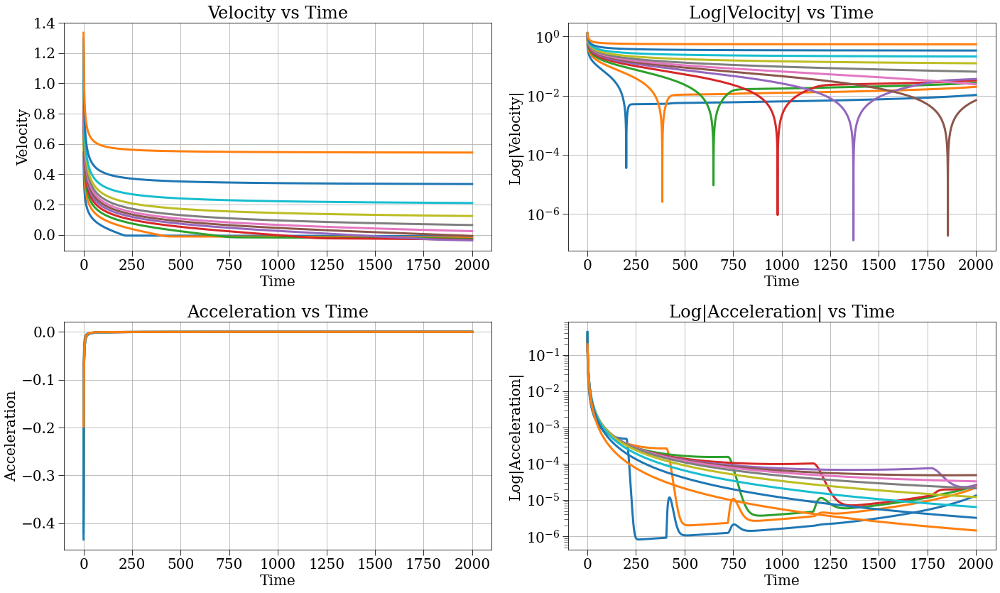

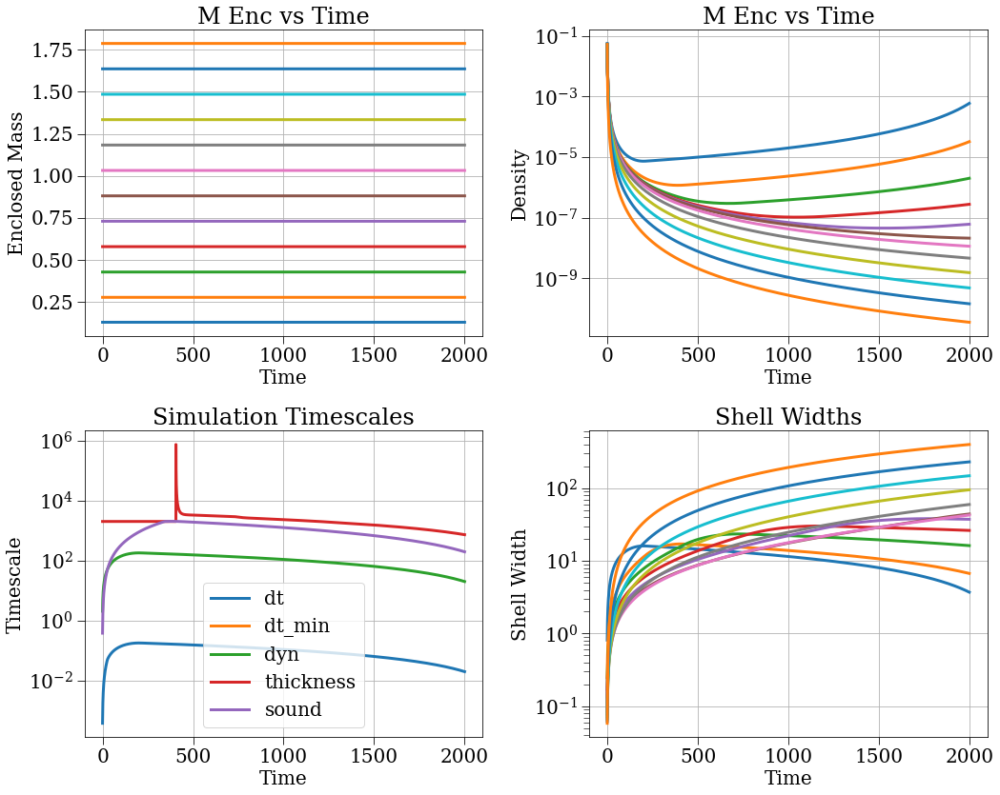

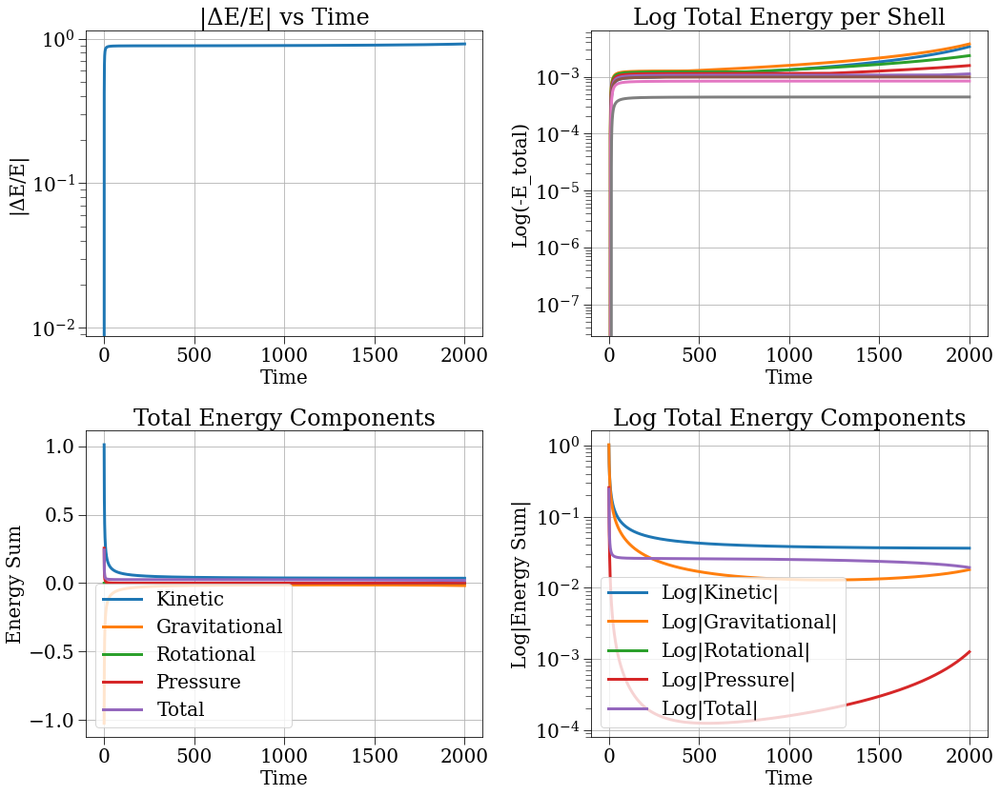

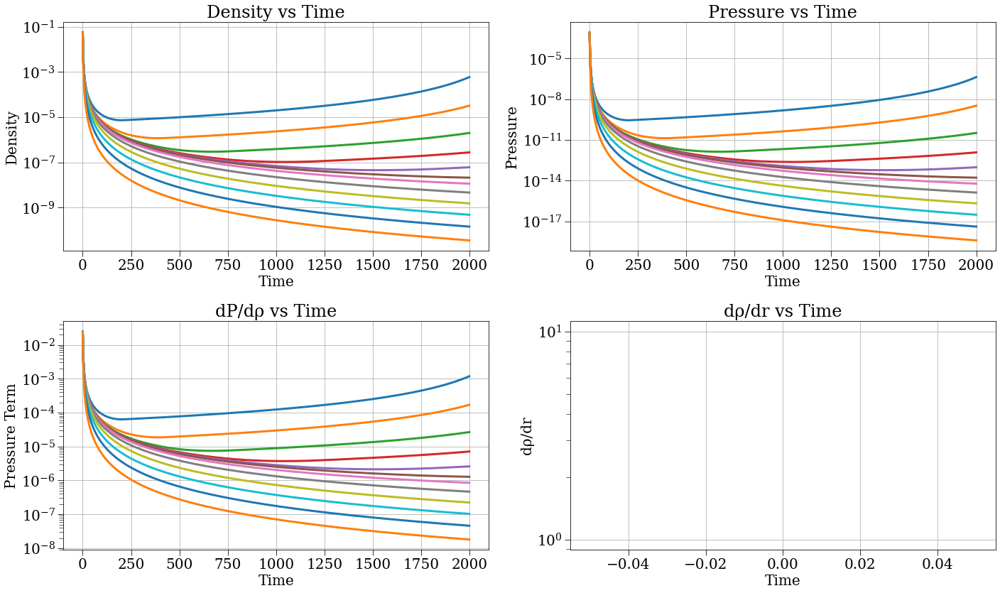

[0.81404383 1.06255727 1.23343644 1.36730292 1.47919342 1.57633746
 1.66279497 1.7410919  1.81291731 1.87946232 1.94160194 2.        ]


In [23]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

In [ ]:
t_max = 2.8
config_gauss = make_cycloid_config(N=80, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_thickness_sound', dt_min=0, safety_factor=1e-3, pressure_strategy='polytrope', no_pm=False, polytropic_index=1.5, polytropic_coef=1, r_max=2, t_ma='gas_vis_dis_fourpi', delta_i=1, r_th=0.5, energy_strategy='gas', H=0, save_dt=1e-2, drhodr_strategy='finite_diff', cq=1, stepper_strategy='leapfrog_kdk', j_coeff=0e-2, density_strategy='background_plus_gaussian', irs='equal_mass')

2025-03-12 16:05:21,713 - collapse - INFO - Simulation setup complete


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:145: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim(config.ylim)


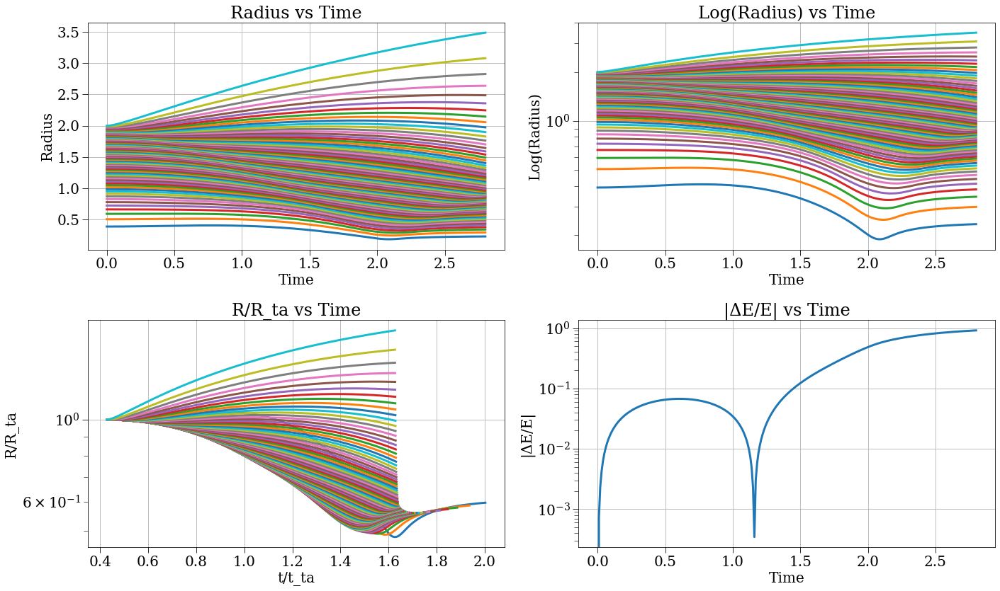

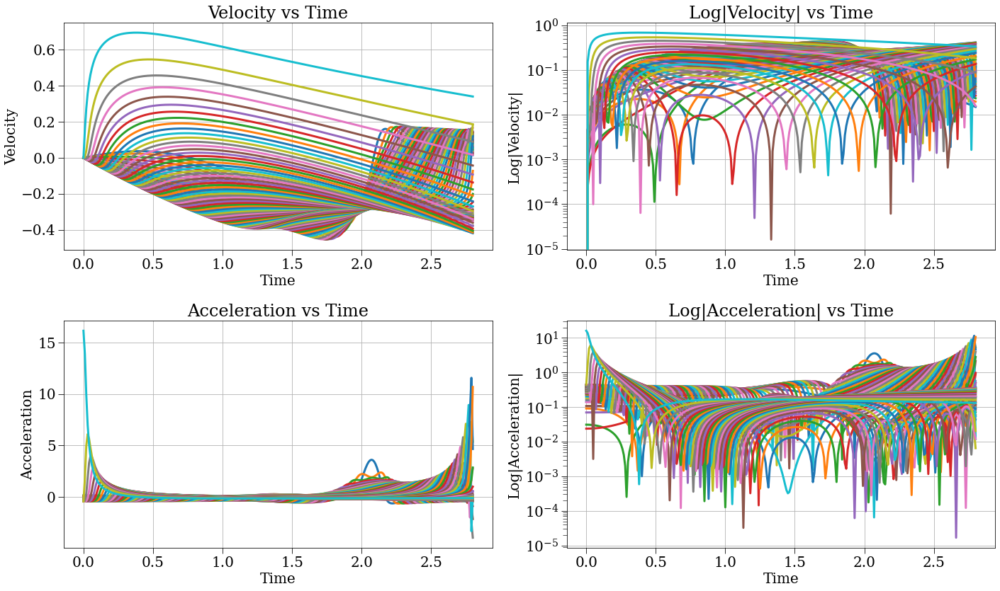

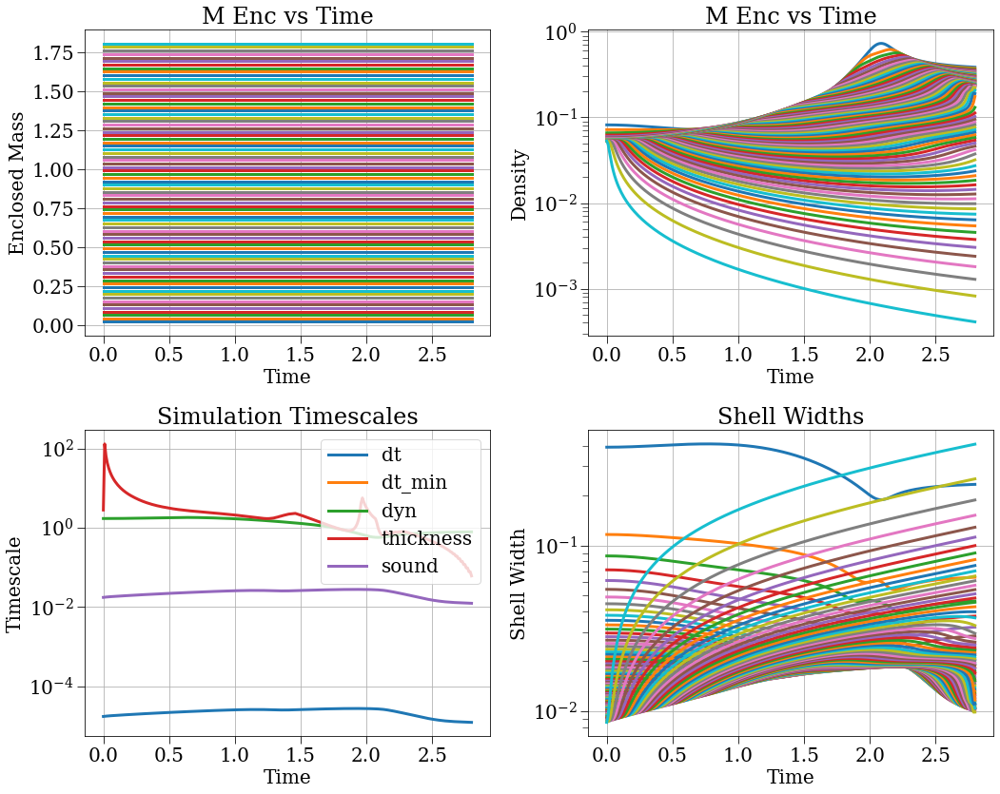

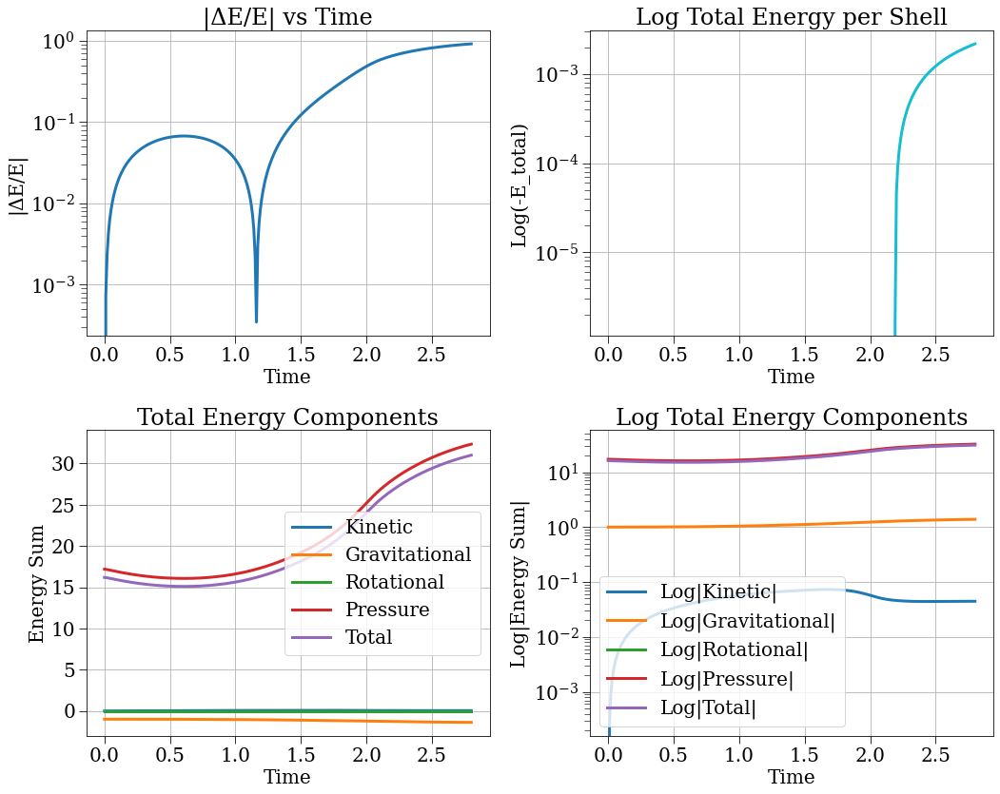

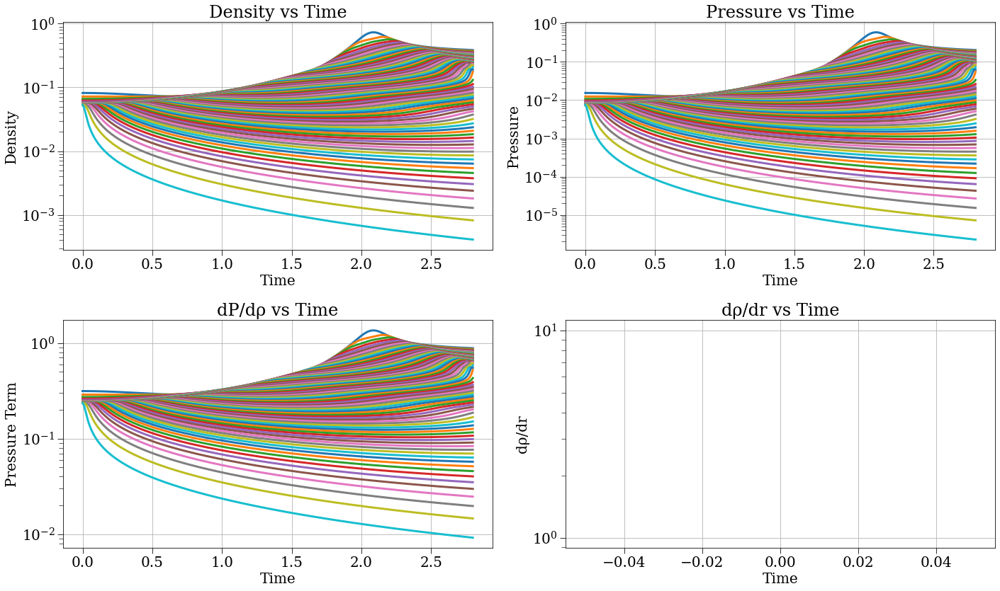

[0.39148057 0.50780817 0.59417674 0.66535551 0.72671875 0.780981
 0.82977761 0.87420441 0.91504655 0.95289182 0.9881939  1.0213109
 1.05253054 1.0820874  1.11017506 1.13695508 1.16256355 1.18711614
 1.21071193 1.23343644 1.25536393 1.27655933 1.2970797  1.31697548
 1.33629146 1.35506759 1.37333966 1.3911399  1.40849737 1.42543843
 1.44198703 1.45816501 1.47399235 1.48948738 1.50466695 1.51954658
 1.53414063 1.54846239 1.56252418 1.57633746 1.58991293 1.60326053
 1.61638959 1.62930882 1.64202642 1.65455005 1.66688695 1.67904391
 1.69102737 1.70284336 1.71449763 1.72599559 1.73734238 1.74854288
 1.75960169 1.77052323 1.78131167 1.791971   1.802505   1.81291731
 1.82321137 1.83339048 1.8434578  1.85341635 1.86326902 1.87301858
 1.88266769 1.89221889 1.90167463 1.91103727 1.92030905 1.92949215
 1.93858866 1.9476006  1.95652991 1.96537844 1.97414801 1.98284035
 1.99145714 2.        ]


In [95]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

In [17]:
t_max = 145
config_gauss = make_cycloid_config(N=100, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_thickness_sound', dt_min=0, safety_factor=1e-3, pressure_strategy='polytrope', no_pm=False, polytropic_index=1.5, polytropic_coef=0.01, r_max=1, accel_strategy='gas_vis_dis_fourpi', delta_i=0.2, r_th=0.5, energy_strategy='gas', H=H0, save_dt=1e-2, drhodr_strategy='finite_diff', cq=16, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', irs='equal_mass')

2025-03-12 23:45:52,343 - collapse - INFO - Simulation setup complete


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:145: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim(config.ylim)


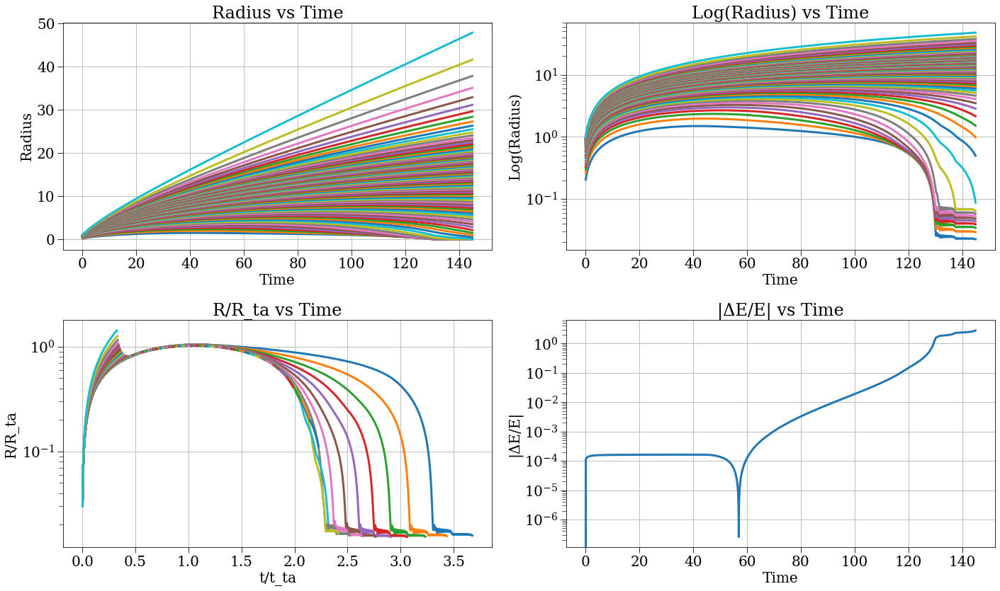

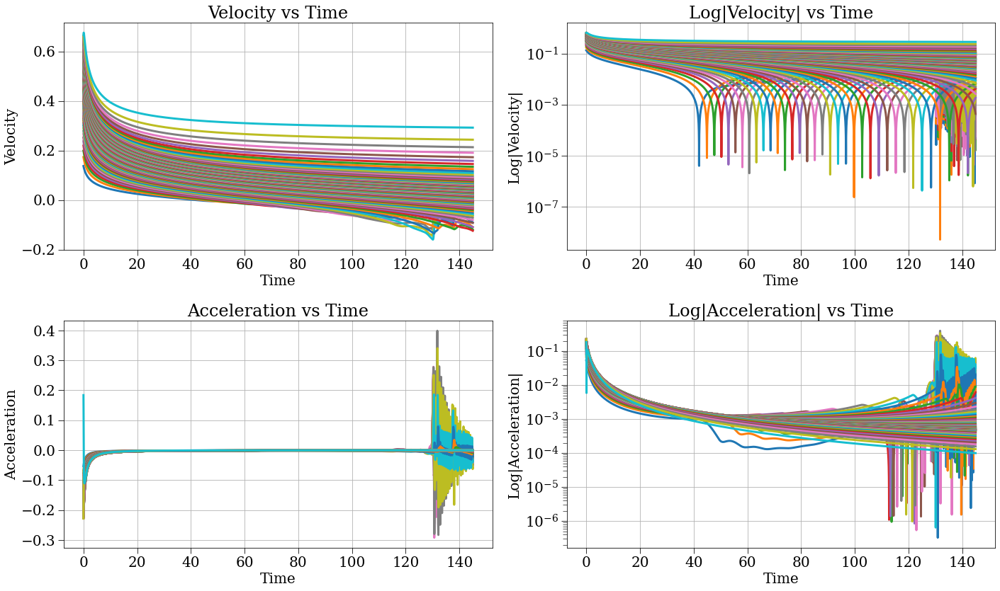

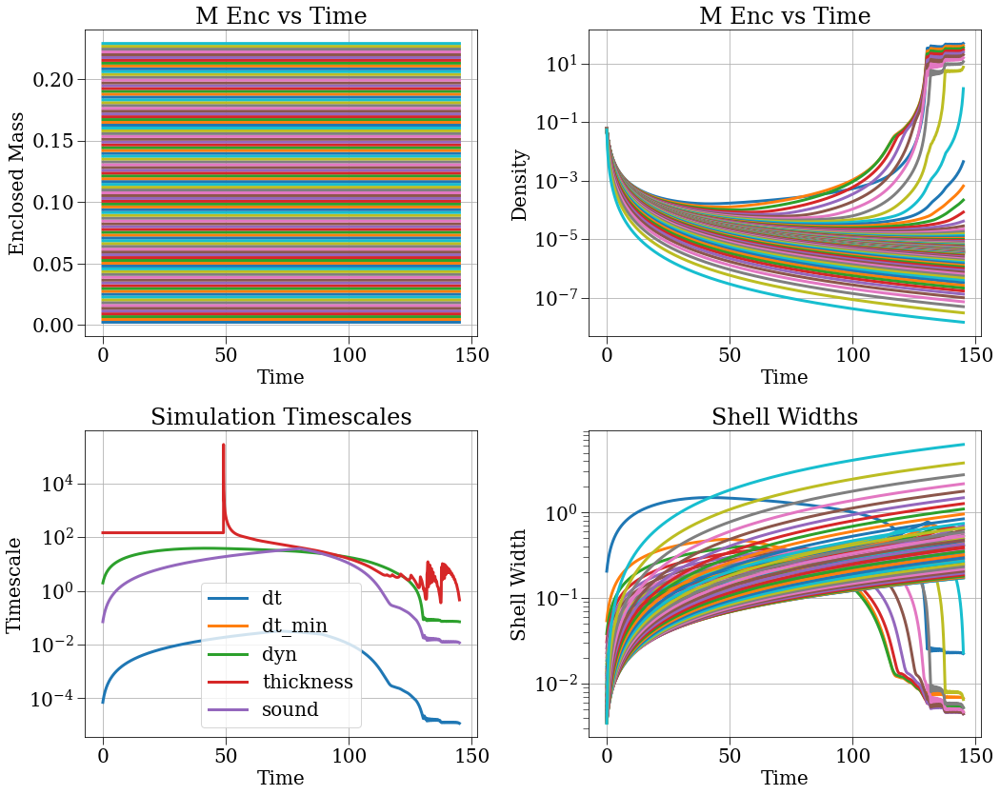

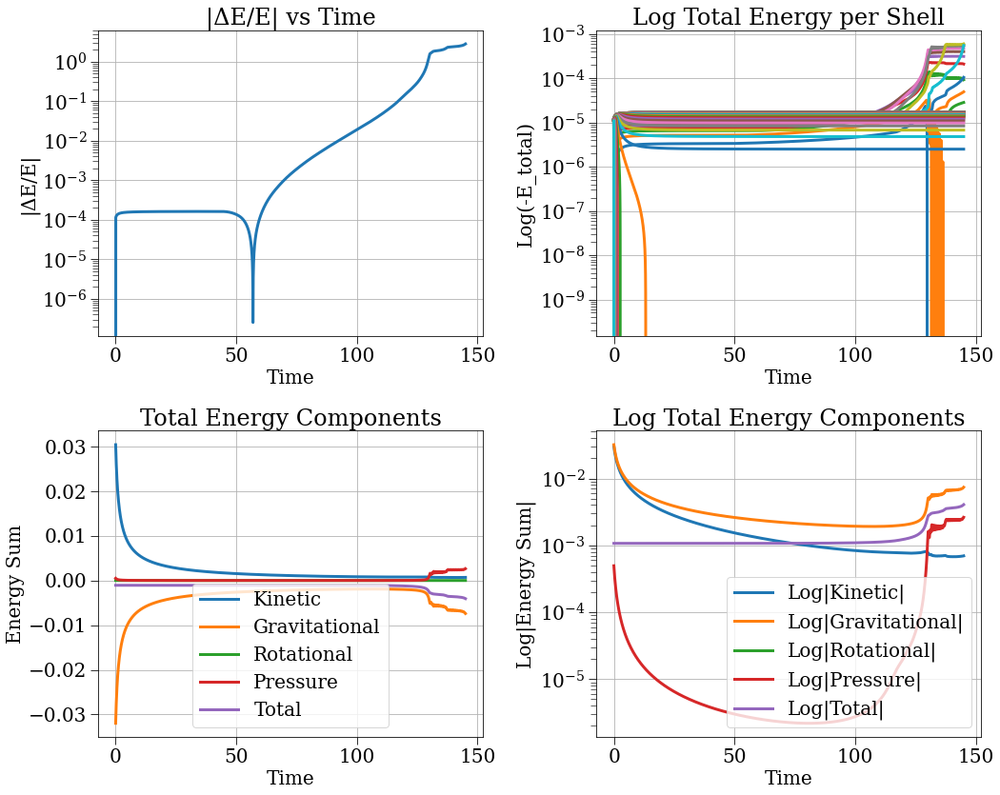

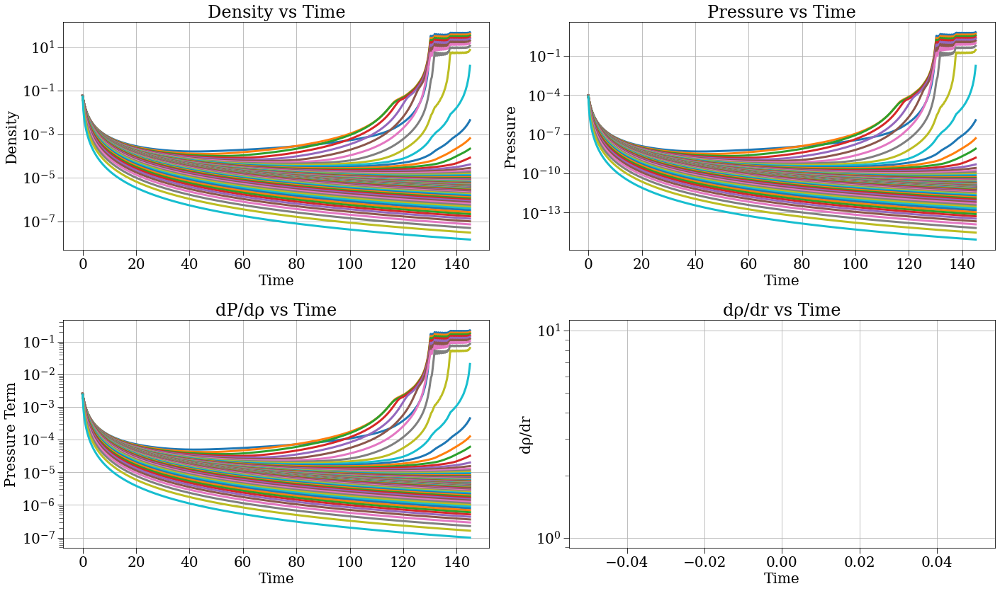

[0.20596366 0.26026402 0.29863088 0.32934913 0.35541325 0.37828975
 0.39881973 0.41753587 0.43479944 0.45086812 0.46593297 0.48014007
 0.49360393 0.5064162  0.51865152 0.5303716  0.5416281  0.5524648
 0.56291914 0.57302341 0.58280574 0.59229072 0.60150008 0.61045306
 0.61916683 0.62765675 0.63593666 0.64401907 0.65191532 0.65963572
 0.66718972 0.67458594 0.68183231 0.68893617 0.69590424 0.70274278
 0.7094576  0.71605408 0.72253725 0.72891179 0.73518208 0.74135225
 0.74742613 0.75340734 0.7592993  0.76510521 0.77082809 0.77647082
 0.7820361  0.78752648 0.7929444  0.79829216 0.80357196 0.80878587
 0.81393588 0.81902389 0.82405168 0.82902098 0.83393343 0.83879061
 0.84359401 0.84834506 0.85304516 0.85769562 0.8622977  0.86685263
 0.87136156 0.87582563 0.88024591 0.88462344 0.88895923 0.89325423
 0.89750937 0.90172556 0.90590365 0.91004447 0.91414884 0.91821753
 0.9222513  0.92625086 0.93021693 0.93415018 0.93805128 0.94192085
 0.94575953 0.94956791 0.95334656 0.95709606 0.96081695 0.96450

In [18]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

In [5]:
t_max = 40
config_gauss = make_cycloid_config(N=100, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_thickness_sound', dt_min=0, safety_factor=1e-3, pressure_strategy='polytrope', no_pm=False, polytropic_index=1.5, polytropic_coef=0.05, r_max=1, accel_strategy='gas_vis_dis_fourpi', delta_i=1, r_th=0.5, energy_strategy='gas', H=H0, save_dt=1e-2, drhodr_strategy='finite_diff', cq=1, stepper_strategy='leapfrog_kdk', j_coeff=0, density_strategy='background_plus_gaussian', irs='equal_mass')

2025-03-13 01:04:12,386 - collapse - INFO - Simulation setup complete


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:145: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim(config.ylim)


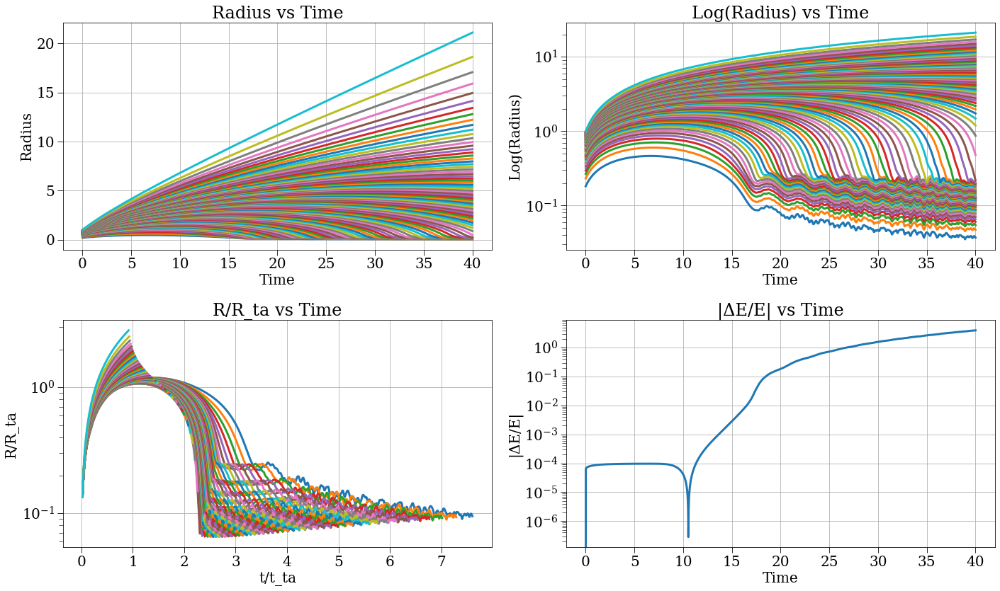

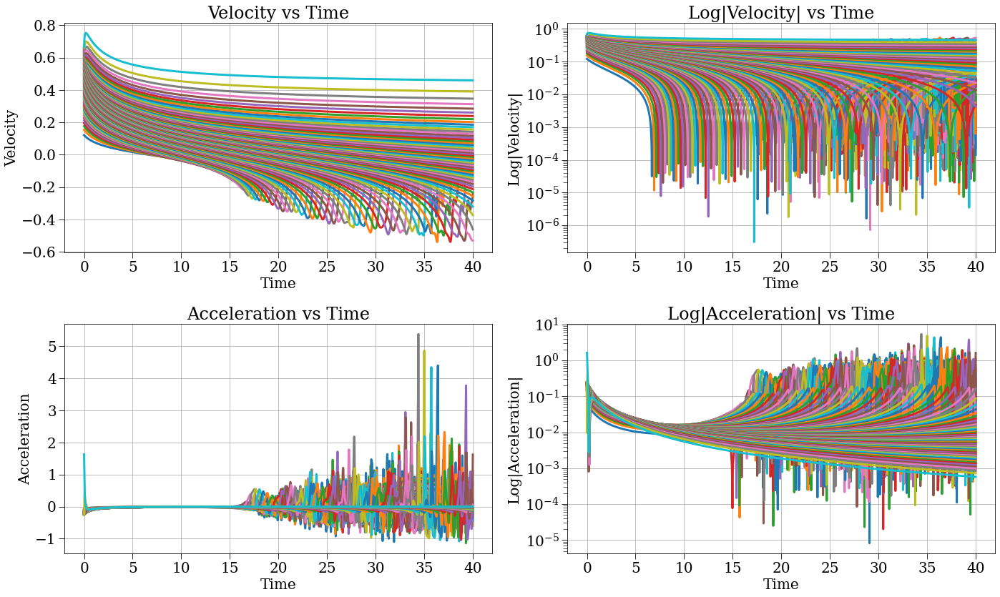

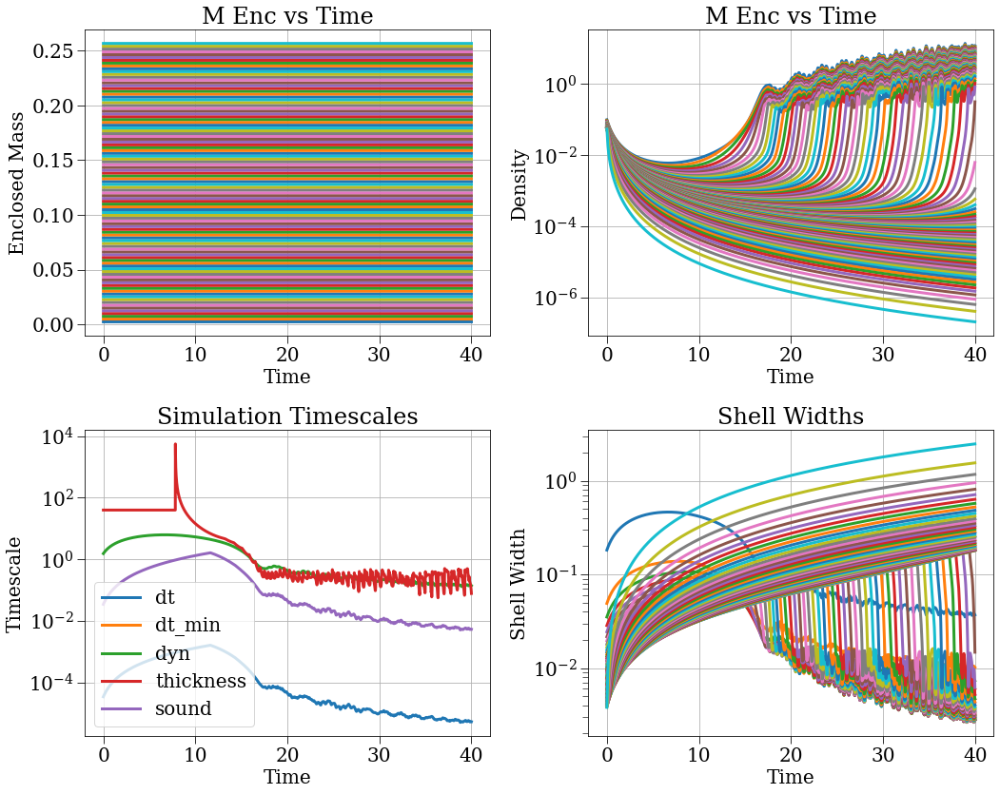

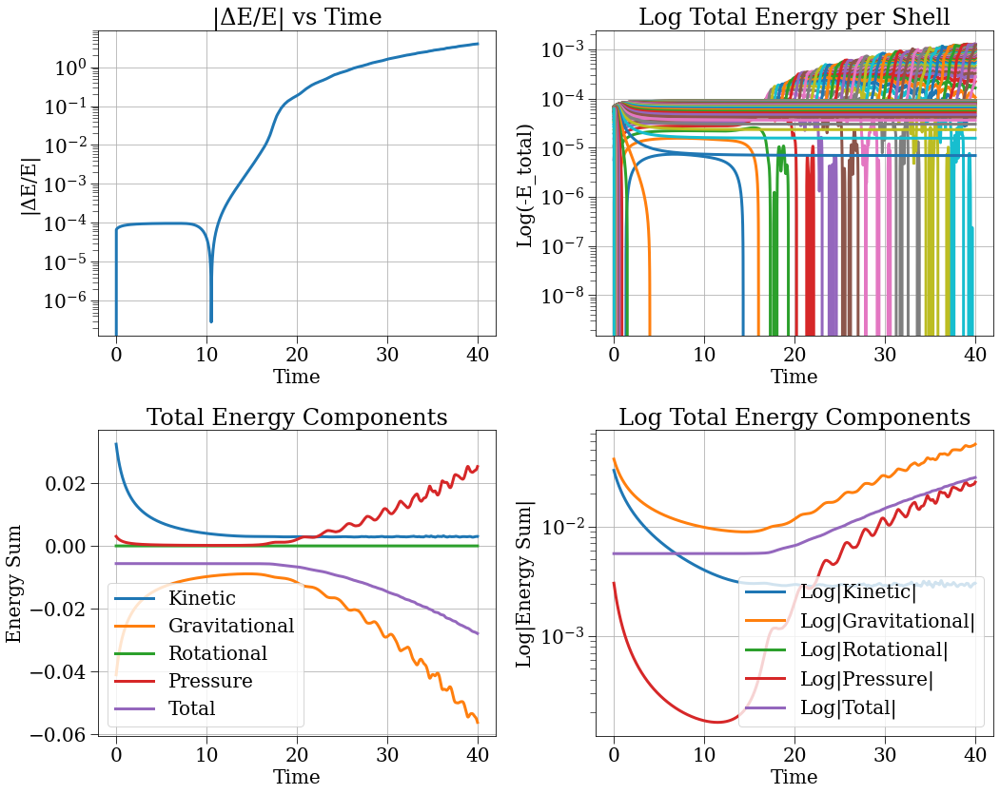

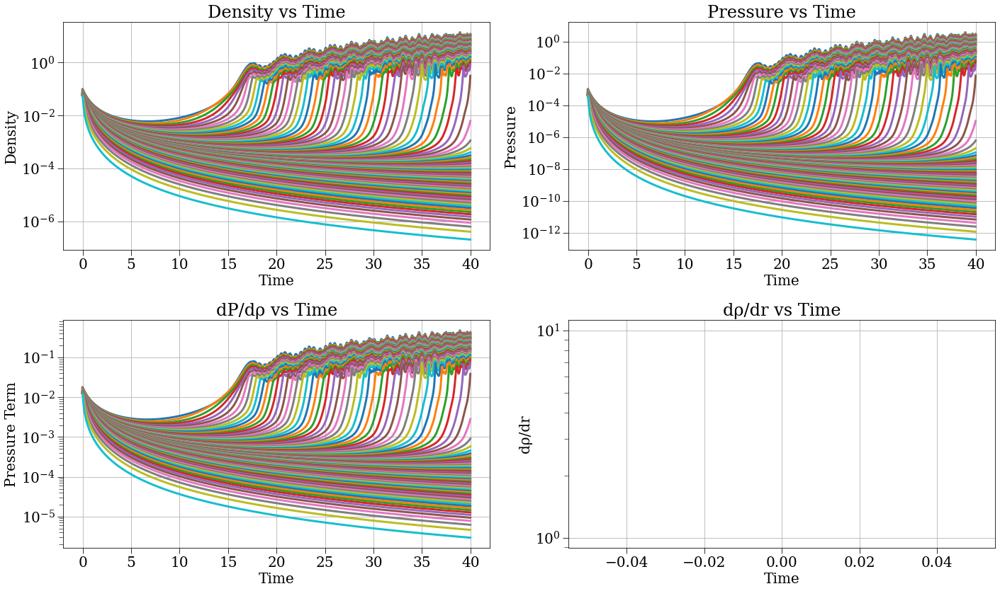

[0.18192175 0.23093881 0.26602389 0.29443232 0.31878401 0.34036057
 0.35989612 0.37785486 0.39455107 0.41020853 0.4249928  0.43903021
 0.45241958 0.46523978 0.47755493 0.48941789 0.50087283 0.51195709
 0.52270251 0.53313654 0.54328299 0.55316269 0.56279397 0.57219307
 0.58137445 0.59035105 0.59913451 0.60773535 0.61616311 0.62442647
 0.63253337 0.6404911  0.64830634 0.65598527 0.66353362 0.67095669
 0.67825941 0.68544638 0.69252191 0.69949002 0.70635449 0.71311888
 0.71978653 0.7263606  0.73284407 0.73923979 0.74555041 0.75177849
 0.75792646 0.7639966  0.76999112 0.77591211 0.78176157 0.78754142
 0.79325348 0.79889951 0.80448119 0.81000014 0.8154579  0.82085598
 0.82619579 0.83147873 0.83670612 0.84187924 0.84699933 0.85206758
 0.85708515 0.86205315 0.86697265 0.87184469 0.87667028 0.88145039
 0.88618597 0.89087793 0.89552716 0.90013451 0.90470082 0.9092269
 0.91371353 0.91816148 0.92257147 0.92694424 0.93128047 0.93558086
 0.93984605 0.9440767  0.94827342 0.95243683 0.95656751 0.96066

In [6]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

In [42]:
0.225**(1/3) / 4

0.15205504988933502

In [28]:
t_max = 180
config_gauss = make_cycloid_config(N=12, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_thickness_sound', dt_min=0, safety_factor=1e-3, pressure_strategy='polytrope', no_pm=False, polytropic_index=1.5, polytropic_coef=0.1, r_max=1, accel_strategy='gas_vis_dis_fourpi', delta_i=1, r_th=0.5, energy_strategy='gas', H=H0, save_dt=1e-2, drhodr_strategy='finite_diff', cq=4, stepper_strategy='leapfrog_kdk', j_coeff=1e-2, density_strategy='background_plus_gaussian', irs='equal_mass')

2025-03-12 22:50:20,012 - collapse - INFO - Simulation setup complete


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:145: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim(config.ylim)


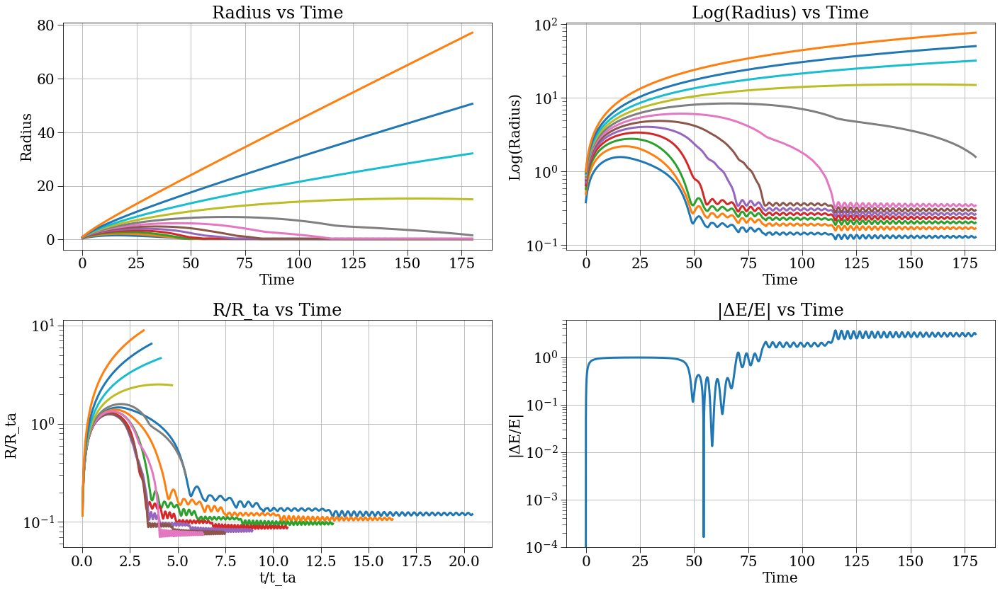

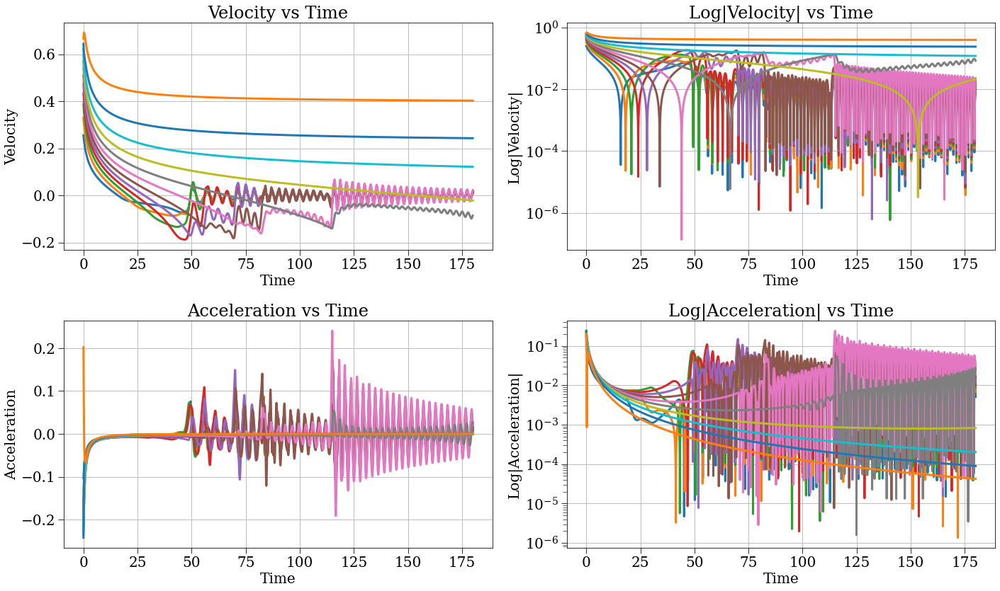

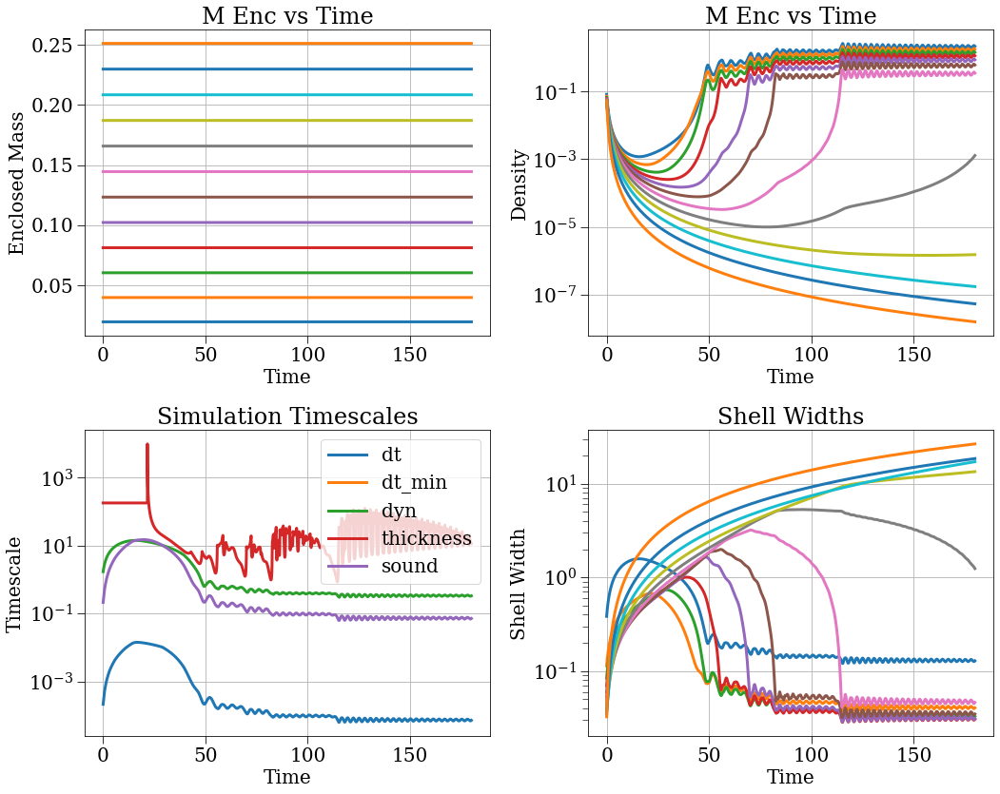

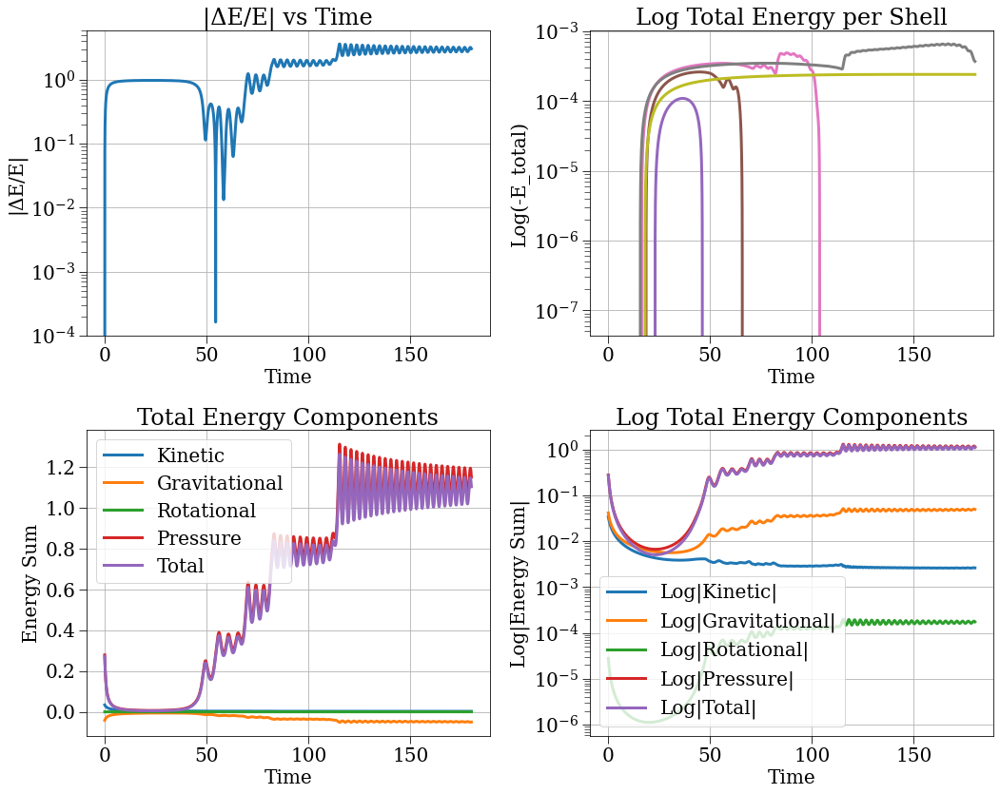

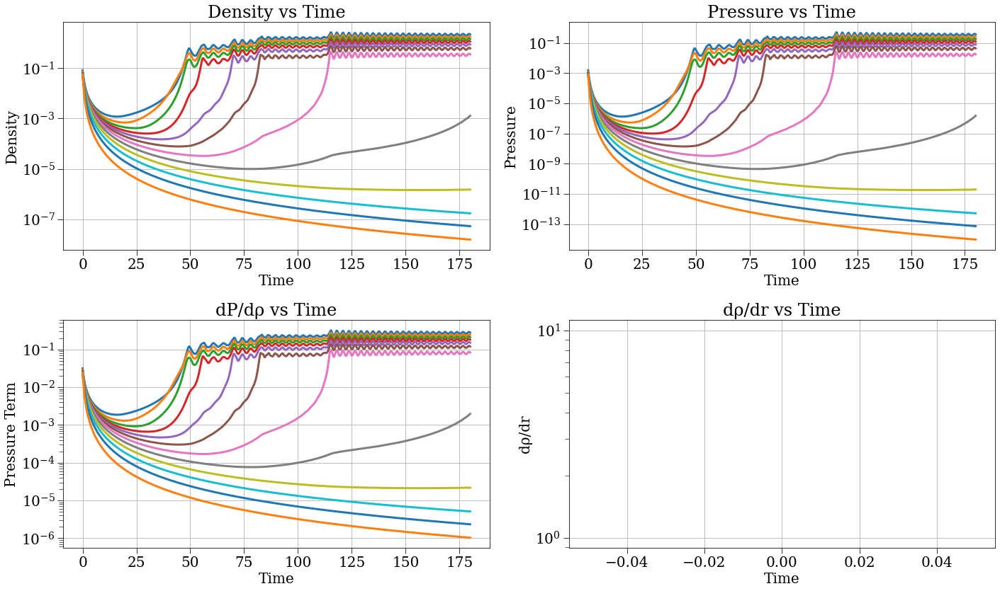

[0.38354802 0.49709743 0.58137444 0.65088084 0.71087499 0.7639966
 0.81182612 0.85541819 0.89552716 0.93271789 0.96742702 1.        ]


In [29]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

In [9]:
t_max = 180
config_gauss = make_cycloid_config(N=4, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_thickness_sound', dt_min=0, safety_factor=1e-3, pressure_strategy='polytrope', no_pm=False, polytropic_index=1.5, polytropic_coef=0.1, r_max=1, accel_strategy='gas_vis_dis_fourpi', delta_i=1, r_th=0.5, energy_strategy='gas', H=H0, save_dt=1e-2, drhodr_strategy='finite_diff', cq=0, stepper_strategy='leapfrog_kdk', j_coeff=1e-2, density_strategy='background_plus_gaussian', irs='equal_mass')

2025-03-06 09:54:41,607 - collapse - INFO - Simulation setup complete


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:145: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim(config.ylim)


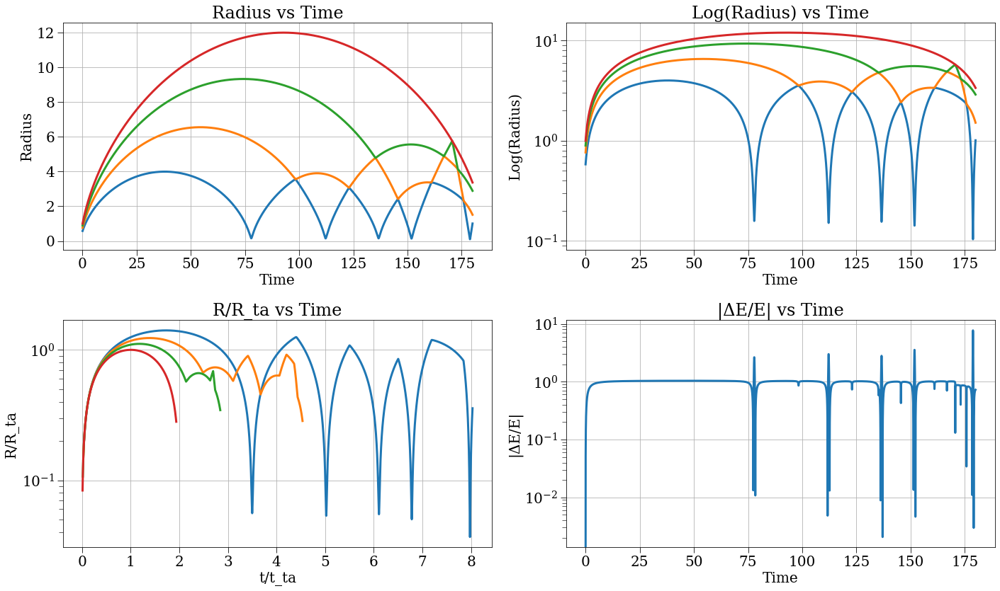

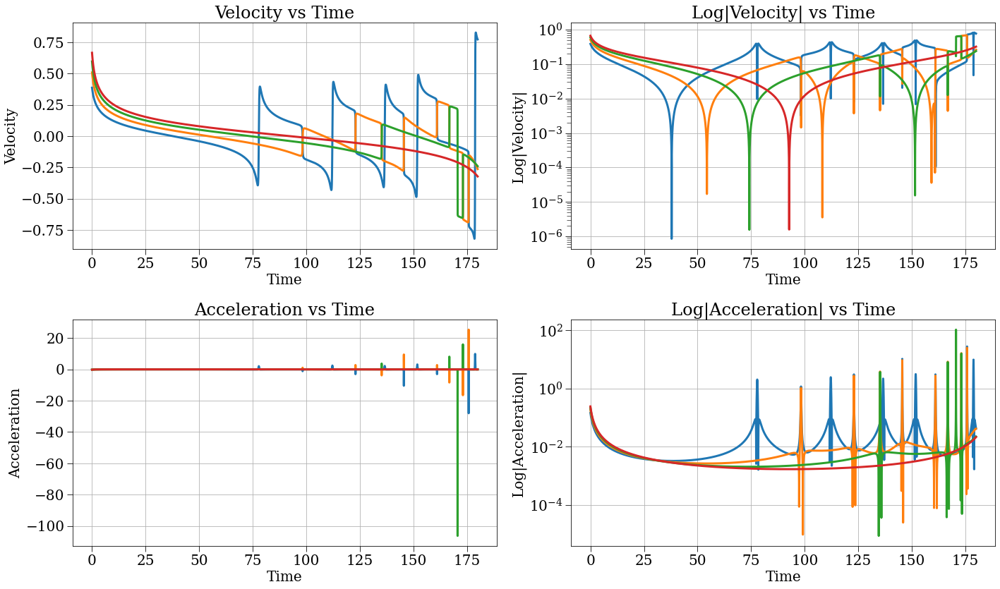

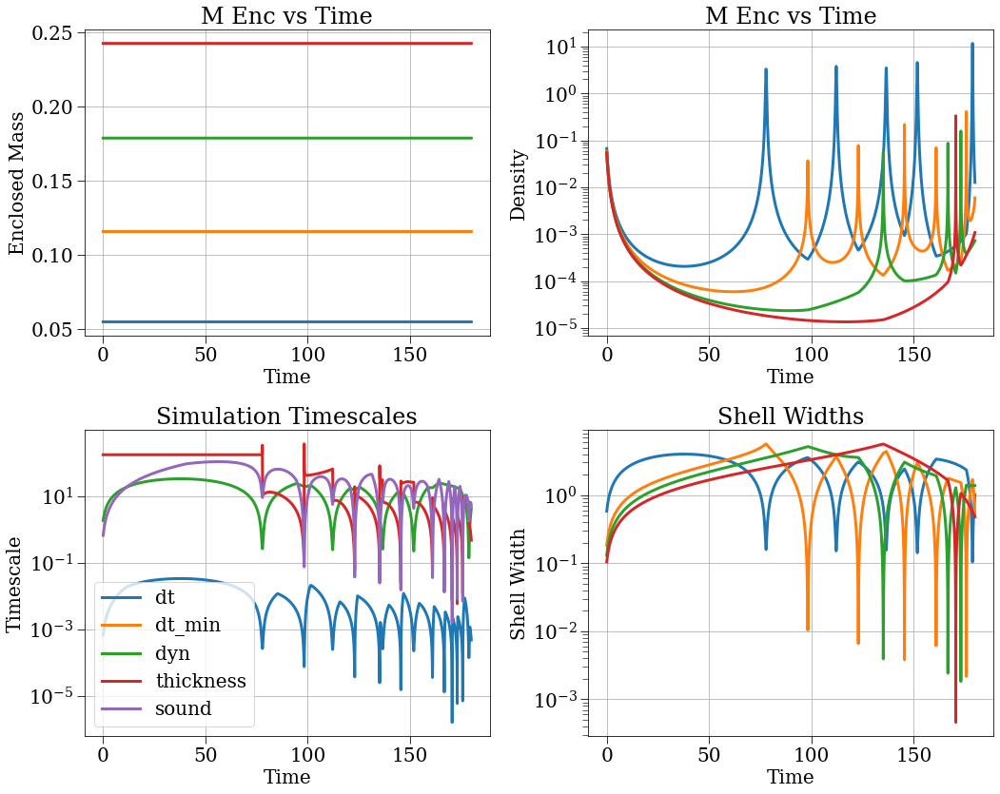

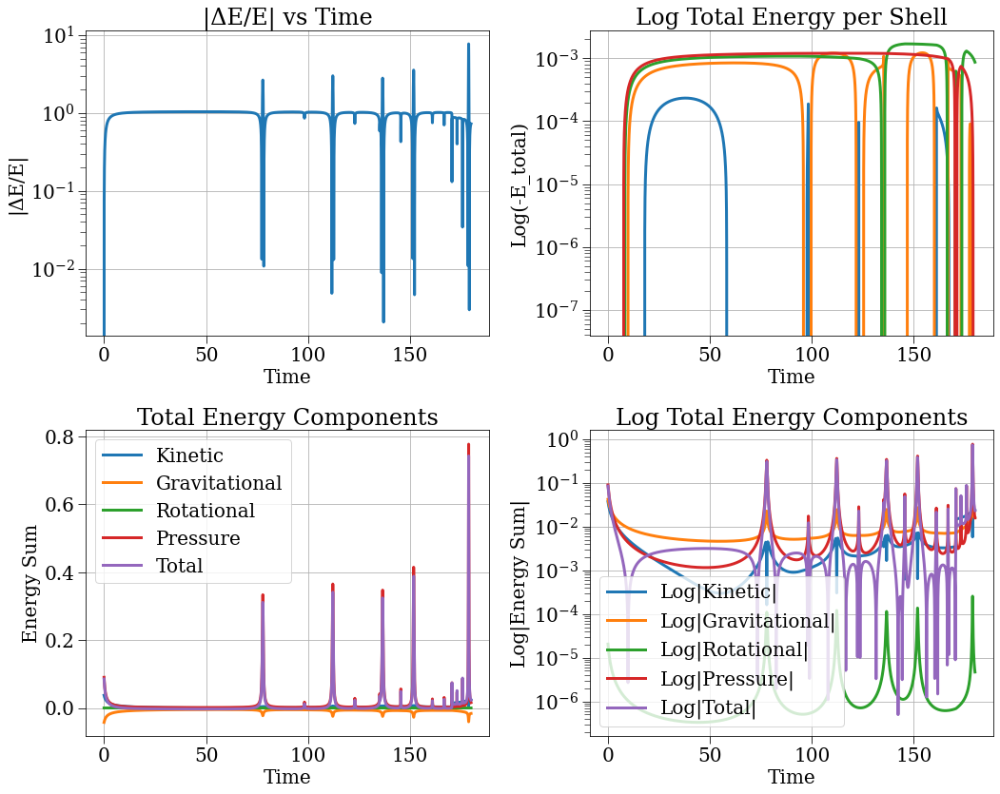

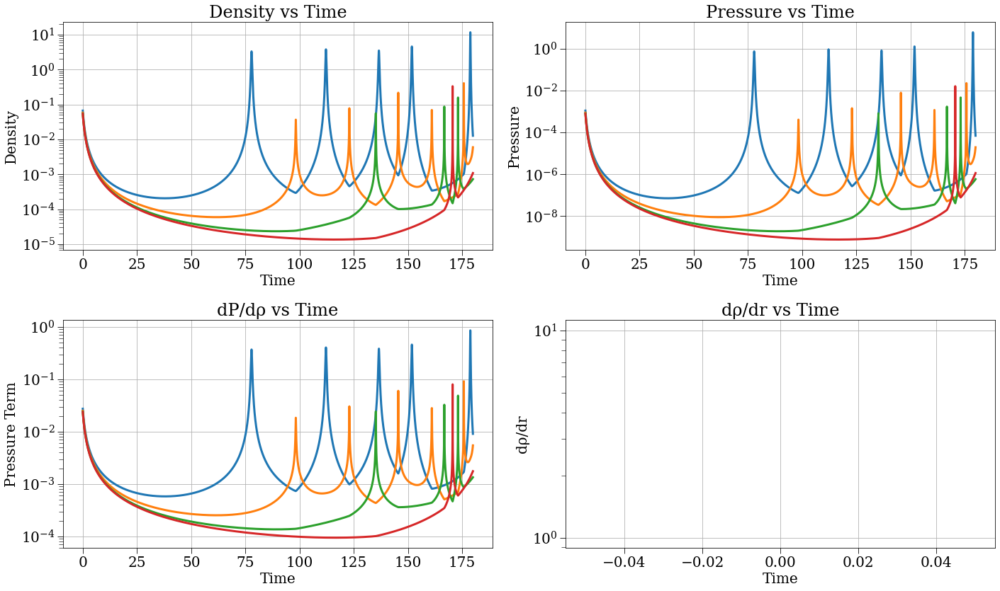

[0.58137444 0.7639966  0.89552716 1.        ]


In [10]:
s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

2025-03-06 09:55:23,574 - collapse - INFO - Simulation setup complete


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:145: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim(config.ylim)


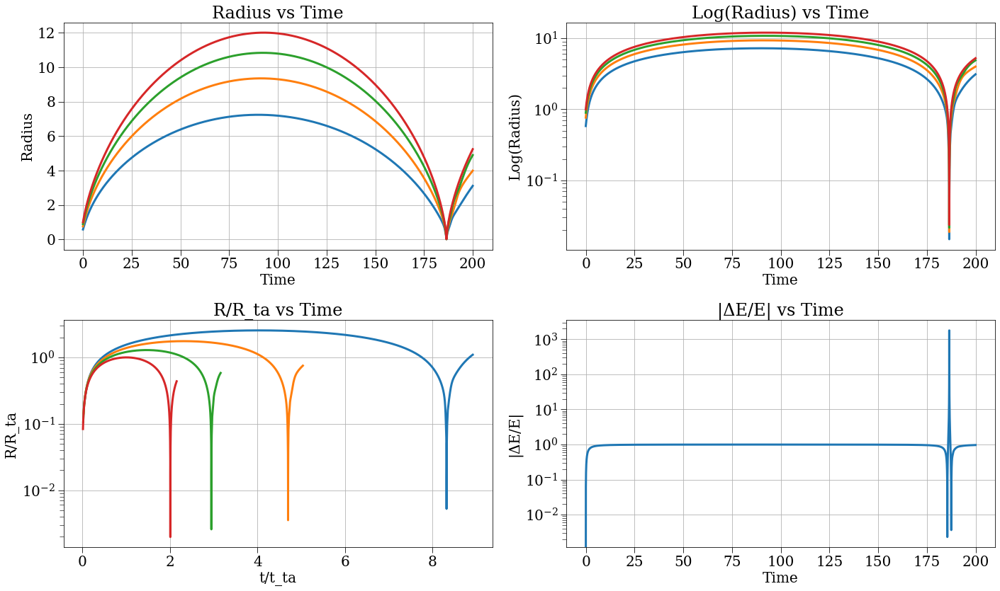

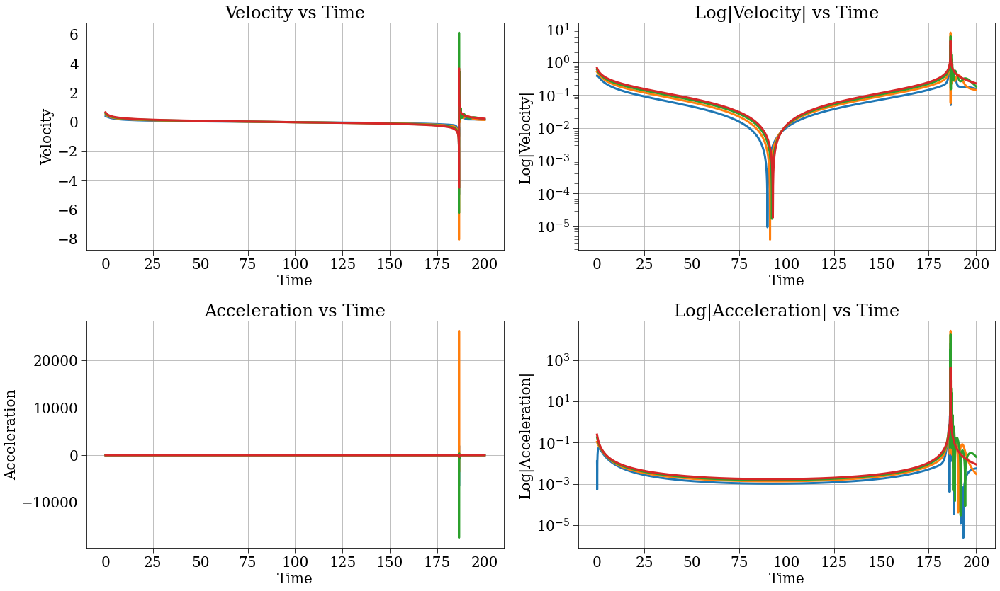

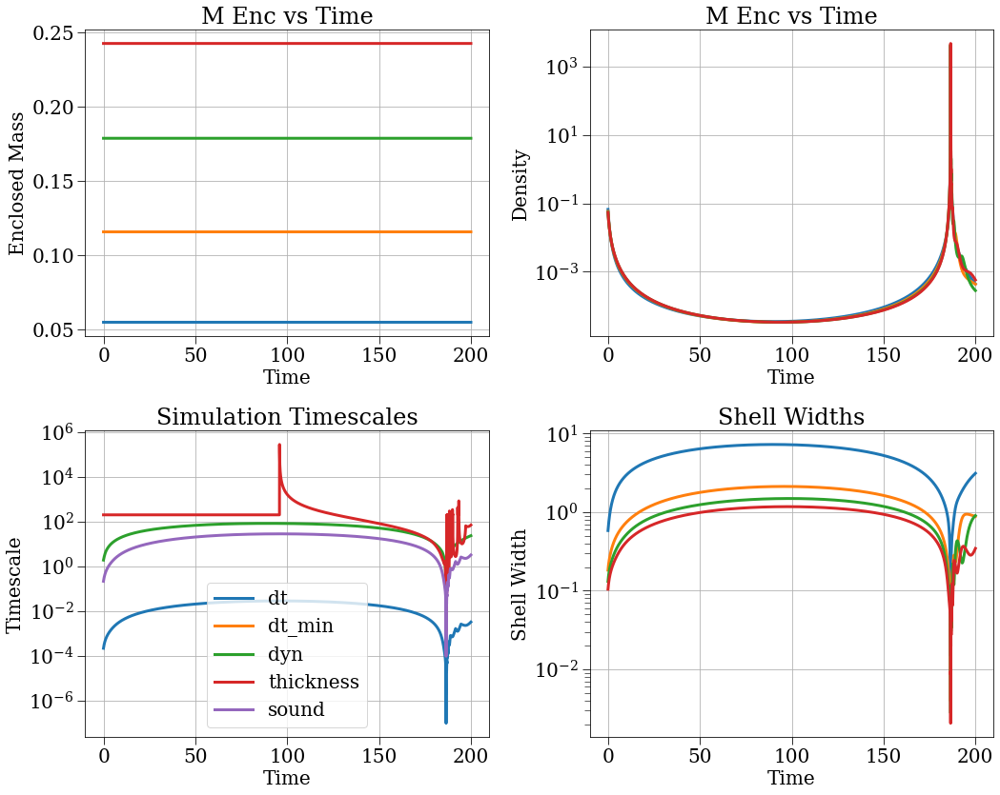

/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:104: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set_yscale(config.yscale)


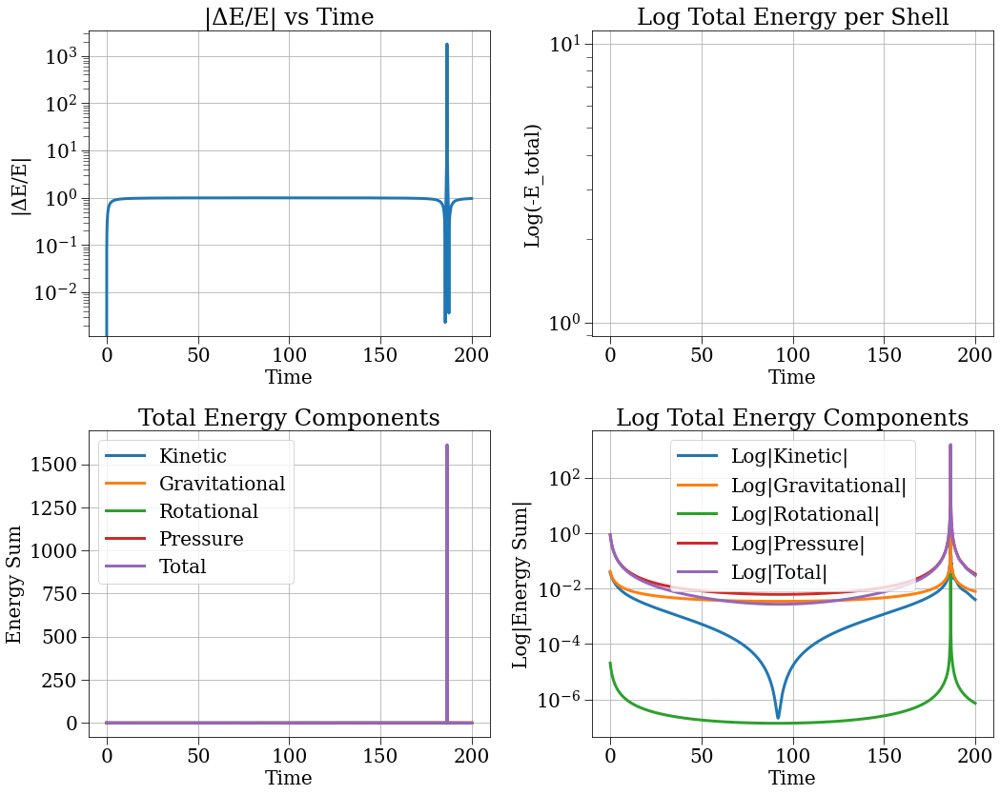

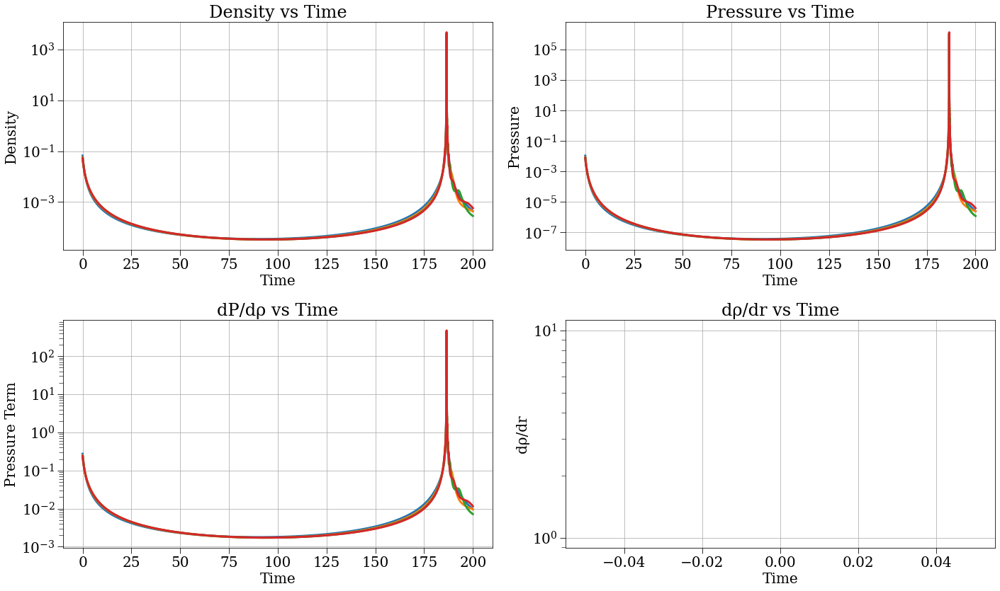

[0.58137444 0.7639966  0.89552716 1.        ]


In [12]:
t_max = 200
config_gauss = make_cycloid_config(N=4, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_thickness_sound', dt_min=0, safety_factor=1e-3, pressure_strategy='polytrope', no_pm=False, polytropic_index=1.5, polytropic_coef=1, r_max=1, accel_strategy='gas_vis_dis_fourpi', delta_i=1, r_th=0.5, energy_strategy='gas', H=H0, save_dt=1e-2, drhodr_strategy='finite_diff', cq=0, stepper_strategy='leapfrog_kdk', j_coeff=1e-2, density_strategy='background_plus_gaussian', irs='equal_mass')

s, r, c = run_and_plot(config_gauss)
print(r['r'][0,:])

In [24]:
t_max = 10
astrat = 'gas_vis_dis_fourpi'
#astrat = 'soft_all'
config_tw = make_cycloid_config(N=500, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_sound_thickness', dt_min=0, safety_factor=1e-3, pressure_strategy='polytrope', no_pm=False, polytropic_index=1.5, polytropic_coef=0.5, r_max=1, accel_strategy=astrat, delta_i=1/(4/3 * np.pi * rho_H) - 1, relaxation_time=0, energy_strategy='gas', H=0, save_dt=1e-2, drhodr_strategy='finite_diff', cq=4, stepper_strategy='velocity_verlet', j_coeff=0, irs='equal_mass')

2025-03-13 01:26:55,088 - collapse - INFO - Simulation setup complete


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:145: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim(config.ylim)


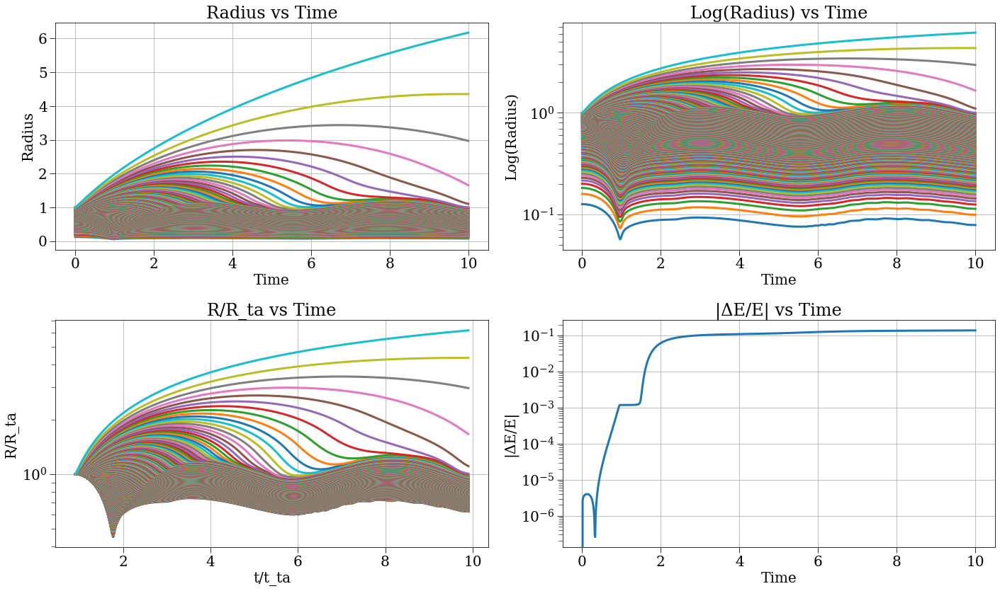

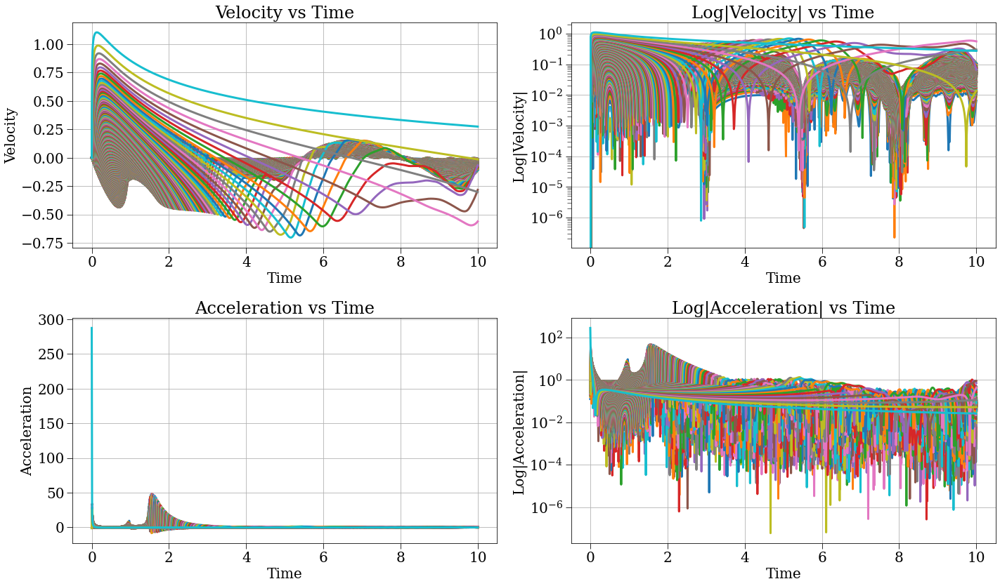

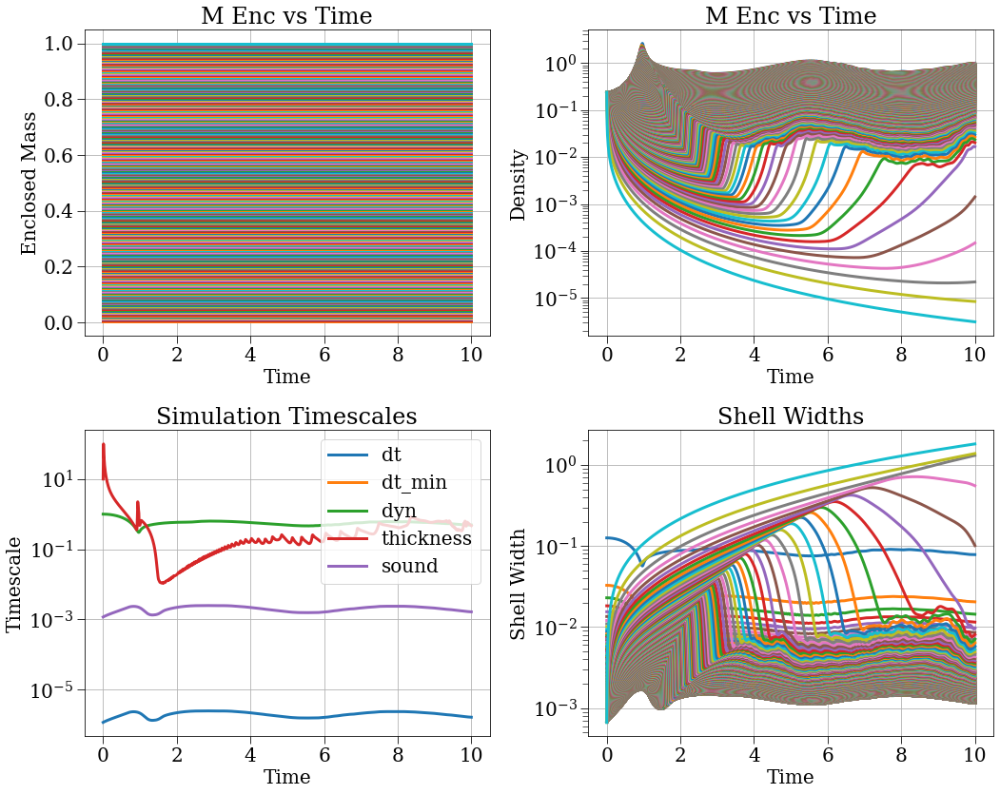

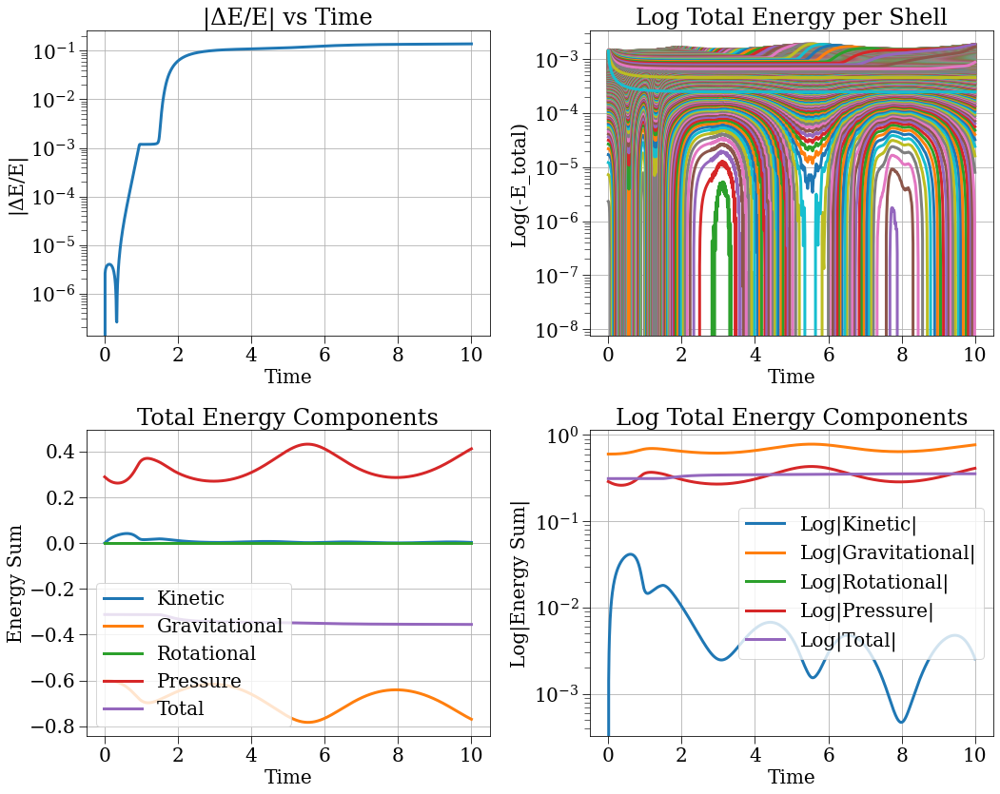

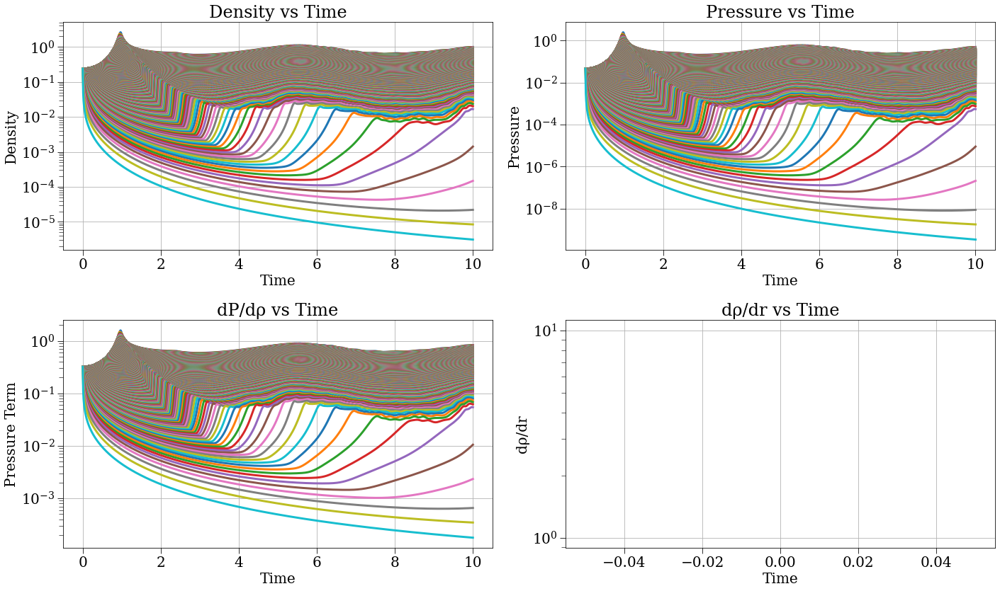

[0.1259921  0.15874011 0.18171206 0.2        0.21544347 0.22894285
 0.24101423 0.25198421 0.26207414 0.27144176 0.28020393 0.28844991
 0.29624961 0.3036589  0.31072325 0.31748021 0.32396118 0.33019272
 0.33619754 0.34199519 0.34760266 0.35303483 0.35830479 0.36342412
 0.36840315 0.37325112 0.37797631 0.38258624 0.38708766 0.39148676
 0.39578916 0.4        0.404124   0.40816551 0.41212853 0.41601676
 0.41983365 0.42358236 0.42726587 0.43088694 0.43444815 0.43795191
 0.4414005  0.44479602 0.44814047 0.45143574 0.45468359 0.4578857
 0.46104363 0.46415888 0.46723287 0.47026694 0.47326235 0.47622032
 0.47914199 0.48202845 0.48488076 0.4876999  0.49048681 0.49324241
 0.49596757 0.4986631  0.50132979 0.50396842 0.5065797  0.50916434
 0.51172299 0.51425632 0.51676493 0.51924941 0.52171034 0.52414828
 0.52656374 0.52895725 0.53132928 0.53368033 0.53601084 0.53832126
 0.54061202 0.54288352 0.54513618 0.54737037 0.54958647 0.55178484
 0.55396583 0.55612978 0.55827702 0.56040787 0.56252263 0.56462

In [25]:
s, r, c = run_and_plot(config_tw, profile=False)
print(r['r'][0,:])

In [135]:
t_max = 4
astrat = 'gas_vis_dis_fourpi'
#astrat = 'soft_all'
config_tw = make_cycloid_config(N=10, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_sound_thickness', dt_min=0, safety_factor=1e-3, pressure_strategy='polytrope', no_pm=False, polytropic_index=1.5, polytropic_coef=1, r_max=1, accel_strategy=astrat, delta_i=1/(4/3 * np.pi * rho_H) - 1, relaxation_time=0, energy_strategy='gas', H=0, save_dt=1e-2, drhodr_strategy='finite_diff', cq=0, stepper_strategy='velocity_verlet', j_coeff=1e-1, irs='equal_mass')

2025-03-06 01:37:19,792 - collapse - INFO - Simulation setup complete


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:145: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim(config.ylim)


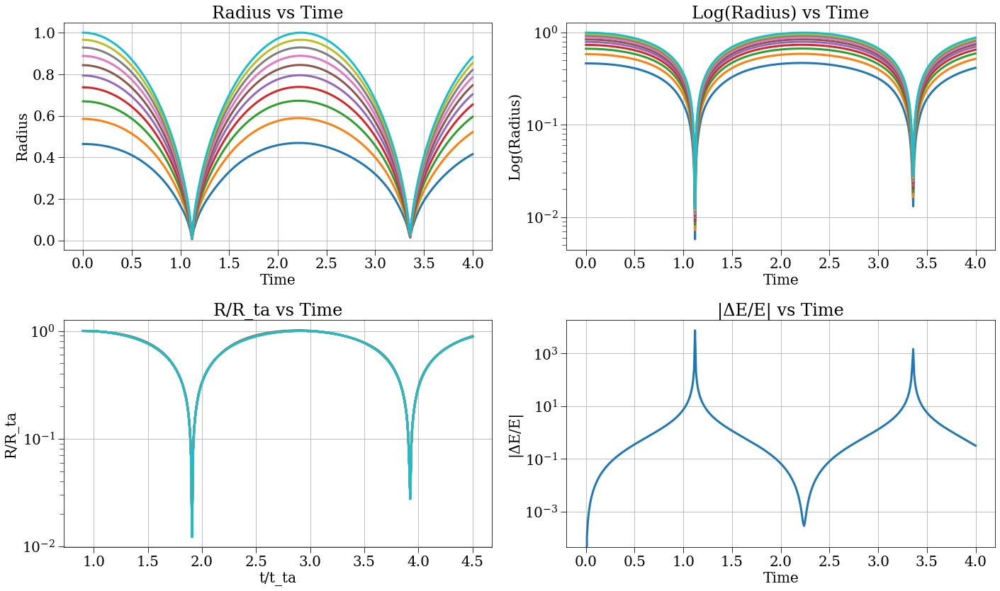

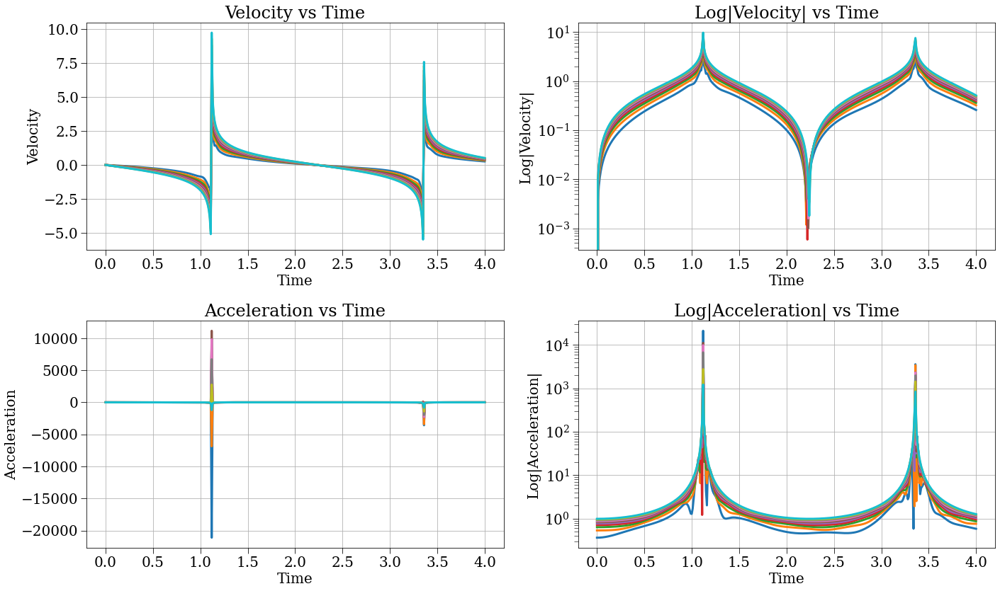

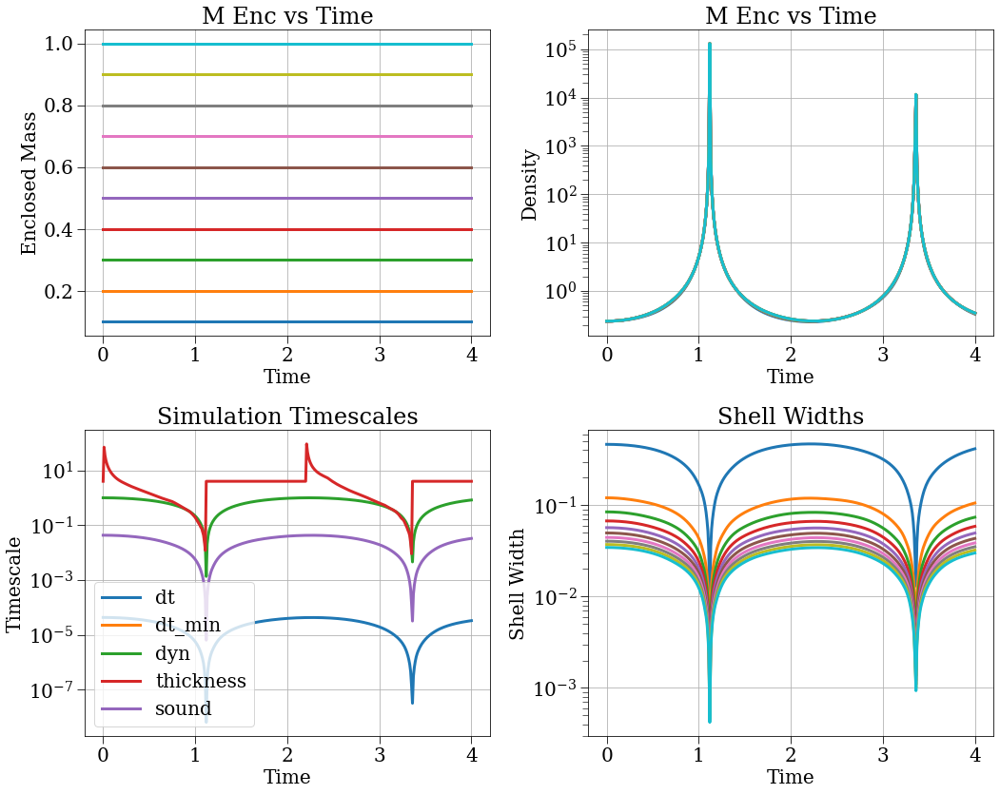

/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:104: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set_yscale(config.yscale)


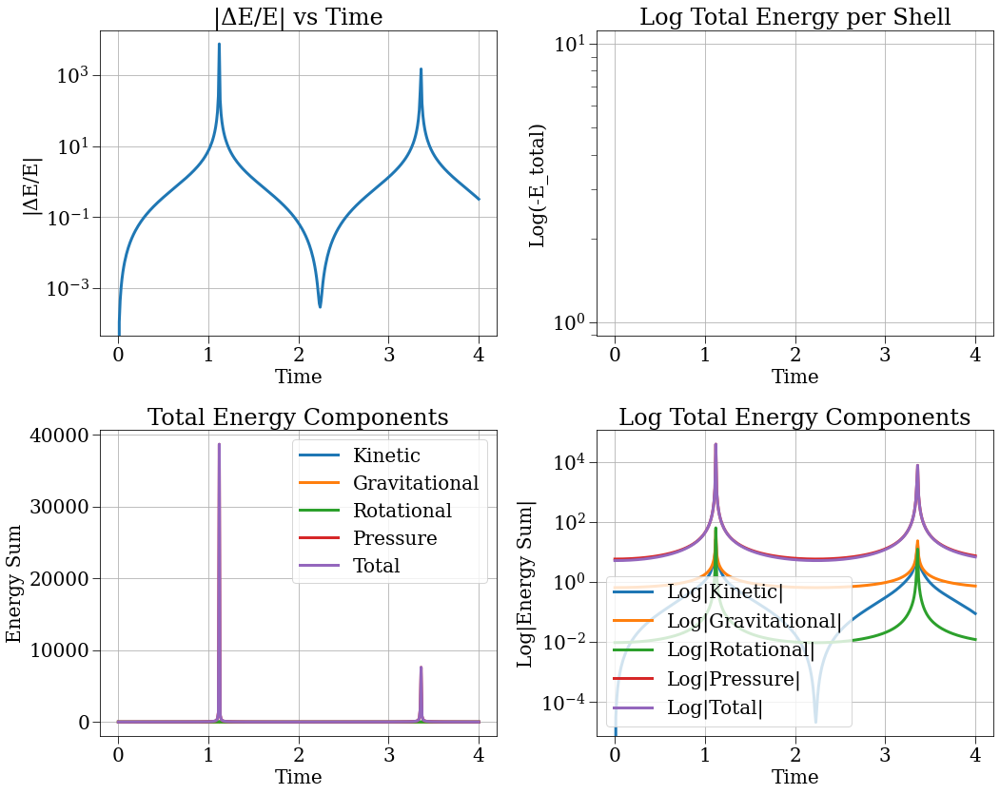

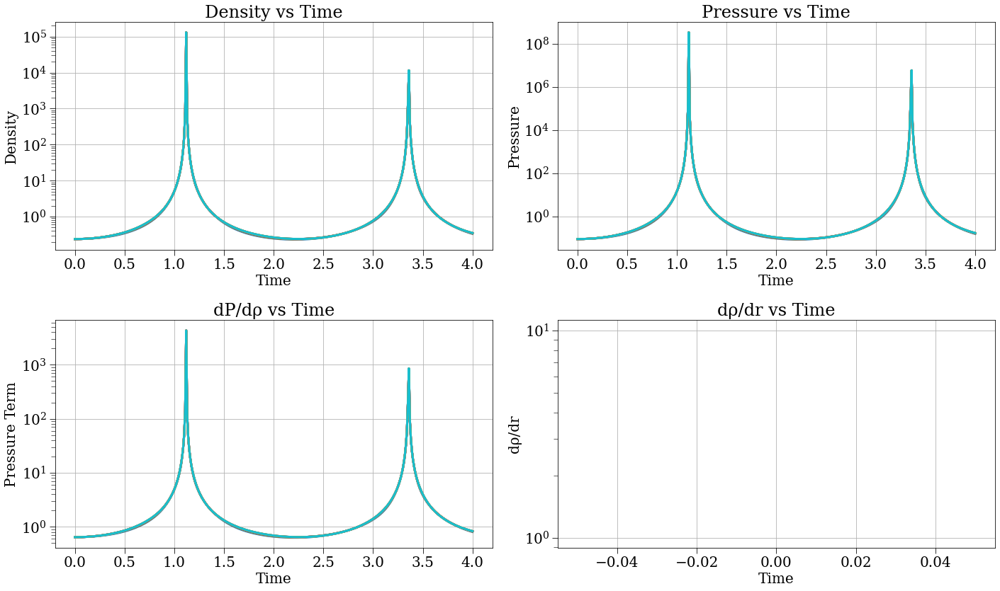

[0.46415888 0.58480355 0.66943295 0.7368063  0.79370053 0.84343266
 0.887904   0.92831777 0.96548938 1.        ]


In [136]:
s, r, c = run_and_plot(config_tw, profile=False)
print(r['r'][0,:])

In [139]:
t_max = 5
astrat = 'gas_vis_dis_fourpi'
astrat = 'soft_all'
config_tw = make_cycloid_config(N=2, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_thickness', dt_min=1e-16, safety_factor=1e-3, pressure_strategy='polytrope', no_pm=False, polytropic_index=1.5, polytropic_coef=0, r_max=1, accel_strategy=astrat, delta_i=1/(4/3 * np.pi * rho_H) - 1, relaxation_time=0, energy_strategy='kin_grav_rot', H=0, save_dt=1e-2, drhodr_strategy='finite_diff', cq=0, stepper_strategy='velocity_verlet', j_coeff=3e-1, irs='equal_mass')

s, r, c = run_and_plot(config_tw, profile=False)
print(r['r'][0,:])

2025-03-06 01:49:15,478 - collapse - INFO - Simulation setup complete


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:377: RuntimeWarning: divide by zero encountered in true_divide
  return sim.m / volumes


2025-03-06 01:07:25,004 - collapse - INFO - Simulation setup complete


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:145: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim(config.ylim)


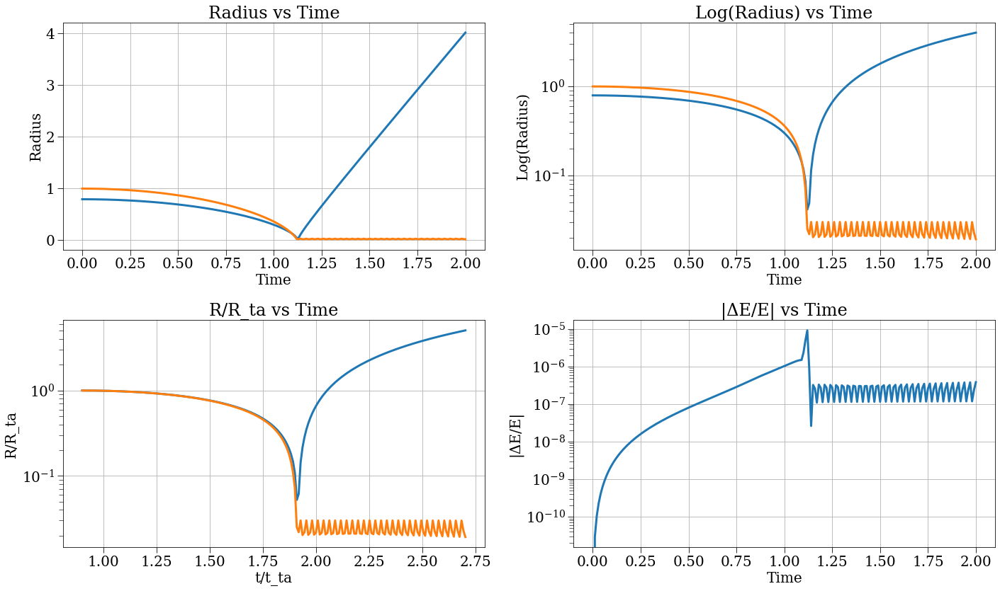

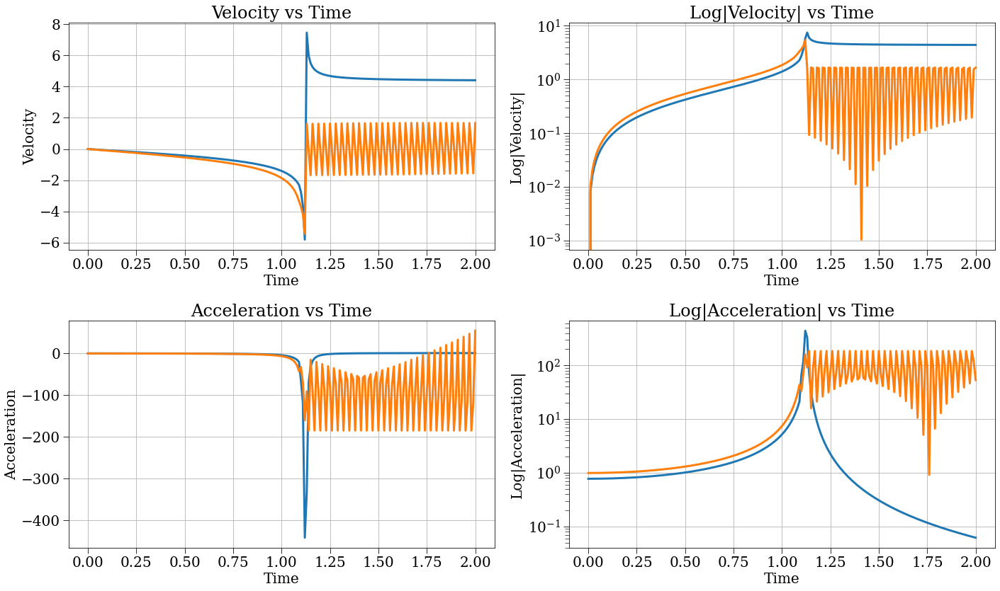

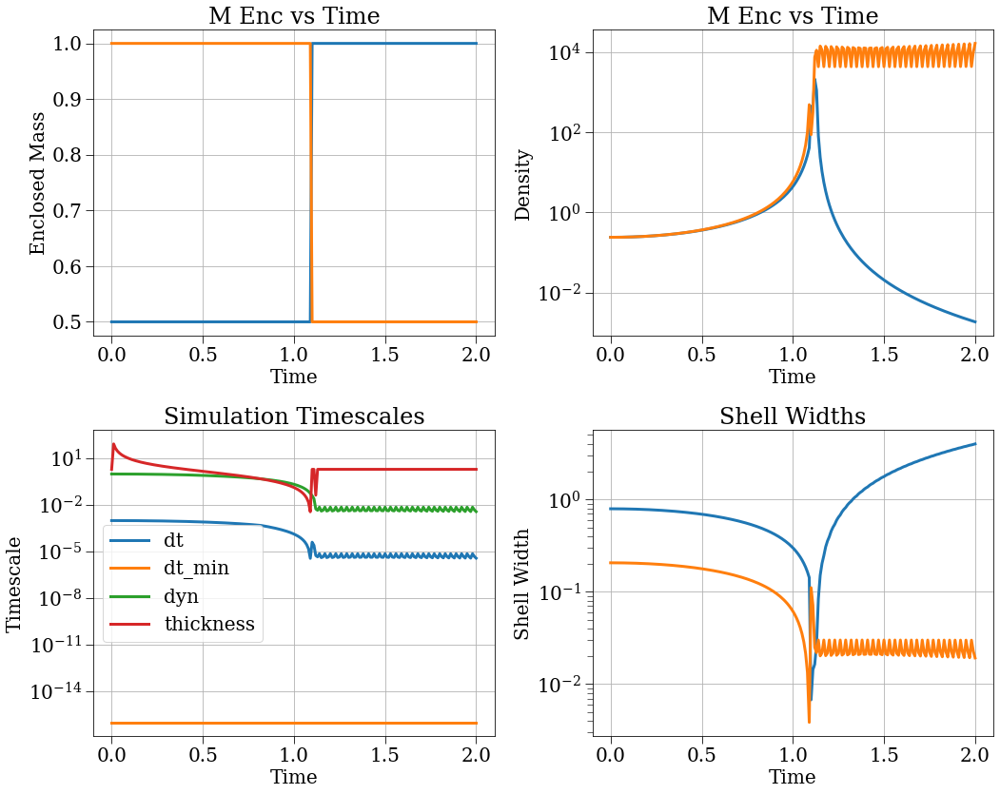

AxisError: axis 1 is out of bounds for array of dimension 1

In [78]:
t_max = 2
astrat = 'gas_vis_dis_fourpi'
astrat = 'soft_all'
config_tw = make_cycloid_config(N=2, reflect_bool=True, t_max=t_max, r_min=0, timescale_strategy='dyn_thickness', dt_min=1e-16, safety_factor=1e-3, pressure_strategy='polytrope', no_pm=False, polytropic_index=1.5, polytropic_coef=0, r_max=1, accel_strategy=astrat, delta_i=1/(4/3 * np.pi * rho_H) - 1, relaxation_time=0, energy_strategy='kin_grav_rot', H=0, save_dt=1e-2, drhodr_strategy='finite_diff', cq=0, stepper_strategy='velocity_verlet', j_coeff=1e-1, irs='equal_mass')

s, r, c = run_and_plot(config_tw, profile=False)
print(r['r'][0,:])

2025-03-06 00:54:56,614 - collapse - INFO - Simulation setup complete


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:145: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim(config.ylim)


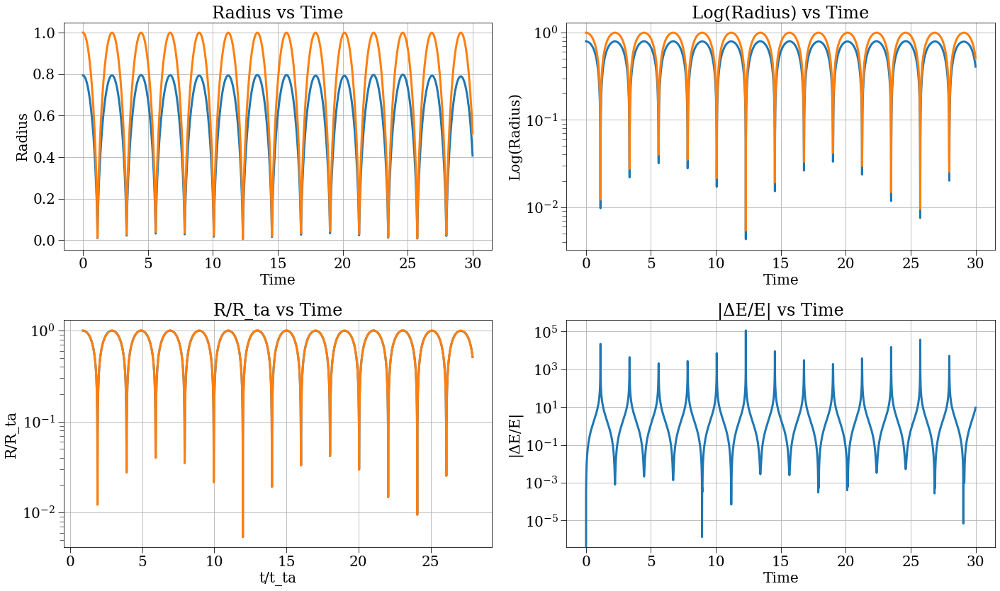

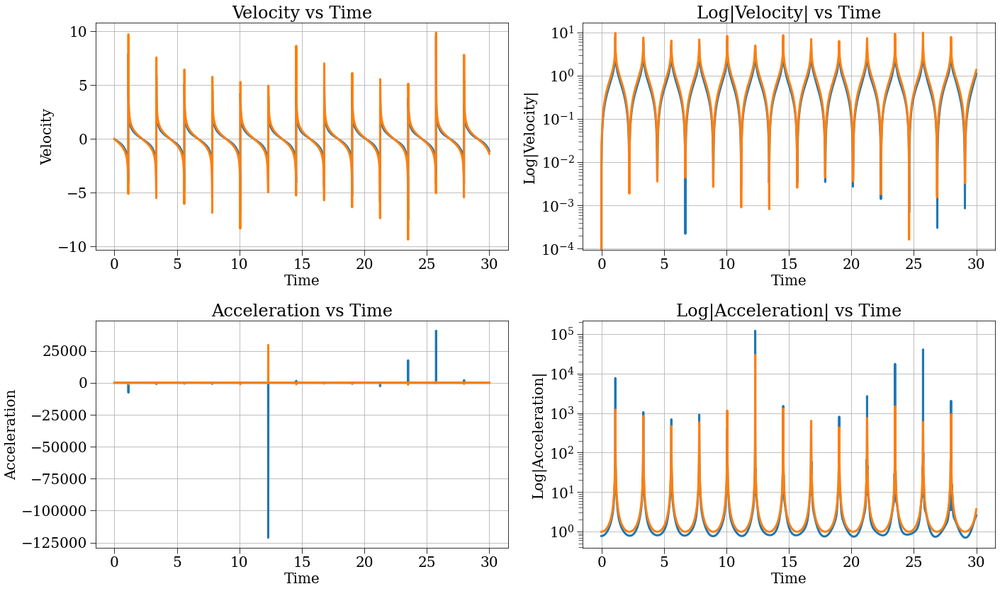

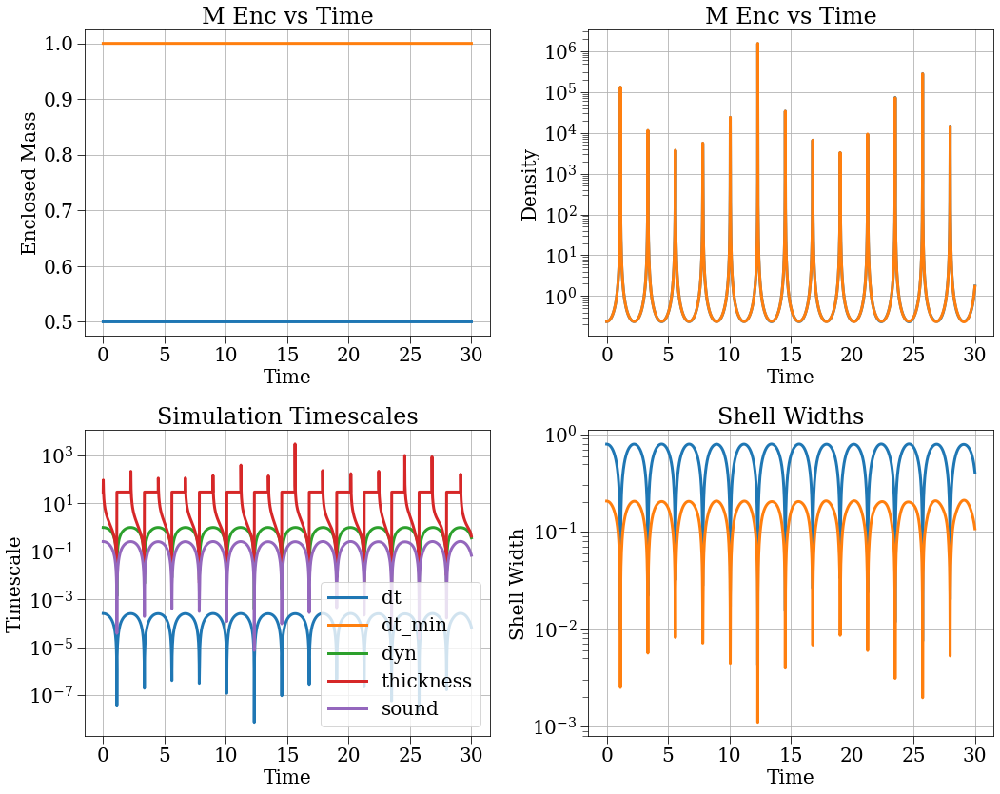

/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:104: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  ax.set_yscale(config.yscale)


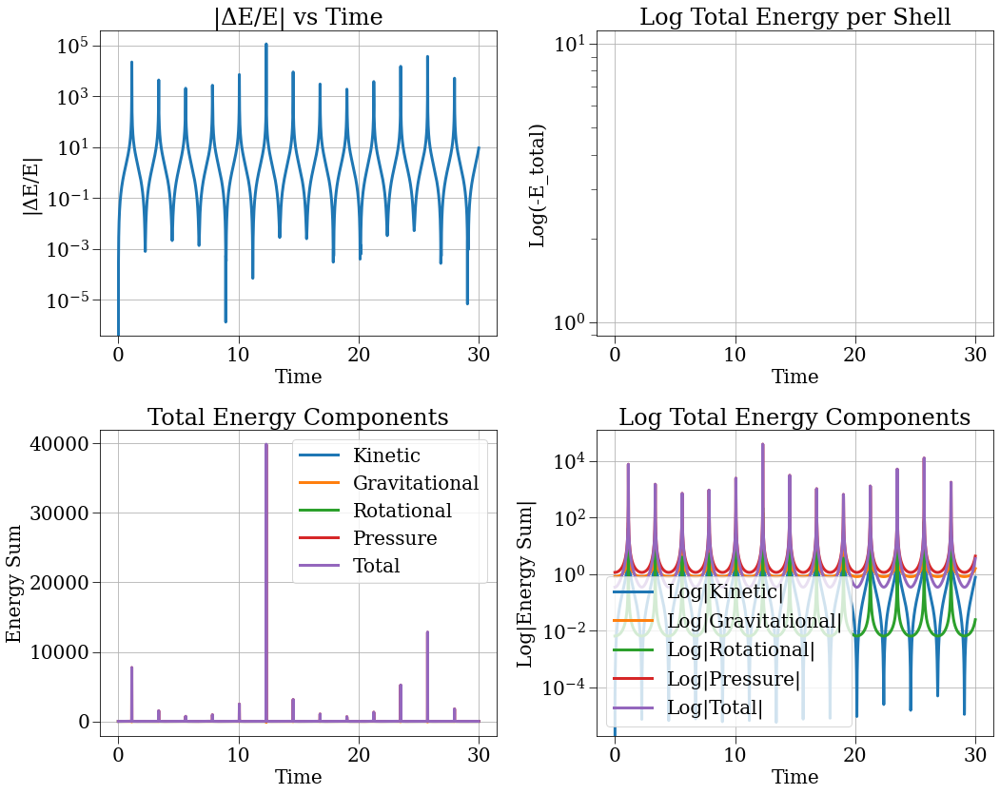

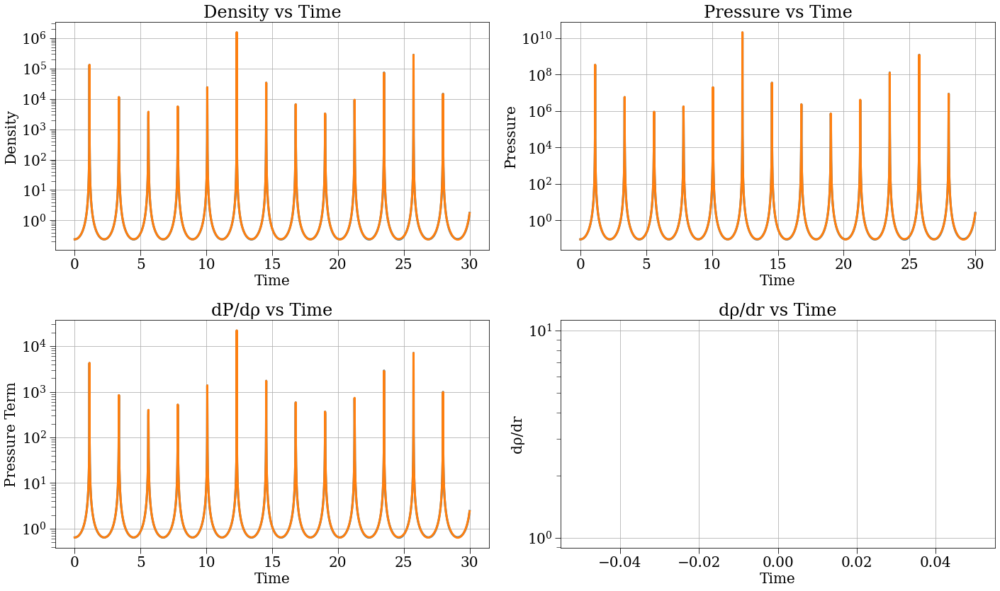

[0.79370051 1.        ]


In [70]:
s, r, c = run_and_plot(config_tw, profile=False)
print(r['r'][0,:])

In [20]:
s, r, c = run_and_plot(config_tw, profile=True)
print(r['r'][0,:])

2025-03-05 22:41:56,394 - collapse - INFO - Simulation setup complete


KeyboardInterrupt: 

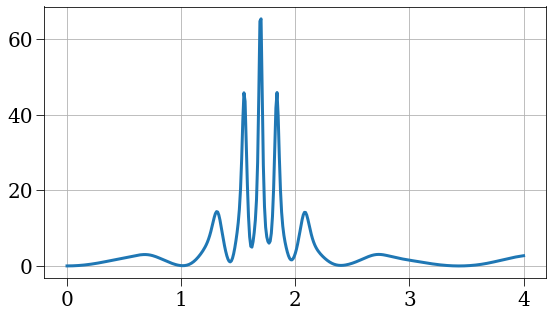

In [10]:
#4*np.pi*r**2 * dpressure/m
t = r['t']
rvals = r['r'][:,0]
mvals = r['m'][:,0]
pressurevals = r['pressure'][:,0]
pressurevals1 = r['pressure'][:,1]
dp = pressurevals1 - pressurevals
plt.plot(t, 4*np.pi*rvals**2 * dp/mvals)

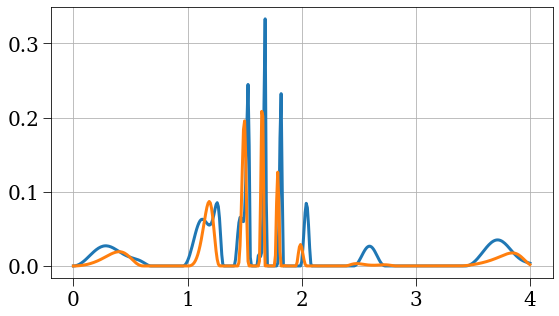

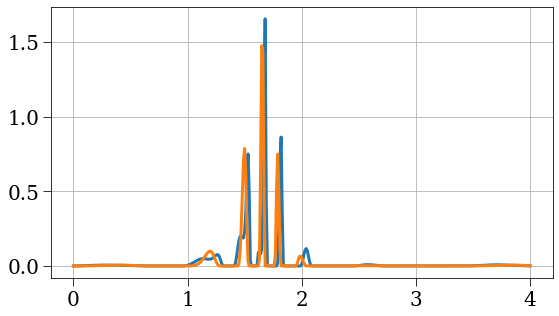

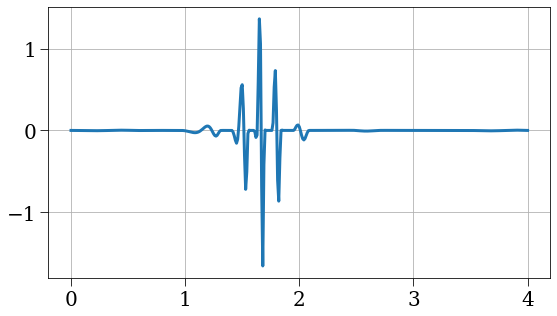

In [14]:
t = r['t']
rvals = r['r'][:,0]
mvals = r['m'][:,0]
vvals = r['v'][:,0]
vvals1 = r['v'][:,1]
vvals2 = r['v'][:,2]
rhovals = r['rho_r'][:,0]
rhovals1 = r['rho_r'][:,1]
dv = vvals1 - vvals
dv2 = vvals2 - vvals1
plt.plot(t, np.where(dv < 0, dv**2, 0))
plt.plot(t, np.where(dv2 < 0, dv2**2, 0))
plt.figure()
plt.plot(t, np.where(dv < 0, rhovals*dv**2, 0))
plt.plot(t, np.where(dv2 < 0, rhovals1*dv2**2, 0))
plt.figure()
plt.plot(t, -np.where(dv < 0, rhovals*dv**2, 0) + np.where(dv2 < 0, rhovals1*dv2**2, 0))


2025-03-02 22:22:48,934 - collapse - INFO - Simulation setup complete



         1280549916 function calls (1280534525 primitive calls) in 2310.782 seconds

   Ordered by: cumulative time
   List reduced from 387 to 50 due to restriction <50>

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1  211.423  211.423 2310.782 2310.782 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:242(run)
 13740739   69.643    0.000 1313.727    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/collapse.py:287(_update_simulation)
 13740739  140.684    0.000  774.987    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:460(__call__)
 13740739   73.684    0.000  396.242    0.000 /home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:1034(__call__)
 27481478   27.063    0.000  325.052    0.000 {built-in method numpy.core._mult

/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:145: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim(config.ylim)


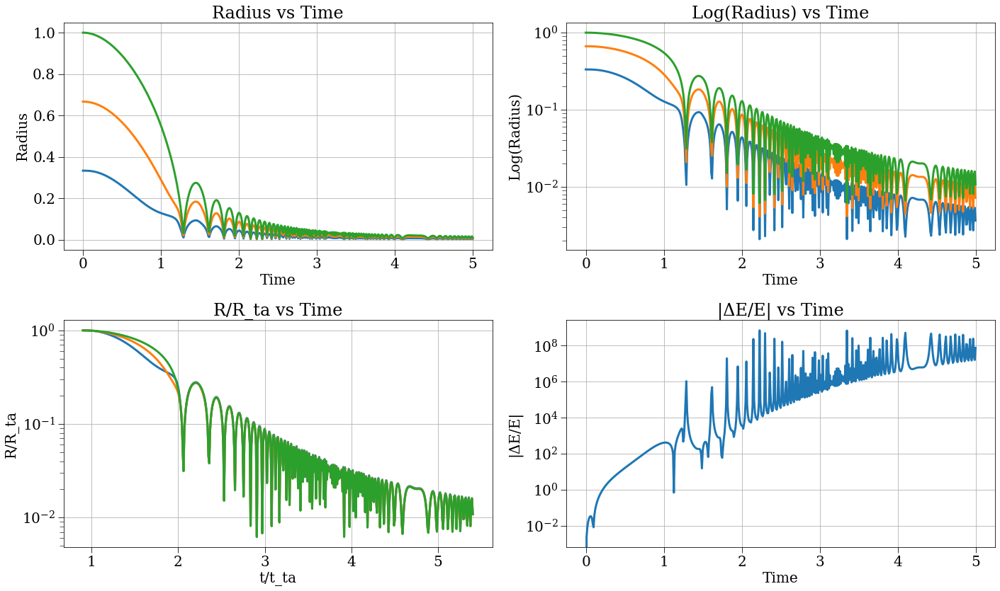

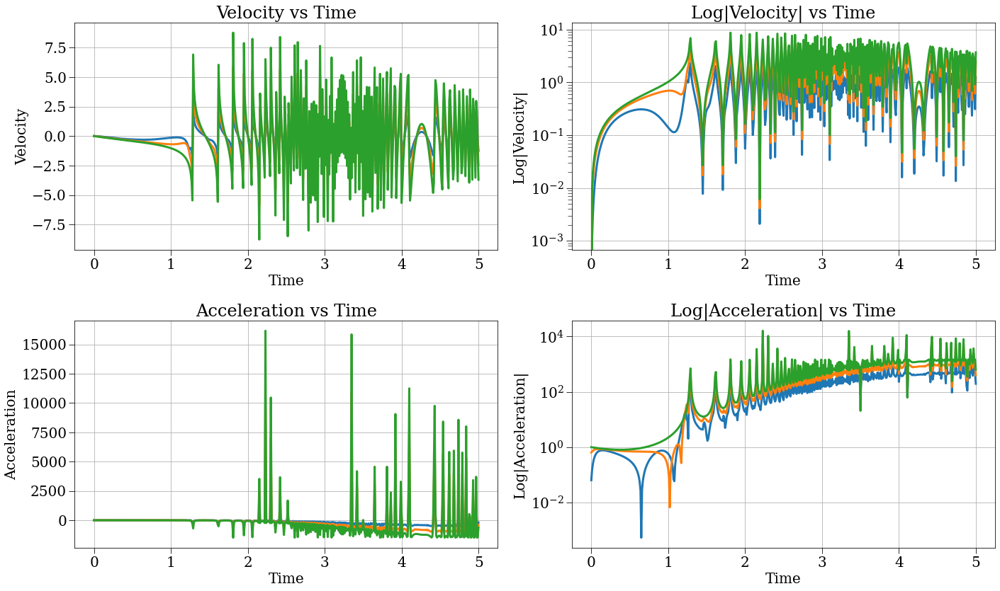

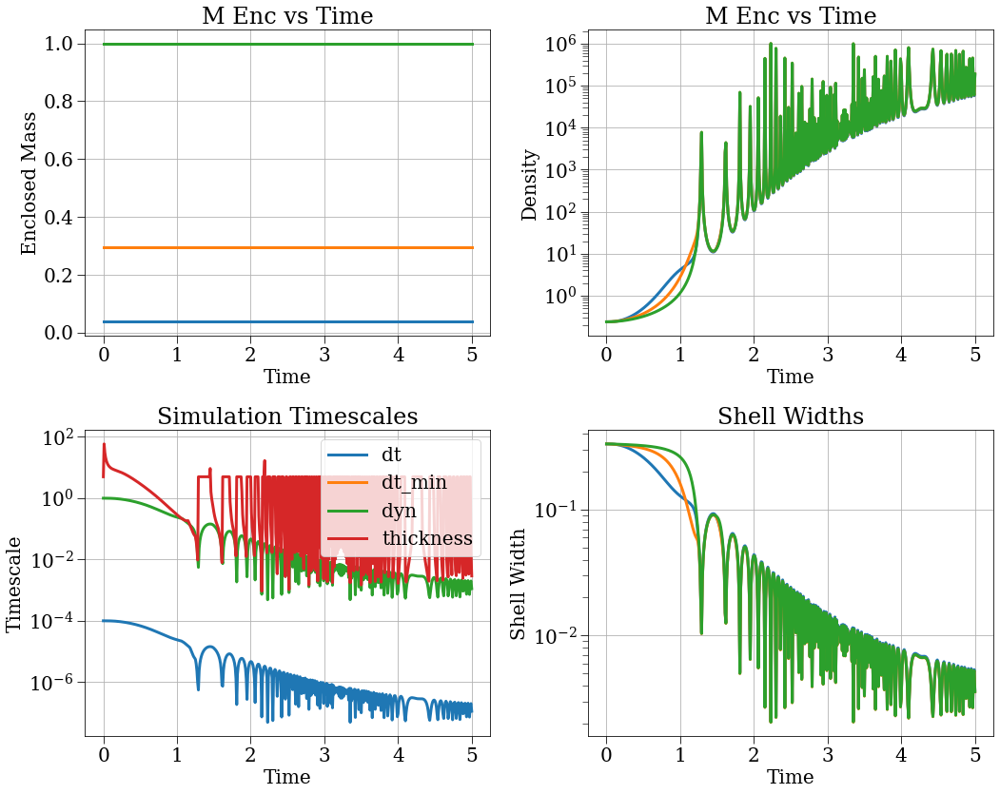

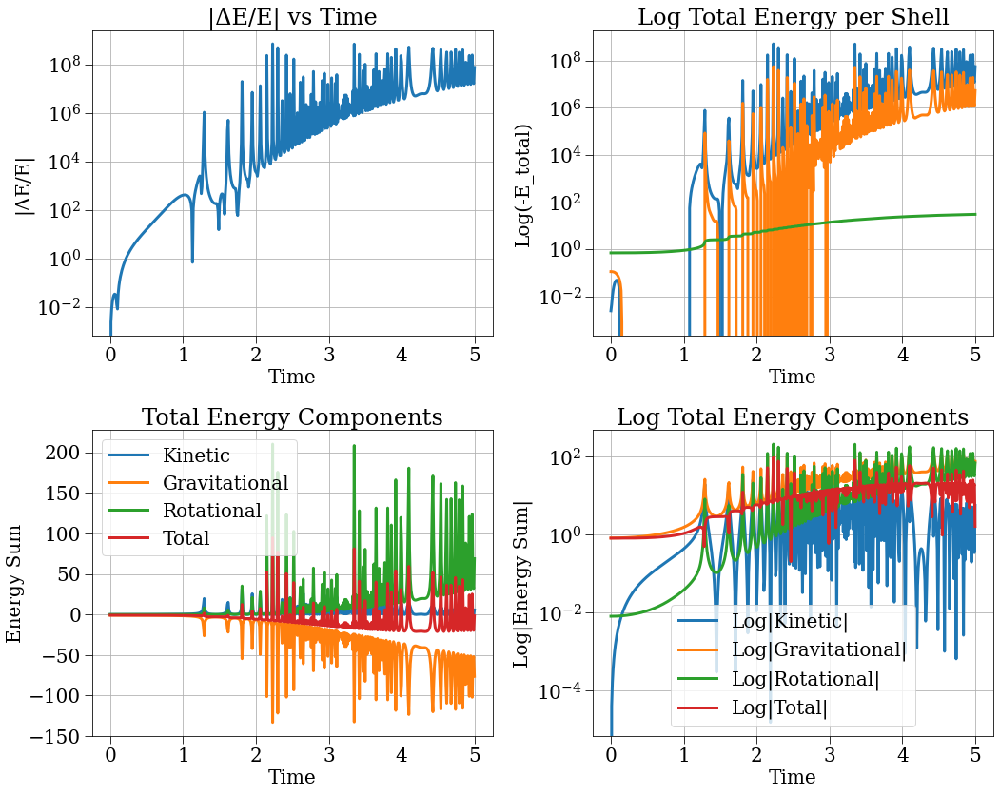

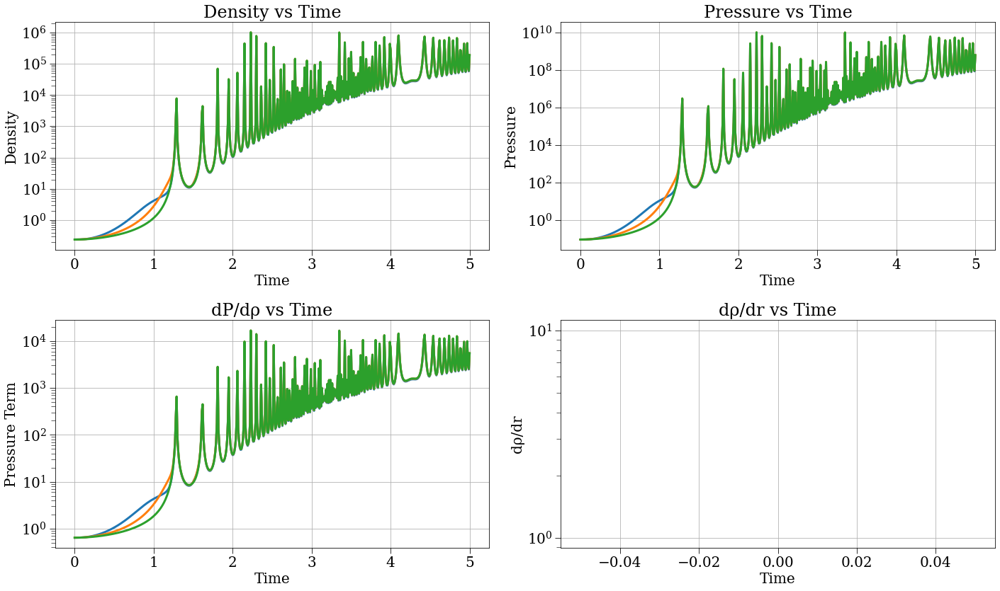

[0.33333333 0.66666667 1.        ]


In [12]:
s, r, c = run_and_plot(config_tw, profile=True)
print(r['r'][0,:])

2025-03-02 14:19:50,955 - collapse - INFO - Simulation setup complete


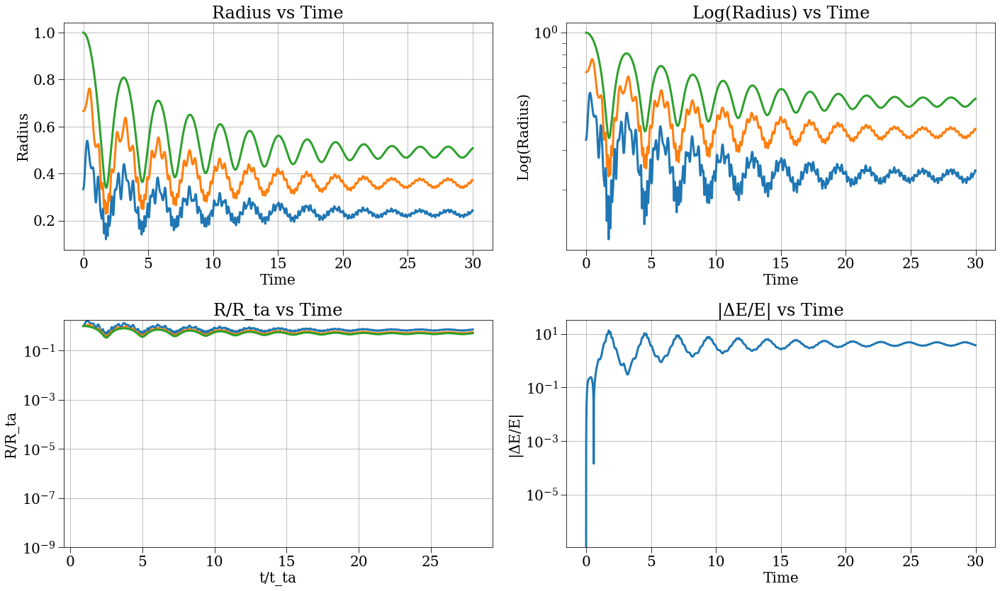

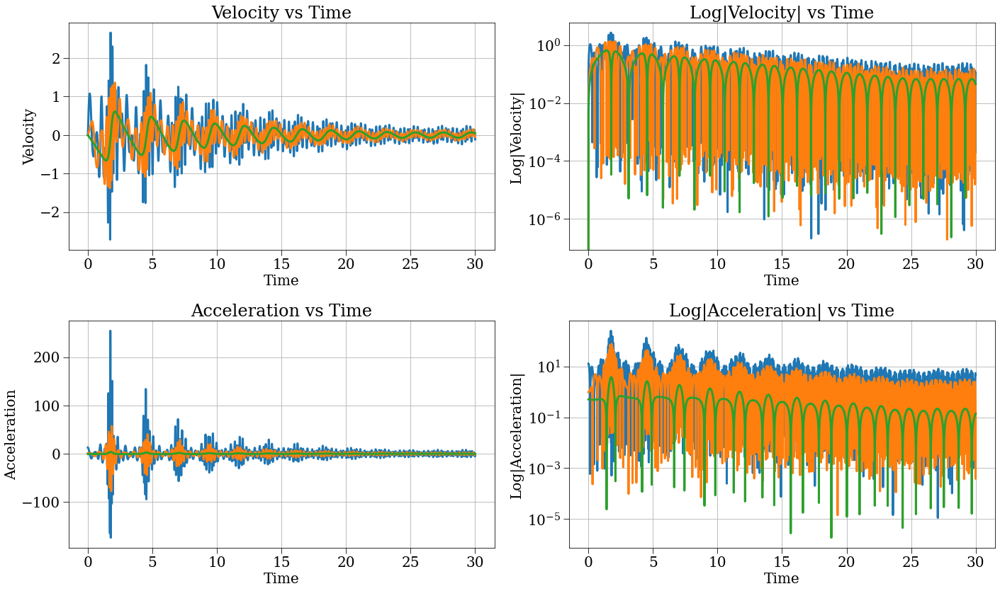

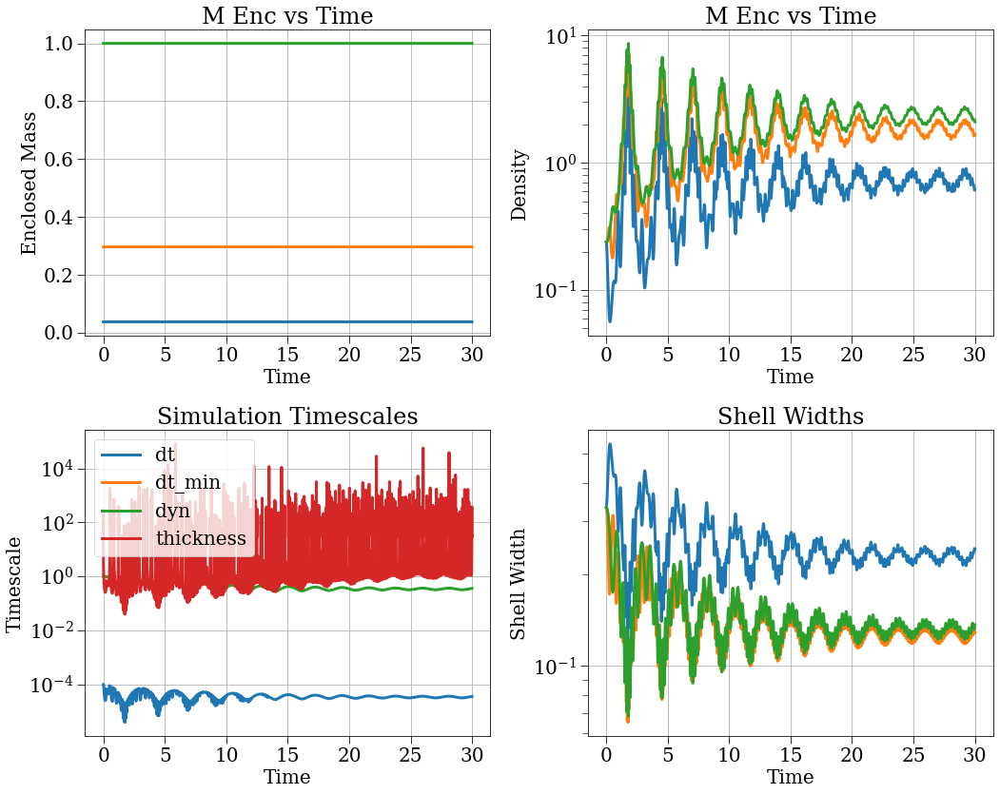

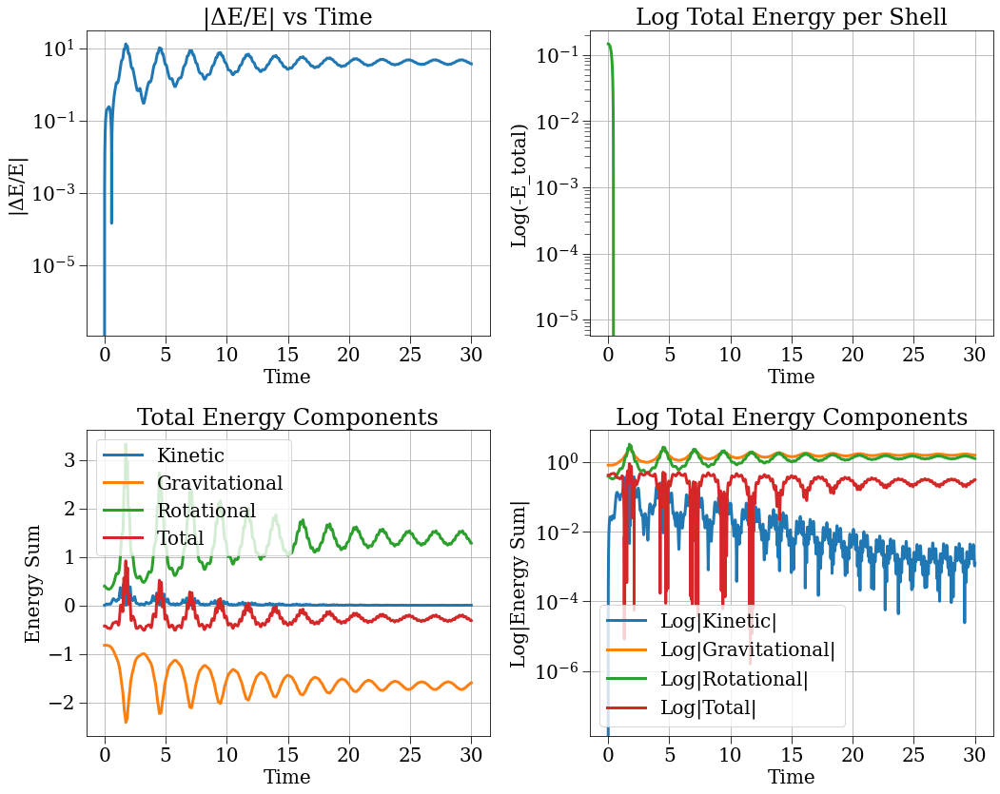

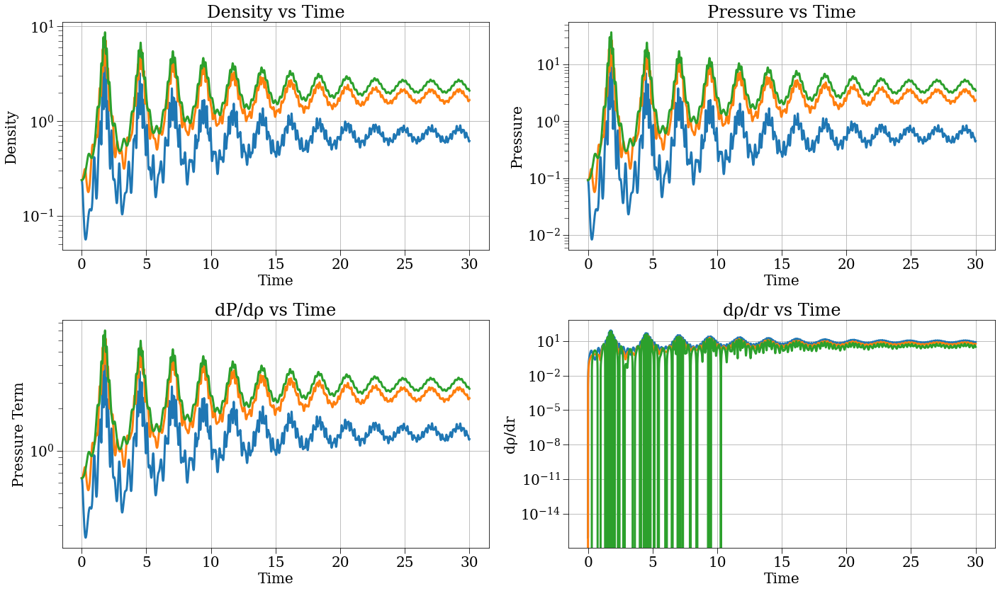

[0.33333333 0.66666667 1.        ]


In [63]:
s, r, c = run_and_plot(config_tw)
print(r['r'][0,:])

2025-03-02 14:11:56,399 - collapse - INFO - Simulation setup complete


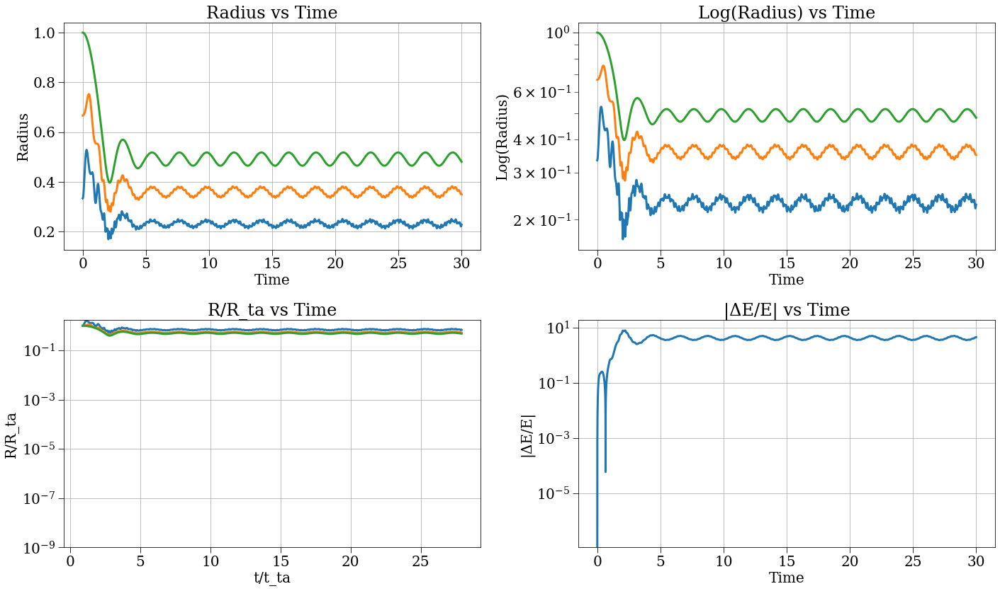

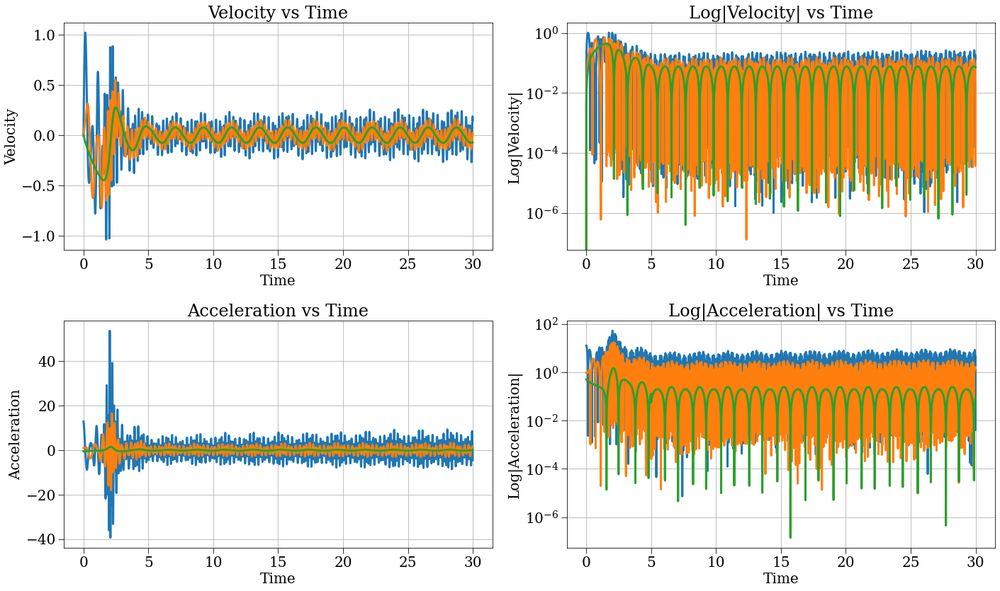

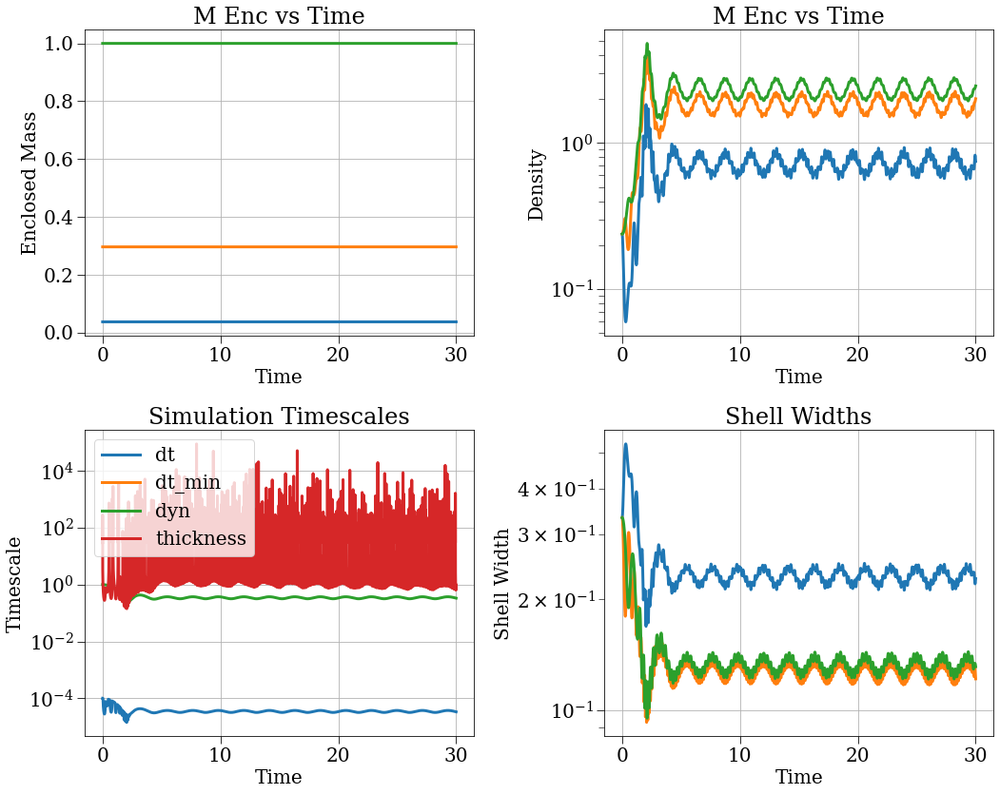

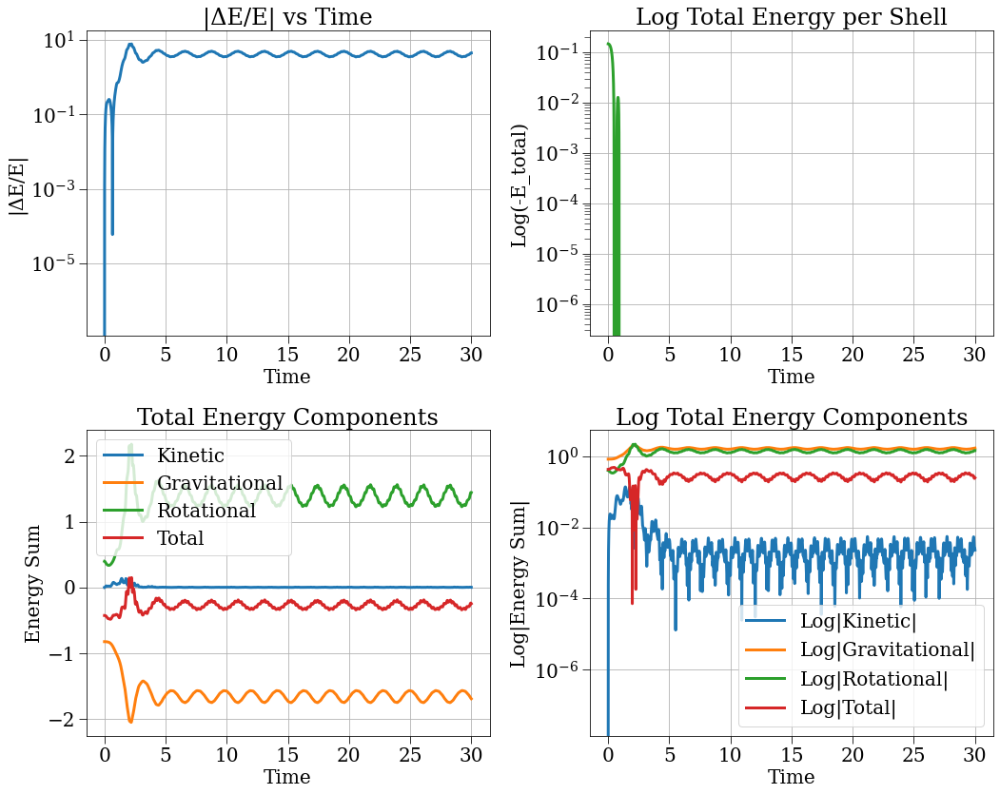

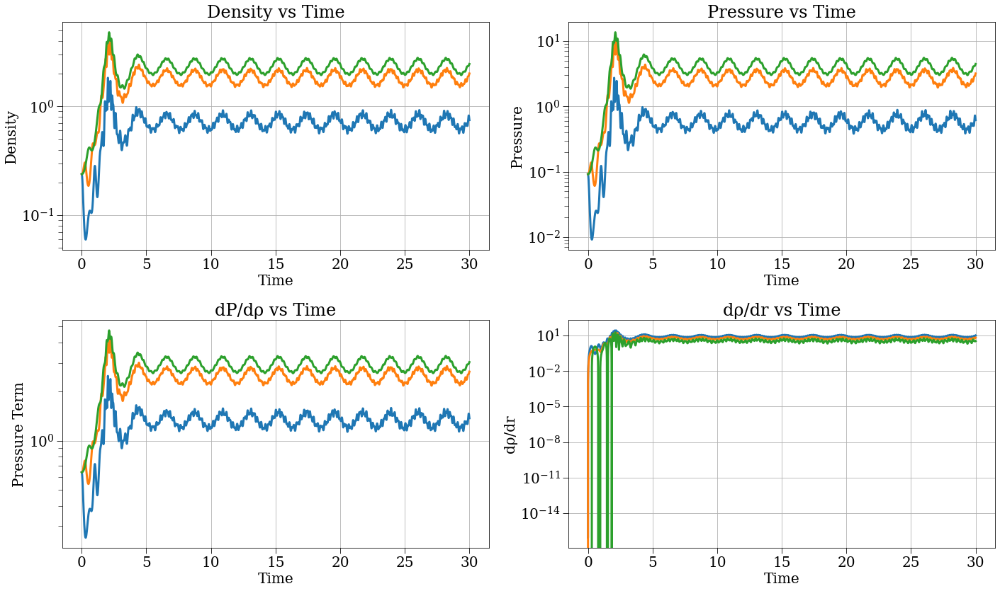

[0.33333333 0.66666667 1.        ]


In [61]:
s, r, c = run_and_plot(config_tw)
print(r['r'][0,:])

In [110]:
np.gradient([0, 1, 5])

array([1. , 2.5, 4. ])

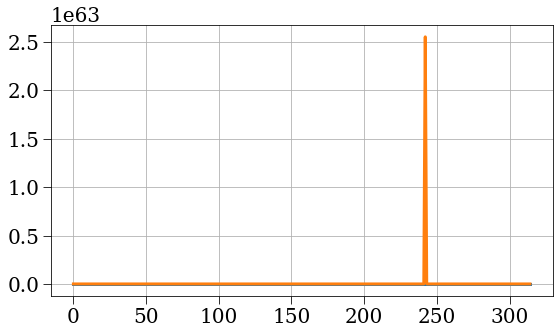

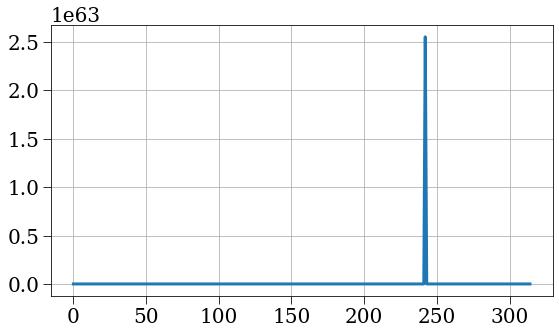

In [19]:
plt.plot(r['e_p'][:,0])
plt.plot(r['e_p'][:,1])
plt.figure()
plt.plot(np.abs(r['e_p'][:,0] - r['e_p'][:,1]))

In [5]:
print(s.rho_prime) #negative
print(s.dpressure_drho) # positive

[-2.13411791e-72 -1.80927563e-36 -1.73268684e-34]
[1.05917750e-39 1.52678327e-35 1.37723255e-11]


In [8]:
t_col = 9
t_buffer = 3
t_max = t_col * t_buffer

config1 = make_cycloid_config(N=1, reflect_bool=True, t_max=t_max, r_min=0.5, timescale_strategy='dyn', dt_min=1e-12, safety_factor=1e-4, irs='equal_mass', no_pm=True, r_max=1, mes='neighbor2')
config2 = make_cycloid_config(N=2, reflect_bool=True, t_max=t_max, r_min=0.5, timescale_strategy='dyn', dt_min=1e-12, safety_factor=1e-3, irs='equal_mass', no_pm=True, r_max=1, mes='neighbor2')
config10 = make_cycloid_config(N=10, reflect_bool=True, t_max=t_max, r_min=0.1, timescale_strategy='dyn', dt_min=1e-12, safety_factor=1e-4, irs='equal_mass', no_pm=True, r_max=1, mes='neighbor2',)
config10_outside = make_cycloid_config(N=10, reflect_bool=True, t_max=t_max, r_min=0.1, timescale_strategy='dyn', dt_min=1e-12, safety_factor=1e-4, irs='equal_mass', no_pm=True, r_max=1.1, mes='neighbor2',)
config30_outside = make_cycloid_config(N=30, reflect_bool=True, t_max=t_max, r_min=0.1, timescale_strategy='dyn', dt_min=1e-12, safety_factor=1e-4, irs='equal_mass', no_pm=True, r_max=1.1, mes='neighbor2',)

config1_2 = make_cycloid_config(N=1, reflect_bool=True, t_max=t_max, r_min=0.5, timescale_strategy='dyn', dt_min=1e-12, safety_factor=1e-3, irs='equal_mass', no_pm=True, r_max=1, mes='neighbor')
config2_2 = make_cycloid_config(N=2, reflect_bool=True, t_max=t_max, r_min=0.5, timescale_strategy='dyn', dt_min=1e-12, safety_factor=1e-3, irs='equal_mass', no_pm=True, r_max=1, mes='neighbor')
config10_2 = make_cycloid_config(N=10, reflect_bool=True, t_max=t_max, r_min=0.1, timescale_strategy='dyn', dt_min=1e-12, safety_factor=1e-4, irs='equal_mass', no_pm=True, r_max=1, mes='neighbor')
config100_2 = make_cycloid_config(N=100, reflect_bool=True, t_max=t_max, r_min=0.1, timescale_strategy='dyn', dt_min=1e-12, safety_factor=1e-4, irs='equal_mass', no_pm=True, r_max=1, mes='neighbor')
config1000_2 = make_cycloid_config(N=1000, reflect_bool=True, t_max=t_max, r_min=0.1, timescale_strategy='dyn', dt_min=1e-12, safety_factor=1e-4, irs='equal_mass', no_pm=True, r_max=1, mes='neighbor')

config10_outside_2 = make_cycloid_config(N=10, reflect_bool=True, t_max=t_max, r_min=0.1, timescale_strategy='dyn', dt_min=1e-12, safety_factor=1e-4, irs='equal_mass', no_pm=True, r_max=1.1, mes='neighbor')
config30_outside_2 = make_cycloid_config(N=30, reflect_bool=True, t_max=t_max, r_min=0.1, timescale_strategy='dyn', dt_min=1e-8, safety_factor=1e-4, irs='equal_mass', no_pm=True, r_max=1.3, mes='neighbor', r_th=1,)
config30_outside_2_dtmin = make_cycloid_config(N=30, reflect_bool=True, t_max=t_max, r_min=0.1, timescale_strategy='dyn', dt_min=1e-7, safety_factor=1e-6, irs='equal_mass', no_pm=True, r_max=1.3, mes='neighbor', r_th=1,)
config1000_outside_2 = make_cycloid_config(N=1000, reflect_bool=True, t_max=t_max, r_min=0.1, timescale_strategy='dyn', dt_min=1e-8, safety_factor=1e-4, irs='equal_mass', no_pm=True, r_max=1.3, mes='neighbor', r_th=1,)

config2000_outside_2 = make_cycloid_config(N=2000, reflect_bool=True, t_max=t_max, r_min=0.01, timescale_strategy='dyn', dt_min=1e-7, safety_factor=1e-4, irs='equal_mass', no_pm=True, r_max=1.01, mes='neighbor', r_th=1,)

config_pressure100 = make_cycloid_config(N=100, reflect_bool=True, t_max=t_max, r_min=1, timescale_strategy='dyn', dt_min=1e-12, safety_factor=1e-4, pressure_strategy='polytrope', irs='equal_mass', no_pm=True, polytropic_index=1, polytropic_coef=1e-4, r_max=2, accel_strategy='gas')

config_gaussian = make_cycloid_config(N=10, reflect_bool=True, t_max=t_max, r_min=0.1, timescale_strategy='dyn_thickness', dt_min=1e-12, safety_factor=1e-4, density_strategy='background_plus_gaussian', r_max=1, r_th=1, pressure_strategy='polytrope', polytropic_index=1.5, polytropic_coef=1, accel_strategy='gas')

In [11]:
s, r, c = run_and_plot(config_gaussian)
print(r['r'][0,:])

N 10 r [0.19 0.28 0.37 0.46 0.55 0.64 0.73 0.82 0.91 1.  ]
[0.02454212 0.06322141 0.12022247 0.19554529 0.28918989 0.40115625
 0.53144438 0.68005428 0.84698595 1.03223938]
[0.10422229 0.10210291 0.09931573 0.09598573 0.09225514 0.08827347
 0.08418769 0.08013356 0.07622878 0.07256826]


2025-02-11 18:07:07,815 - collapse - INFO - Simulation setup complete


KeyboardInterrupt: 

In [6]:
None.copy()

AttributeError: 'NoneType' object has no attribute 'copy'

In [66]:
print(4/3 * np.pi)
print(r['m_enc'][0,0])
print(r['m'][0,0])
print(rho_H * (1+1e-2))
print(4/3 * np.pi * r['r'][0,0]**3 * rho_H * (1+1e-2))
print(4/3 * np.pi * r['r'][0,0]**3 * rho_H * (1 + 1e-2 * np.exp(-(1 / 1e10)**2)))

4.1887902047863905
0.22444444444444442
0.22444444444444442
0.05358216417427143
0.22444444444444445
0.22444444444444445


In [17]:
print(4/3 * np.pi)
print(r['m_enc'][0,0])
print(r['m'][0,0])
print(rho_H * (1+1e-2))
print(4/3 * np.pi * r['r'][0,0]**3 * rho_H * (1+1e-2))
print(4/3 * np.pi * r['r'][0,0]**3 * rho_H * (1 + 1e-2 * np.exp(-(1 / 1e10)**2)))

4.1887902047863905
0.22303973209149208
0.22303973209149208
0.05358216417427143
0.22444444444444445
0.22444444444444445


In [4]:
s, r, c = run_and_plot(config2000_outside_2)
print(r['r'][0,:])

N 5000 r [0.05877421 0.07405087 0.08476708 ... 1.00973456 1.0098673  1.01      ]
[0.00085045 0.00085045 0.00085045 ... 0.0017009  0.0017009  0.0017009 ]
[0.1061033  0.1061033  0.1061033  ... 0.05305165 0.05305165 0.05305165]


2025-02-11 23:54:22,979 - collapse - INFO - Simulation setup complete


: 

: 

: 

2025-02-13 02:54:15,957 - collapse - INFO - Simulation setup complete


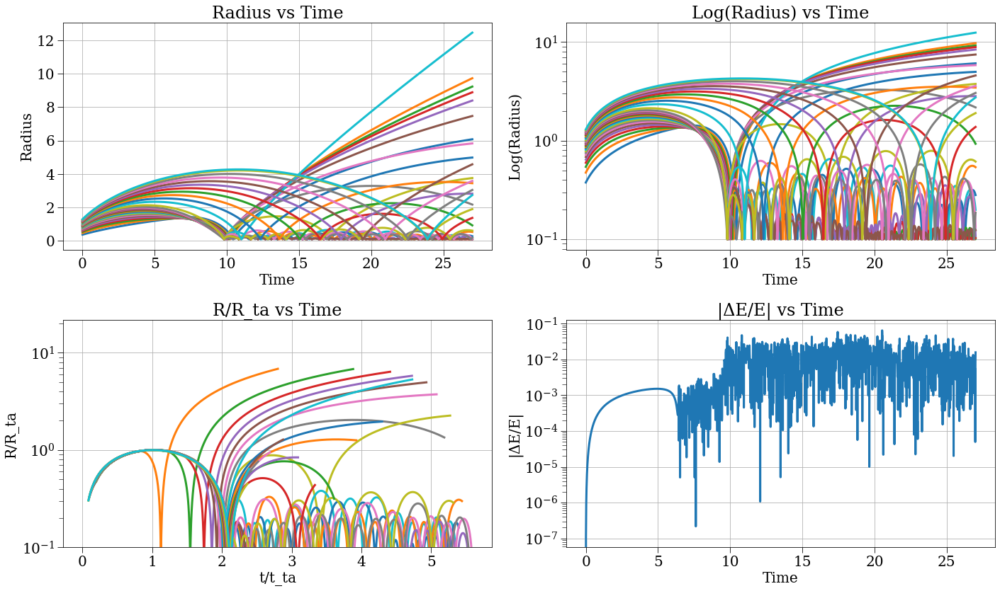

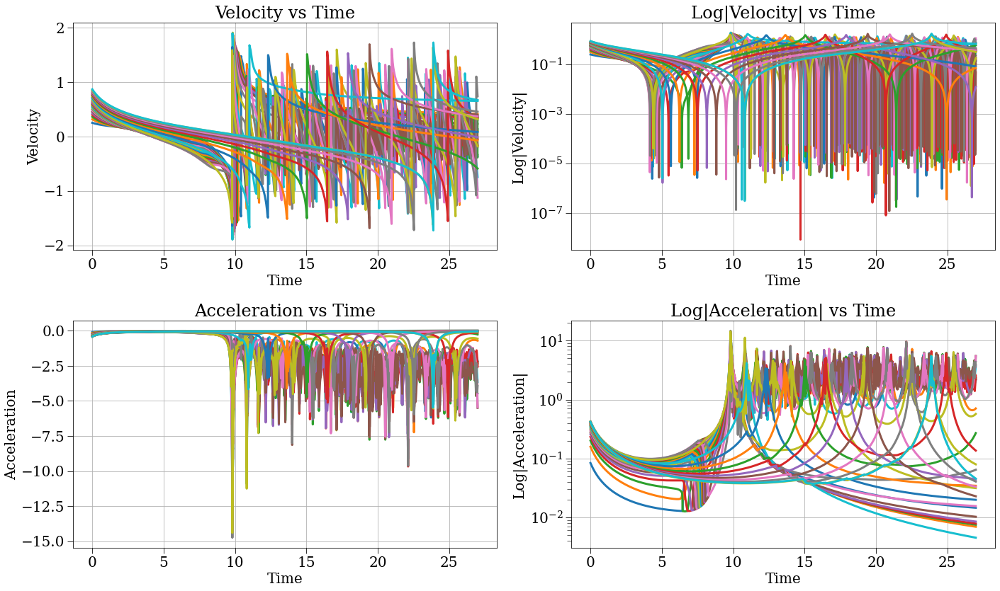

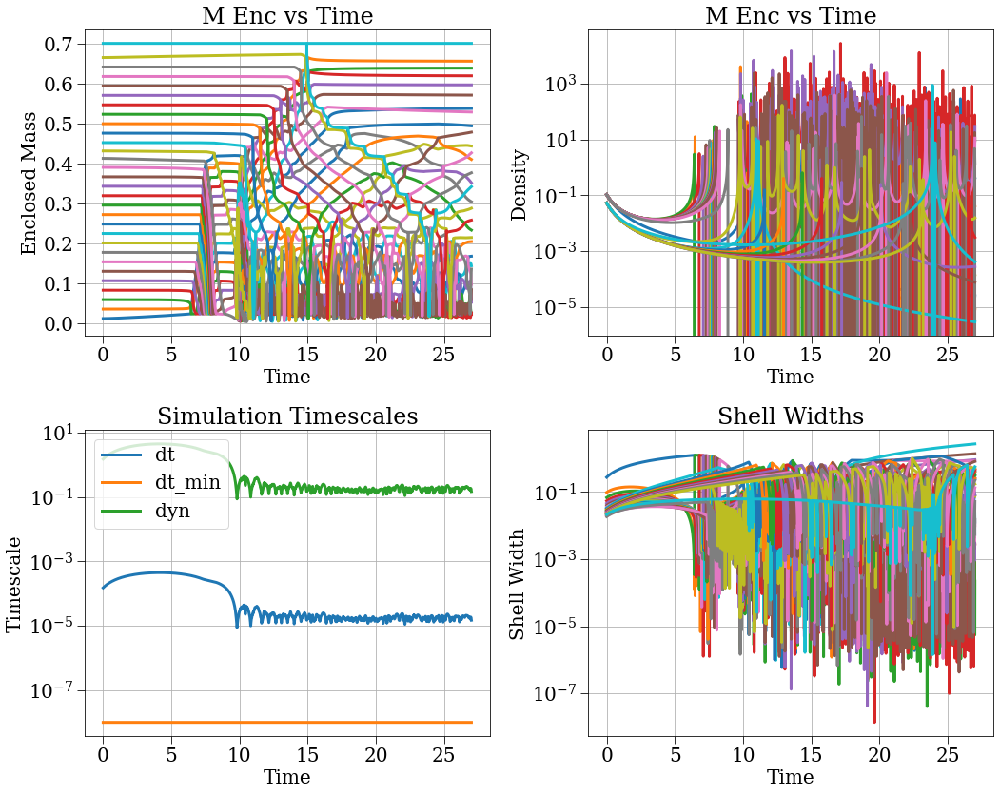

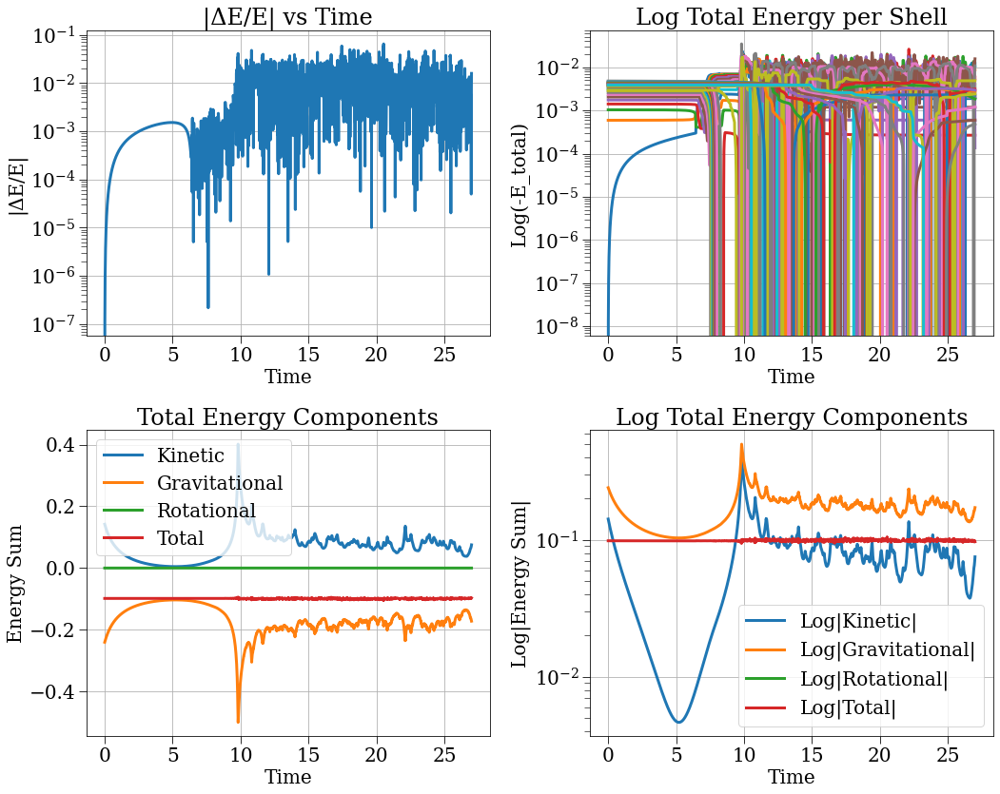

[0.37629851 0.47410641 0.54271637 0.59733665 0.6434614  0.68377977
 0.71983316 0.75259702 0.78273244 0.81071057 0.8368804  0.86150853
 0.88480374 0.90693294 0.92803193 0.94821283 0.96756943 0.98618108
 1.00818291 1.04198534 1.07372634 1.1036941  1.13211727 1.1591807
 1.18503621 1.20981017 1.23360905 1.25652348 1.27863132 1.3       ]


In [4]:
s, r, c = run_and_plot(config30_outside_2)
print(r['r'][0,:])

In [ ]:
s, r, c = run_and_plot(config30_outside_2_dtmin)
print(r['r'][0,:])

2025-02-13 04:03:35,373 - collapse - INFO - Simulation setup complete


In [3]:
s, r, c = run_and_plot(config1000_outside_2)
print(r['r'][0,:])

NameError: name 'config1000_outside_2' is not defined

2025-02-12 00:08:28,955 - collapse - INFO - Simulation setup complete


N 30 r [0.33007179 0.41586439 0.47604589 0.5239563  0.56441482 0.59978024
 0.63140462 0.66014358 0.68657699 0.71111811 0.73407309 0.75567575
 0.77610925 0.79551997 0.81402703 0.83172879 0.84870751 0.8650328
 0.8807641  0.89595268 0.91064304 0.92487413 0.93868026 0.95209179
 0.96513576 0.97783637 0.99021536 1.00457344 1.02778866 1.05      ]
[0.15063081 0.15063082 0.15063082 0.15063082 0.15063082 0.15063082
 0.15063082 0.15063082 0.15063082 0.15063082 0.15063082 0.15063082
 0.15063082 0.15063082 0.15063082 0.15063082 0.15063082 0.15063082
 0.15063082 0.15063082 0.15063082 0.15063082 0.15063082 0.15063082
 0.15063082 0.15063082 0.15063082 0.17949298 0.30126163 0.30126163]
[0.1061033  0.1061033  0.1061033  0.1061033  0.1061033  0.1061033
 0.1061033  0.1061033  0.1061033  0.1061033  0.1061033  0.1061033
 0.1061033  0.1061033  0.1061033  0.1061033  0.1061033  0.1061033
 0.1061033  0.1061033  0.1061033  0.1061033  0.1061033  0.1061033
 0.1061033  0.1061033  0.1061033  0.05305165 0.05305165 0.

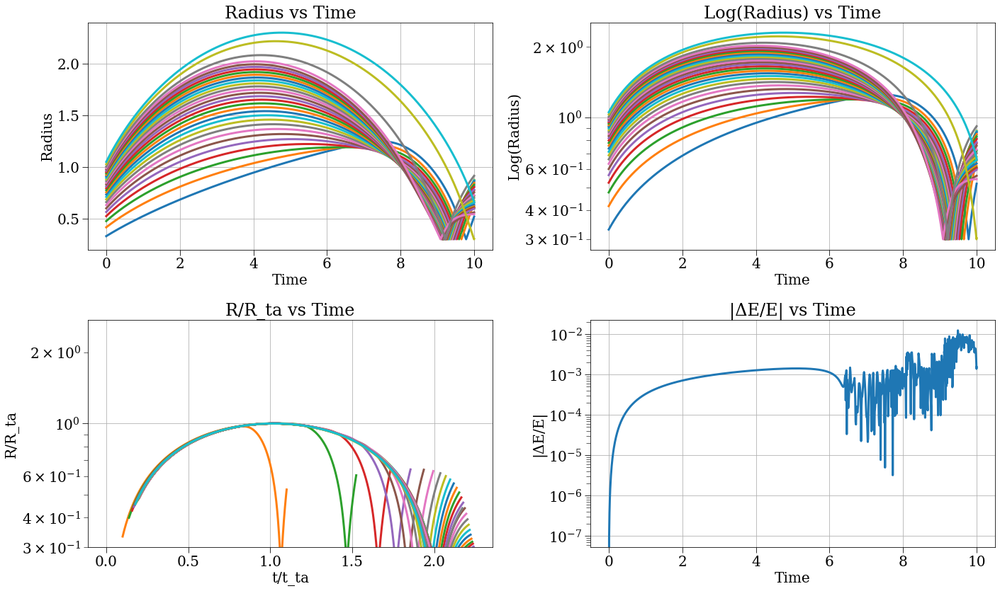

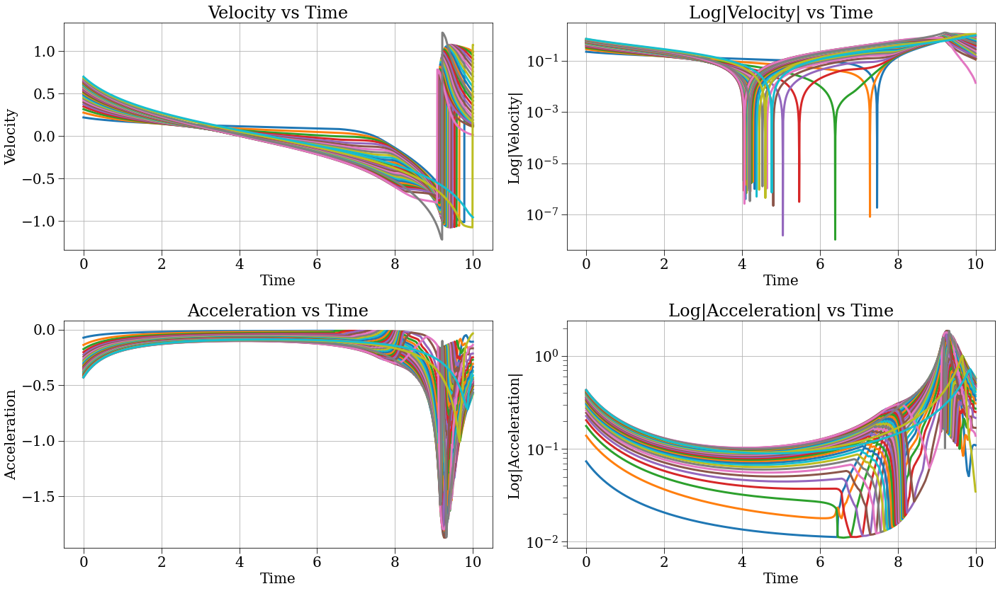

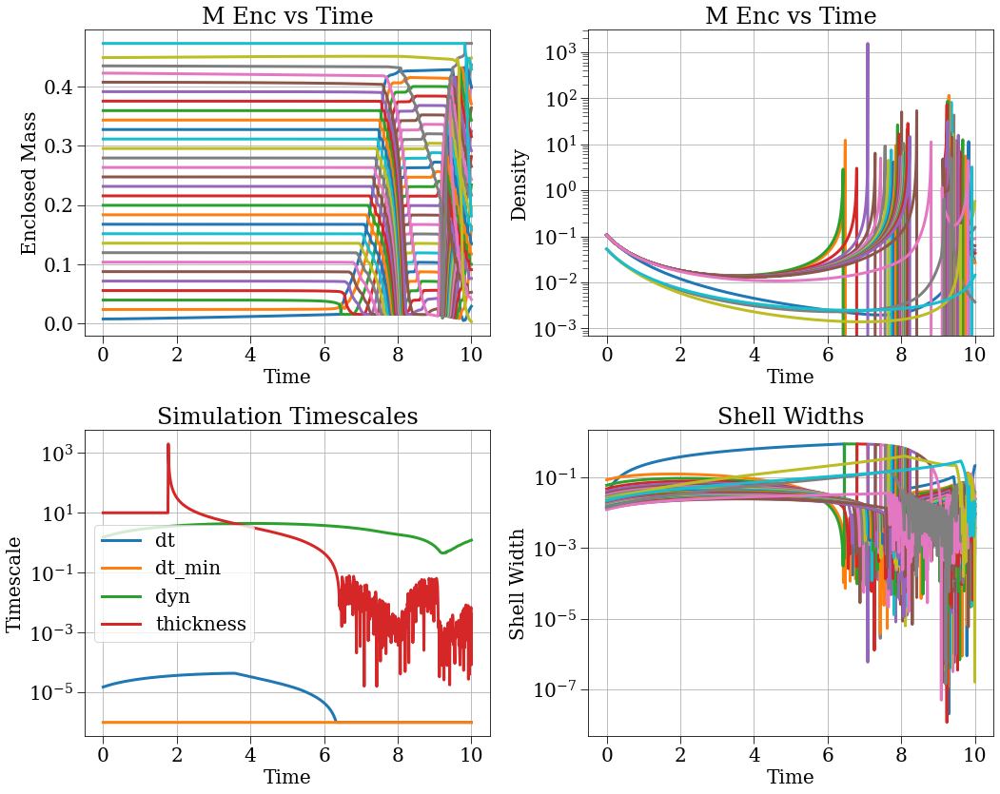

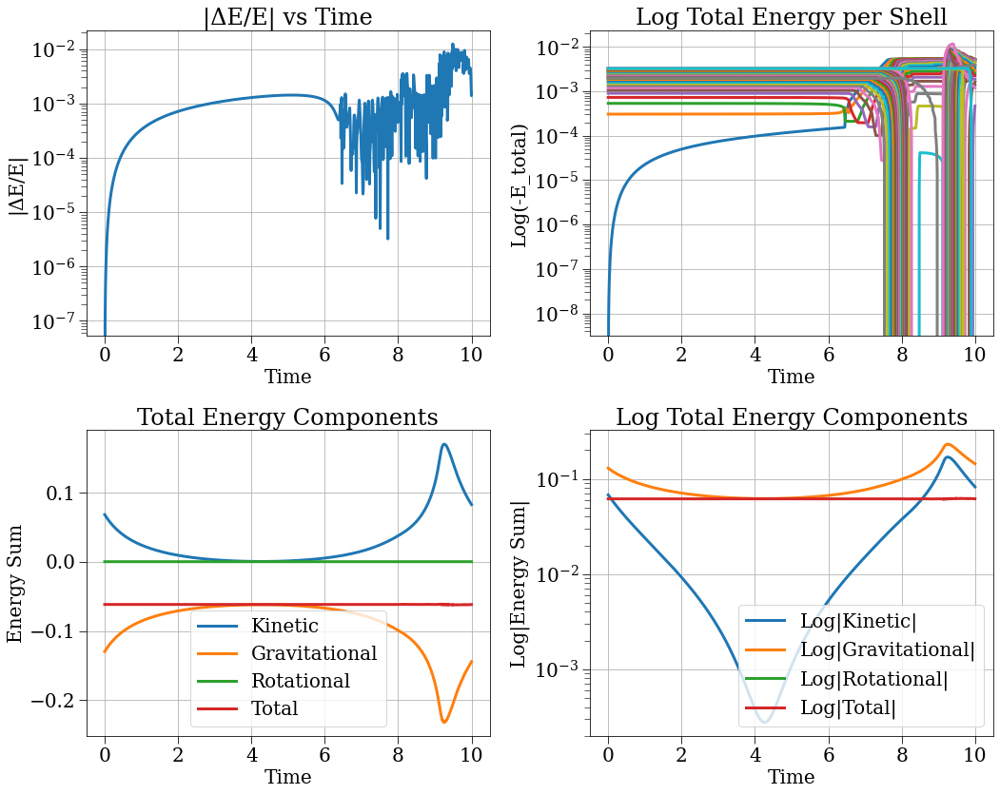

[0.33007179 0.41586439 0.47604589 0.5239563  0.56441482 0.59978024
 0.63140462 0.66014358 0.68657699 0.71111811 0.73407309 0.75567575
 0.77610925 0.79551997 0.81402703 0.83172879 0.84870751 0.8650328
 0.8807641  0.89595268 0.91064304 0.92487413 0.93868026 0.95209179
 0.96513576 0.97783637 0.99021536 1.00457344 1.02778866 1.05      ]


In [ ]:
s, r, c = run_and_plot(config30_outside_2)
print(r['r'][0,:])

Plotting 444 shells out of 2000 total shells


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:188: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  plt.tight_layout()


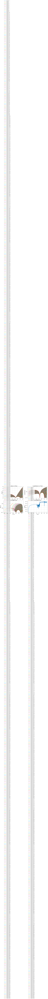

/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:188: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  plt.tight_layout()


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:473: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  plt.tight_layout()


/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/plotting.py:565: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  plt.tight_layout()


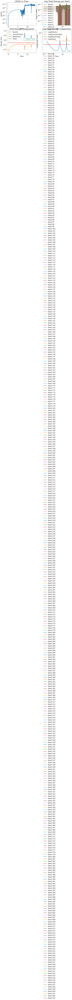

In [15]:
# Get initial radii and find indices where r0 <= 1
r0 = r['r'][0,:]
shell_indices = np.where(r0 <= 1)[0]
print(f"Plotting {len(shell_indices)} shells out of {len(r0)} total shells")

# Create a plot config with these specific shell indices
shell_config = PlotConfig(
    property_name='',  # This is a placeholder, each plot will set its own
    shell_indices=shell_indices
)

# Create new plots with only the filtered shells
c.plot_radius_analysis(shell_config=shell_config)
c.plot_velocity_acceleration(shell_config=shell_config)
c.plot_mass_density_timescales(shell_config=shell_config)
c.plot_energy_analysis(shell_config=shell_config)

In [5]:
r0 = r['r'][0,:]
v0 = r['v'][0,:]
menc0 = r['m_enc'][0,:]
m0 = r['m'][0,:]
e0 = r['e_tot'][0,:]/m0
rta = s.r_ta
print(rta)
print(menc0/e0)
print(menc0/(menc0/r0 + v0**2/2))

[5.20538401e+07 1.84634248e+00 1.76127877e+00 1.80930225e+00
 1.87940420e+00 1.95278354e+00 2.02459949e+00 2.12182949e+00
 2.38687163e+00 2.67013767e+00]
[ 5.20538393e+07 -1.84634248e+00 -1.76127877e+00 -1.80930225e+00
 -1.87940420e+00 -1.95278354e+00 -2.02459949e+00 -2.12182949e+00
 -2.38687163e+00 -2.67013767e+00]
[0.2442405  0.36926849 0.44031969 0.49344607 0.53697263 0.5743481
 0.60737985 0.63456965 0.65800539 0.69267941]


2025-01-30 01:48:16,443 - collapse - INFO - Simulation setup complete


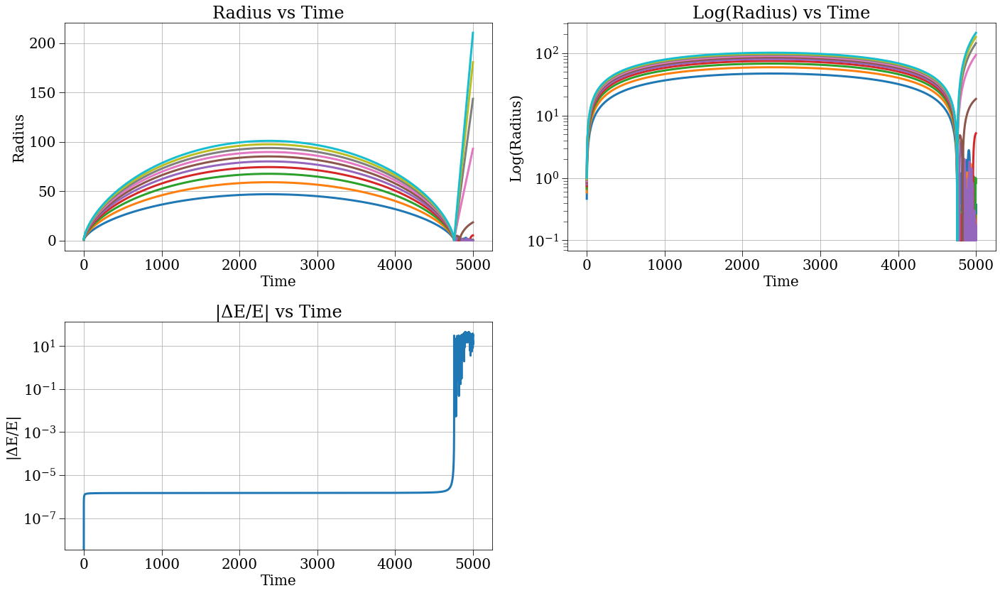

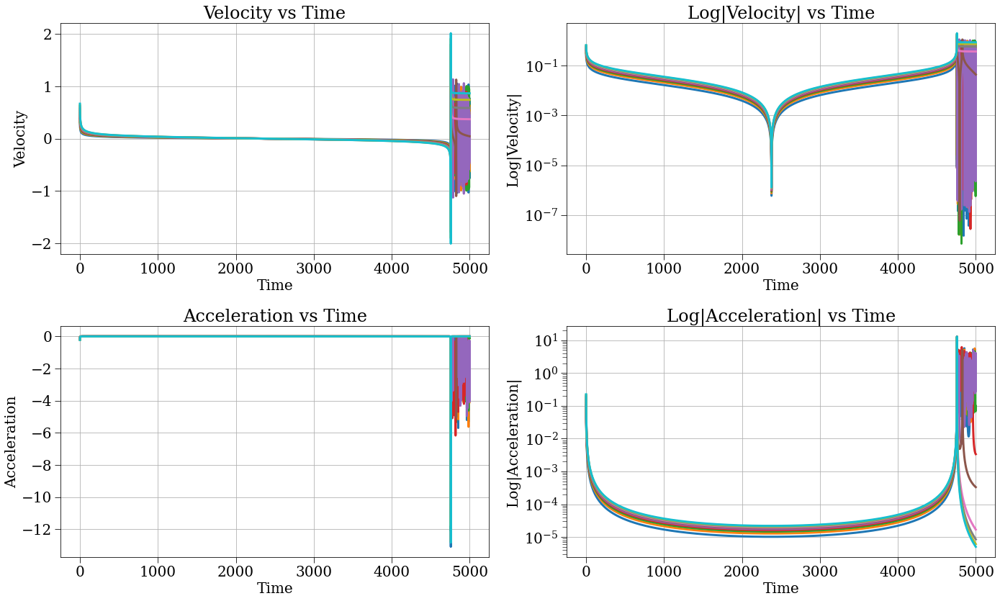

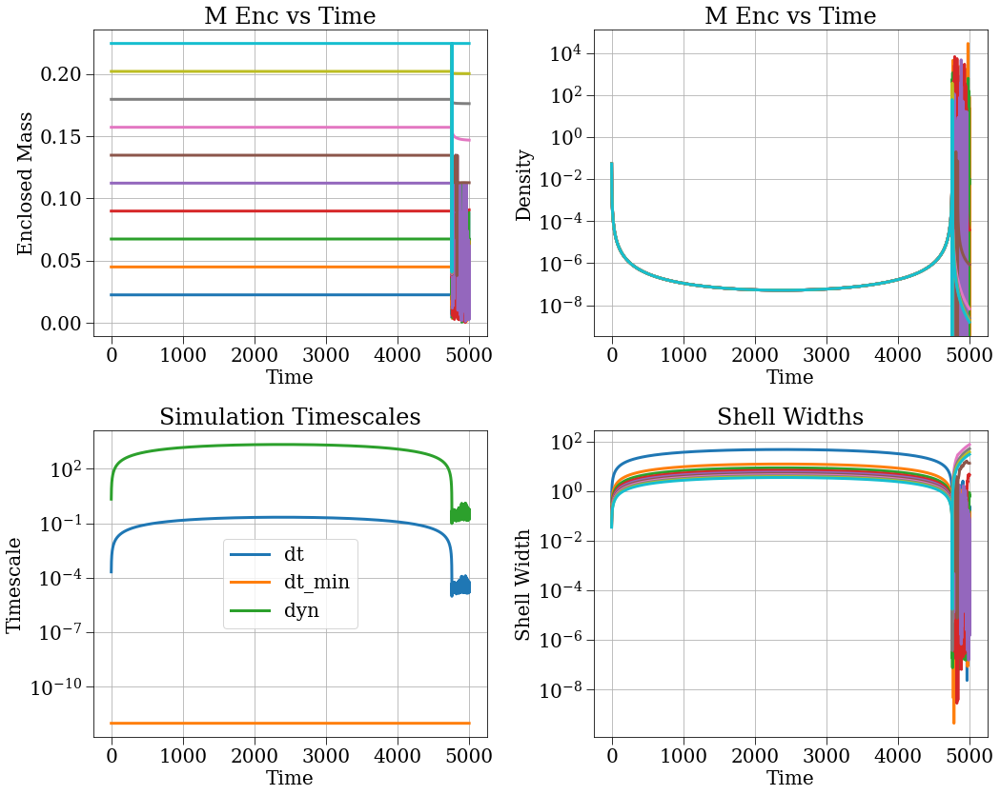

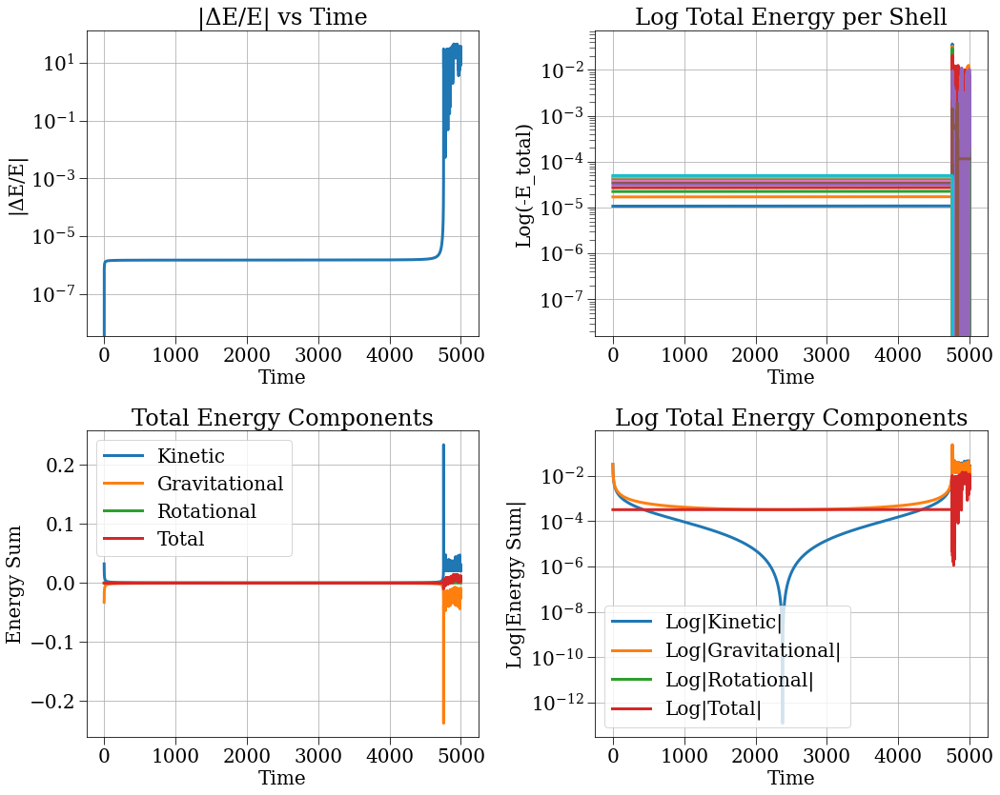

[0.46415888 0.58480355 0.66943295 0.7368063  0.79370053 0.84343266
 0.887904   0.92831777 0.96548938 1.        ]


In [6]:
s, r, c = run_and_plot(config10)
print(r['r'][0,:])

In [7]:
print(r['m'][0,:])
print(r['m_enc'][0,:])

[0.02244444 0.02244444 0.02244444 0.02244444 0.02244444 0.02244444
 0.02244444 0.02244444 0.02244444 0.02244444]
[0.02244444 0.04488889 0.06733333 0.08977778 0.11222222 0.13466667
 0.15711111 0.17955556 0.202      0.22444444]


2025-01-30 09:05:03,835 - collapse - INFO - Simulation setup complete


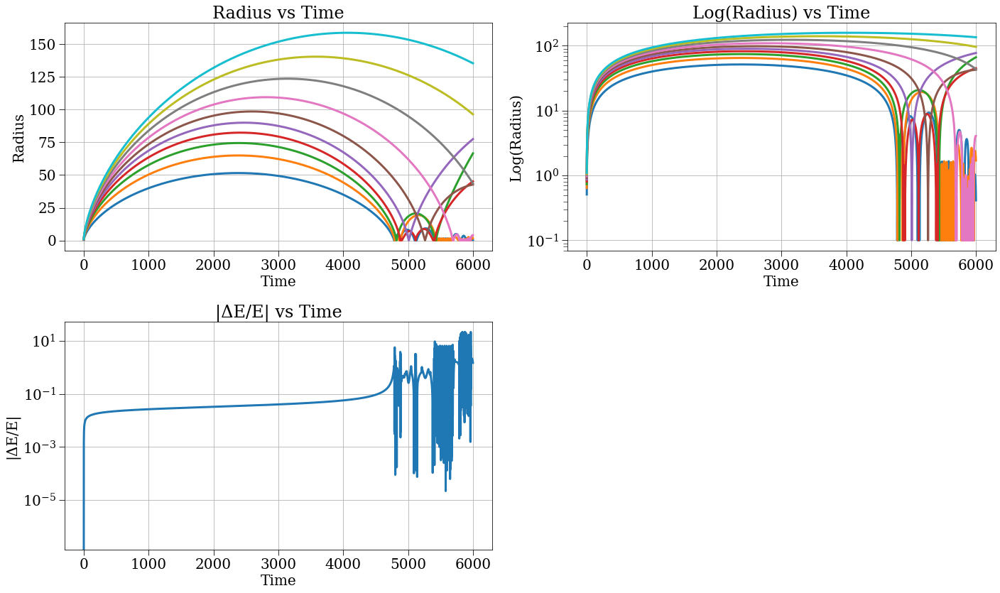

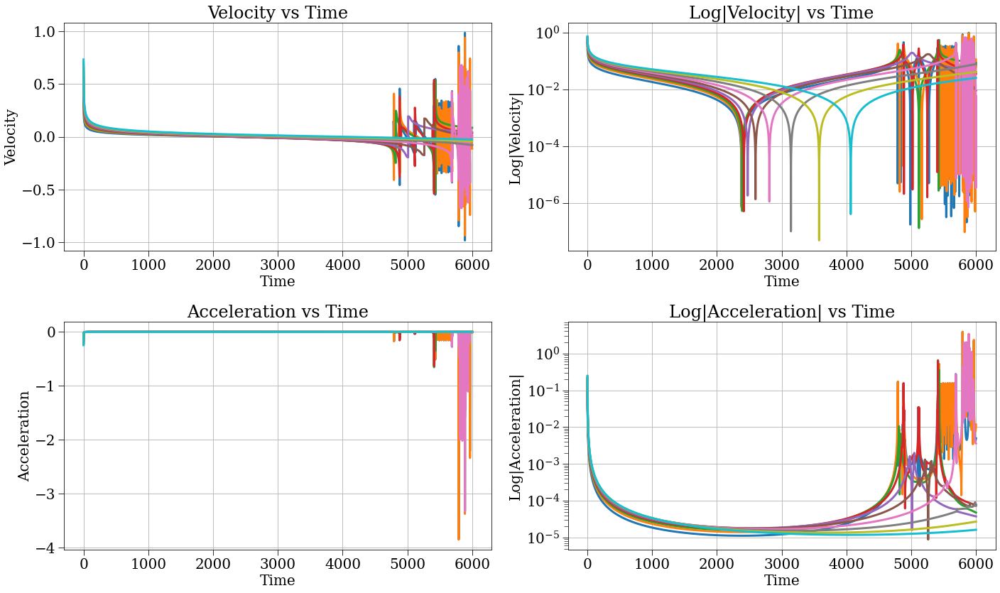

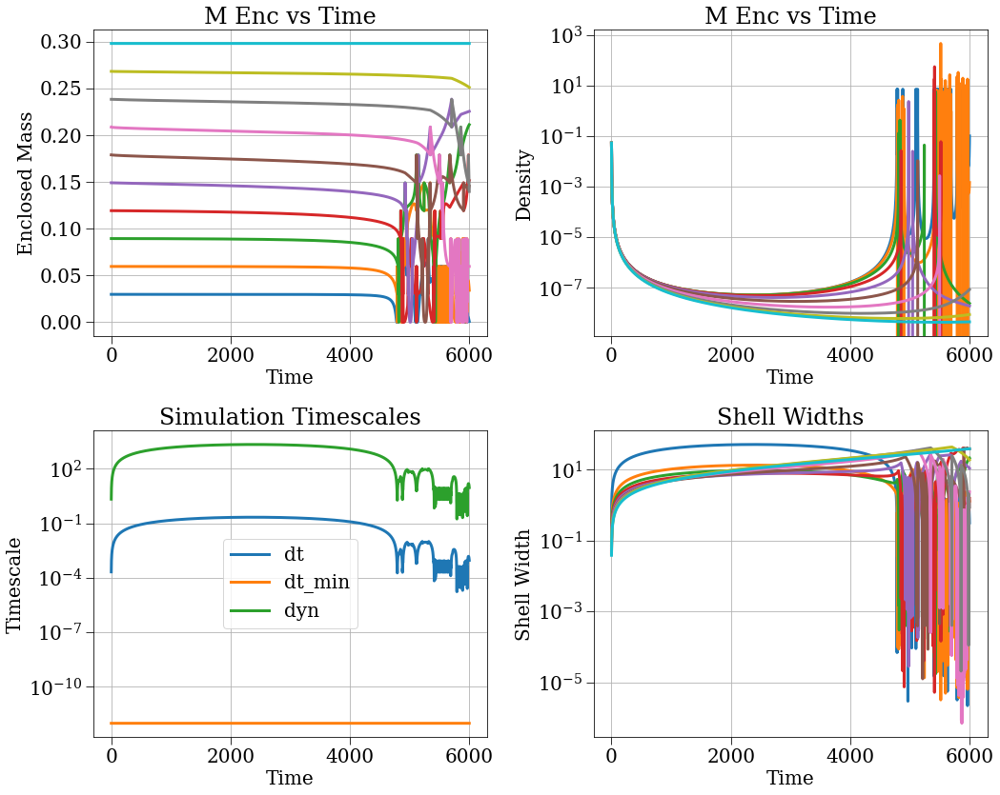

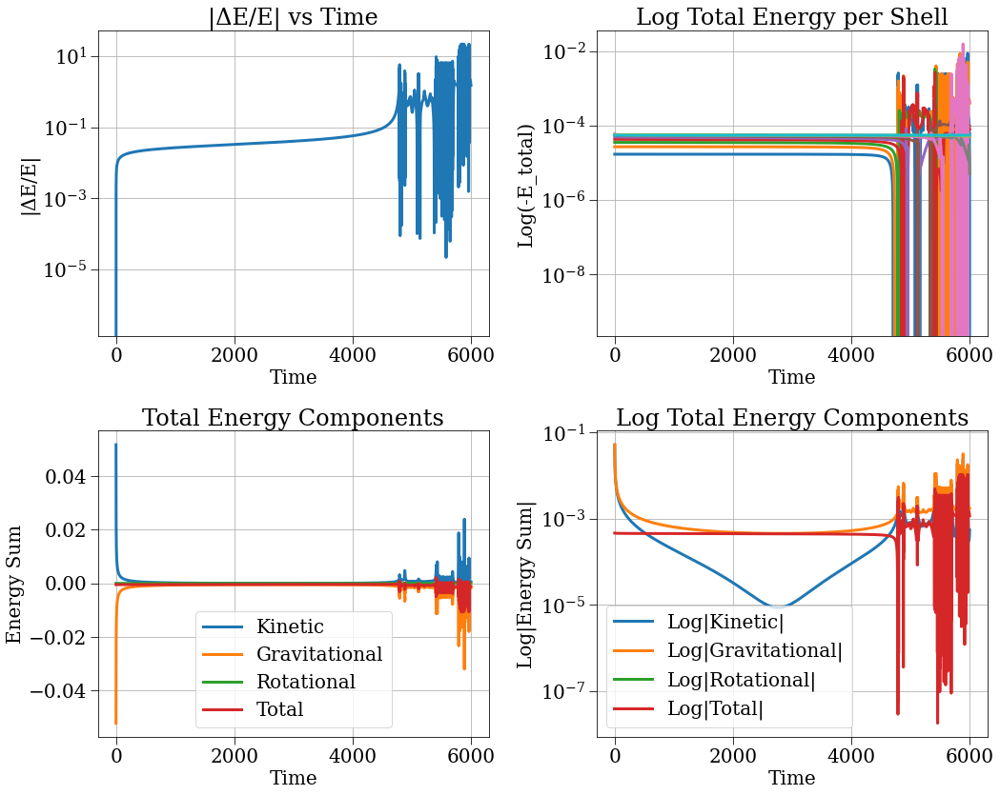

[0.51015558 0.64275576 0.73577167 0.80982151 0.87235378 0.92701422
 0.97589253 1.0205097  1.06174266 1.1       ]


In [4]:
s, r, c = run_and_plot(config10_outside)
print(r['r'][0,:])


In [5]:
s, r, c = run_and_plot(config30_outside)
print(r['r'][0,:])


2025-01-30 09:10:22,056 - collapse - INFO - Simulation setup complete


KeyboardInterrupt: 